## __Dados pluviométricos__

In [1]:
import pandas as pd
import folium
import numpy as np
from datetime import timedelta
import matplotlib.pyplot as plt
import pickle

In [1]:
pb = pd.read_csv('dados/PB.csv', sep=';', decimal=',',parse_dates=[6],infer_datetime_format = True,index_col=False)
pb.head()

,municipio,codEstacao,uf,nomeEstacao,latitude,longitude,datahora,valorMedida
0,ALAGOA GRANDE,250030401A,PB,Centro,-35.631,-7.039,2020-08-01 00:00:00,0.0
1,ALAGOA GRANDE,250030401A,PB,Centro,-35.631,-7.039,2020-08-01 01:00:00,0.0
2,ALAGOA GRANDE,250030401A,PB,Centro,-35.631,-7.039,2020-08-01 02:00:00,0.0
3,ALAGOA GRANDE,250030401A,PB,Centro,-35.631,-7.039,2020-08-01 03:00:00,0.0
4,ALAGOA GRANDE,250030401A,PB,Centro,-35.631,-7.039,2020-08-01 04:00:00,0.0


In [2]:
pb['nomeEstacao'].unique()

array(['Centro', 'BARRA DE SANTANA', 'São Bento', 'Alto da Boa Vista',
       'Jardim Planalto', 'Praia do Jacaré', 'Renascer II', 'CAMALAU',
       'Alto Branco', 'CAMPINA GRANDE', 'Sandra Cavalcante',
       'Jardim Paulistano', 'Cruzeiro', 'Bodocongó', 'Bairro das Cidades',
       'Mutirão', 'CONCEICAO', 'DNOCS', 'ESPERANCA', 'ITAPORANGA',
       'Bairro do Cristo', 'Cuiá', 'Grotão', 'Tambauzinho', 'Manaíra',
       'JUAZEIRINHO', 'JUNCO DO SERIDO', 'MASSARANDUBA', 'Mataraca Baixa',
       'MONTEIRO', 'Liberdade', 'PATOS', 'Belo Horizonte', 'POMBAL',
       'REMIGIO', 'SANTANA DOS GARROTES', 'SANTA TERESINHA', 'SAO MAMEDE',
       'Sapé', 'SOLANEA', 'SOLEDADE', 'Gato Preto', 'Fazenda Cesário',
       'UMBUZEIRO'], dtype=object)

In [3]:
pb['municipio'].unique()

array(['ALAGOA GRANDE', 'ALAGOINHA', 'BARRA DE SANTANA', 'BAYEUX',
       'CAAPORÃ', 'CABEDELO', 'CAMALAÚ', 'CAMPINA GRANDE', 'CONCEIÇÃO',
       'COREMAS', 'ESPERANÇA', 'ITAPORANGA', 'JOÃO PESSOA', 'JUAZEIRINHO',
       'JUNCO DO SERIDÓ', 'MARI', 'MASSARANDUBA', 'MATARACA', 'MONTEIRO',
       'MULUNGU', 'PATOS', 'POMBAL', 'REMÍGIO', 'SANTANA DOS GARROTES',
       'SANTA TERESINHA', 'SÃO BENTO', 'SÃO MAMEDE', 'SAPÉ', 'SOLÂNEA',
       'SOLEDADE', 'SOUSA', 'UMBUZEIRO'], dtype=object)

In [4]:
pb1 = pb[(pb['municipio']=='JOÃO PESSOA') | (pb['municipio']=='CAMPINA GRANDE')]

In [5]:
pb1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 7989 entries, 6430 to 16185
Data columns (total 8 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   municipio    7989 non-null   object        
 1   codEstacao   7989 non-null   object        
 2   uf           7989 non-null   object        
 3   nomeEstacao  7989 non-null   object        
 4   latitude     7989 non-null   float64       
 5   longitude    7989 non-null   float64       
 6   datahora     7989 non-null   datetime64[ns]
 7   valorMedida  7989 non-null   float64       
dtypes: datetime64[ns](1), float64(3), object(4)
memory usage: 561.7+ KB


In [6]:
pb1[pb1['municipio'] =='JOÃO PESSOA']['nomeEstacao'].unique()

array(['Bairro do Cristo', 'Cuiá', 'Grotão', 'Tambauzinho', 'Manaíra',
       'Centro'], dtype=object)

In [7]:
pb1[pb1['municipio'] =='CAMPINA GRANDE']['nomeEstacao'].unique()

array(['Alto Branco', 'CAMPINA GRANDE', 'Sandra Cavalcante',
       'Jardim Paulistano', 'Cruzeiro', 'Bodocongó', 'Bairro das Cidades',
       'Mutirão'], dtype=object)

In [8]:
pb1.set_index('datahora', inplace=True)

In [9]:
jp = pb1[pb1['municipio'] =='JOÃO PESSOA']

In [10]:
cg = pb1[pb1['municipio'] =='CAMPINA GRANDE']

/home/lucas/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/converter.py:256: MatplotlibDeprecationWarning: 
The epoch2num function was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
  base = dates.epoch2num(dt.asi8 / 1.0e9)
/home/lucas/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/converter.py:256: MatplotlibDeprecationWarning: 
The epoch2num function was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
  base = dates.epoch2num(dt.asi8 / 1.0e9)
/home/lucas/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/converter.py:256: MatplotlibDeprecationWarning: 
The epoch2num function was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
  base = dates.epoch2num(dt.asi8 / 1.0e9)
/home/lucas/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/converter.py:256: MatplotlibDeprecationWarning: 
The epoch2num function was deprecated in Matplotlib 3.3 and 

nomeEstacao
Bairro do Cristo    AxesSubplot(0.125,0.2;0.775x0.68)
Centro              AxesSubplot(0.125,0.2;0.775x0.68)
Cuiá                AxesSubplot(0.125,0.2;0.775x0.68)
Grotão              AxesSubplot(0.125,0.2;0.775x0.68)
Manaíra             AxesSubplot(0.125,0.2;0.775x0.68)
Tambauzinho         AxesSubplot(0.125,0.2;0.775x0.68)
Name: valorMedida, dtype: object

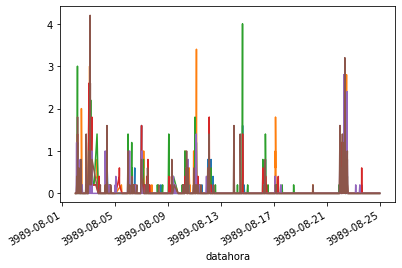

In [11]:
jp.groupby('nomeEstacao')['valorMedida'].plot()

/home/lucas/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/converter.py:256: MatplotlibDeprecationWarning: 
The epoch2num function was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
  base = dates.epoch2num(dt.asi8 / 1.0e9)


<AxesSubplot:xlabel='datahora'>

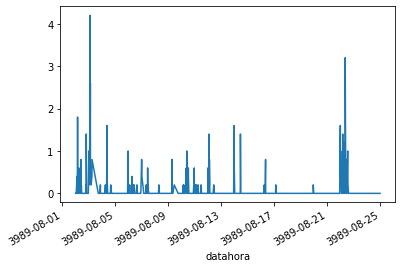

In [12]:
jp[jp['nomeEstacao']=='Tambauzinho']['valorMedida'].plot()

/home/lucas/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/converter.py:256: MatplotlibDeprecationWarning: 
The epoch2num function was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
  base = dates.epoch2num(dt.asi8 / 1.0e9)


<AxesSubplot:xlabel='datahora'>

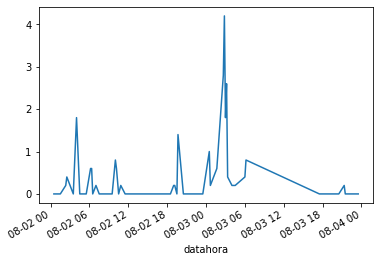

In [13]:
jp[jp['nomeEstacao']=='Tambauzinho']['valorMedida']['2020-08-01':'2020-08-02'].plot()

In [14]:
jp.index.max()

Timestamp('2020-08-23 23:50:00')

In [15]:
jp[jp['nomeEstacao']=='Tambauzinho'].loc['2020-08-01', 'valorMedida']

datahora
2020-08-01 00:30:00    0.0
2020-08-01 01:30:00    0.0
2020-08-01 02:20:00    0.2
2020-08-01 02:30:00    0.4
2020-08-01 03:30:00    0.0
2020-08-01 04:00:00    1.8
2020-08-01 04:30:00    0.0
2020-08-01 05:30:00    0.0
2020-08-01 06:10:00    0.6
2020-08-01 06:20:00    0.6
2020-08-01 06:30:00    0.0
2020-08-01 07:00:00    0.2
2020-08-01 07:30:00    0.0
2020-08-01 08:30:00    0.0
2020-08-01 09:30:00    0.0
2020-08-01 10:00:00    0.8
2020-08-01 10:10:00    0.6
2020-08-01 10:30:00    0.0
2020-08-01 10:50:00    0.2
2020-08-01 11:30:00    0.0
2020-08-01 12:30:00    0.0
2020-08-01 13:30:00    0.0
2020-08-01 14:30:00    0.0
2020-08-01 15:30:00    0.0
2020-08-01 16:30:00    0.0
2020-08-01 17:30:00    0.0
2020-08-01 18:30:00    0.0
2020-08-01 19:00:00    0.2
2020-08-01 19:10:00    0.2
2020-08-01 19:30:00    0.0
2020-08-01 19:40:00    1.4
2020-08-01 20:30:00    0.0
2020-08-01 21:30:00    0.0
2020-08-01 22:30:00    0.0
2020-08-01 23:30:00    0.0
Name: valorMedida, dtype: float64

/home/lucas/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/converter.py:256: MatplotlibDeprecationWarning: 
The epoch2num function was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
  base = dates.epoch2num(dt.asi8 / 1.0e9)


<AxesSubplot:xlabel='datahora'>

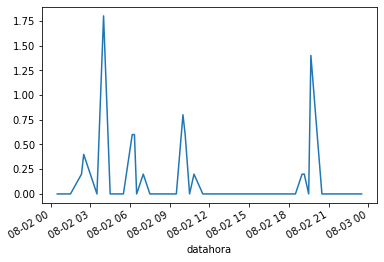

In [16]:
jp[jp['nomeEstacao']=='Tambauzinho'].loc['2020-08-01', 'valorMedida'].plot()

### __João Pessoa__ 

In [17]:
lat = jp.groupby('nomeEstacao')['latitude'].unique().astype(float)
lon = jp.groupby('nomeEstacao')['longitude'].unique().astype(float)

In [18]:
lat

nomeEstacao
Bairro do Cristo   -34.882
Centro             -34.886
Cuiá               -34.859
Grotão             -34.880
Manaíra            -34.837
Tambauzinho        -34.847
Name: latitude, dtype: float64

In [19]:
lon

nomeEstacao
Bairro do Cristo   -7.166
Centro             -7.119
Cuiá               -7.184
Grotão             -7.185
Manaíra            -7.109
Tambauzinho        -7.124
Name: longitude, dtype: float64

In [20]:
coordenadasJP = pd.DataFrame([lat, lon]).T

In [21]:
coordenadasJP

,latitude,longitude
nomeEstacao,,
Bairro do Cristo,-34.882,-7.166
Centro,-34.886,-7.119
Cuiá,-34.859,-7.184
Grotão,-34.880,-7.185
Manaíra,-34.837,-7.109
Tambauzinho,-34.847,-7.124


In [22]:
import folium

Paraiba = 'PB.json'
latitudeJP = -7.11532
longitudeJP = -34.861
raio = 18


centro = [latitudeJP,longitudeJP]
mapa = folium.Map(
    location = centro,
    zoom_start=11
)

folium.GeoJson(
    Paraiba,
    name='geojson'
).add_to(mapa)


folium.Circle(
    radius=raio*1000,
    location=centro,
    popup='Centro',
    color='crimson',
    fill=False,
).add_to(mapa)

for index, row in coordenadasJP.iterrows():
    folium.Marker(
        location=[row['longitude'], row['latitude']],
        popup=index,
    ).add_to(mapa)


mapa

#### __Dados útima semana__

In [20]:
#import requests_oauthlib
#from twython import Twython
import tweepy
import config

In [21]:
#Autenticação

auth = tweepy.OAuthHandler(consumer_key = config.Api_key, consumer_secret =config.Api_secret_key)
auth.set_access_token(config.Access_Tokken, config.Access_Token_Secret)

In [22]:
#auth.access_token = config.Access_Tokken
#auth.access_token_secret = config.Access_Token_Secret

In [23]:
api = tweepy.API(auth)

In [24]:
try:
    redirect_url = auth.get_authorization_url()
except tweepy.TweepError:
    print('Error! Failed to get request token.')

In [25]:
#Tweets da timeline

public_tweets = api.home_timeline()
for tweet in public_tweets:
    print(tweet.text)


The root of every spiritual error is believing ourselves to be righteous. To consider ourselves righteous is to lea… https://t.co/WNKmjqUe9F
Today is the tenth anniversary of the massacre of 72 migrants in Mexico. I express my solidarity with the families… https://t.co/eL6X4BYGin
To pray is to allow yourself to be looked at by God without illusions, excuses, or justifications. Because from the… https://t.co/aFDbiNKJgM
Let’s not forget the victims of the coronavirus. So much suffering, so many people who lost their lives; and so man… https://t.co/ItdagVRmxl
In the #GospelOfTheDay, we hear Jesus’s question directed to each one of us: “And you, who do you say I am?”. It is… https://t.co/EsHlBn7oRp
Get an extra slice of Paul's album #FlamingPie with this beautiful deluxe edition. The (5CD/2DVD) Deluxe Edition Bo… https://t.co/looZD6lAAi
God does not love you because you behave well. He loves you, plain and simple. His love is unconditional; it does not depend on you.
God has no need to be 

In [139]:
geocodeStr = '{},{},{}km'.format(latitudeJP, longitudeJP, raio)
geocodeStr

'-7.11532,-34.861,18km'

In [149]:
chuvas = api.search(q = 'chuva OR enchente OR chuvendo OR chove OR chuvas',
                    geocode = geocodeStr, 
                    count = 101,
                    tweet_mode = 'extended',
                    until = '2020-08-23')

In [150]:
len(chuvas)

100

In [151]:
[print(tweet.full_text) for tweet in chuvas]

@qbrunito Se você perceber os jurados todos estão cantando músicas em Português e no primeiro dia o Jarbas tbm cantou o cantando na chuva na versão brasileira, então está muito mais para um reflexo sobre como é o público jovem de musicais, que acha que apenas em inglês is good
Tudo que eu queria agora era uma chuva beeeeeeeemmmmm forte pelo resto da noite.
@JapaArtes @CorreiosBR @jairbolsonaro Essa merda já era pra estar privatizada, serviço porco e caro, Sedex chega a custar mais caro a outros serviços e demora mais. Estraviam produtos, danificam, aqui em casa já jogaram a encomenda por cima do portão, certa vez pegou chuva molhou tudo. Privatiza tudo...
E  ̶p̶a̶r̶e̶c̶e̶ ̶q̶u̶e̶ ̶ quanto mais você mostra evidências e fatos claros, mais eles ciscam e esperneiam, tentando invalidar isso com a "chuva de dislikes" - que mostra o quão ridículo e raso é o pensamento dessa gente
+
@xicosa @fabi2moraes Foi chuva, mas essa chuva não aconteceria se não fosse para salvar o Nordeste, há uma ideia

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

In [153]:
[print(tweet.created_at) for tweet in chuvas]

2020-08-22 23:57:12
2020-08-22 23:13:07
2020-08-22 23:01:39
2020-08-22 19:53:34
2020-08-22 19:26:59
2020-08-22 18:49:44
2020-08-22 18:47:25
2020-08-22 18:42:15
2020-08-22 17:10:24
2020-08-22 17:04:13
2020-08-22 17:00:52
2020-08-22 16:52:26
2020-08-22 15:10:29
2020-08-22 14:44:05
2020-08-22 12:31:53
2020-08-22 11:49:13
2020-08-22 11:38:09
2020-08-22 11:18:40
2020-08-22 10:54:13
2020-08-22 07:35:39
2020-08-22 07:23:27
2020-08-22 05:35:32
2020-08-22 04:18:18
2020-08-22 02:12:07
2020-08-22 01:45:54
2020-08-22 01:37:31
2020-08-22 01:08:27
2020-08-22 01:05:40
2020-08-22 00:56:19
2020-08-22 00:10:52
2020-08-21 23:33:33
2020-08-21 23:21:56
2020-08-21 22:59:48
2020-08-21 22:44:15
2020-08-21 22:43:58
2020-08-21 22:40:36
2020-08-21 22:37:26
2020-08-21 21:55:39
2020-08-21 21:18:44
2020-08-21 21:00:50
2020-08-21 19:26:15
2020-08-21 19:18:01
2020-08-21 16:36:00
2020-08-21 16:07:39
2020-08-21 15:59:30
2020-08-21 15:37:33
2020-08-21 15:09:45
2020-08-21 14:48:43
2020-08-21 14:05:06
2020-08-21 13:57:42


[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

In [182]:
jp.groupby('nomeEstacao').resample('D').max()['valorMedida']

nomeEstacao       datahora  
Bairro do Cristo  2020-08-01    1.2
                  2020-08-02    2.0
                  2020-08-03    0.6
                  2020-08-04    1.2
                  2020-08-05    0.6
                               ... 
Tambauzinho       2020-08-19    0.0
                  2020-08-20    1.6
                  2020-08-21    3.2
                  2020-08-22    0.0
                  2020-08-23    0.0
Name: valorMedida, Length: 138, dtype: float64

In [208]:
jp['nomeEstacao'].unique()

array(['Bairro do Cristo', 'Cuiá', 'Grotão', 'Tambauzinho', 'Manaíra',
       'Centro'], dtype=object)

In [209]:
import matplotlib.pyplot as plt
from datetime import timedelta

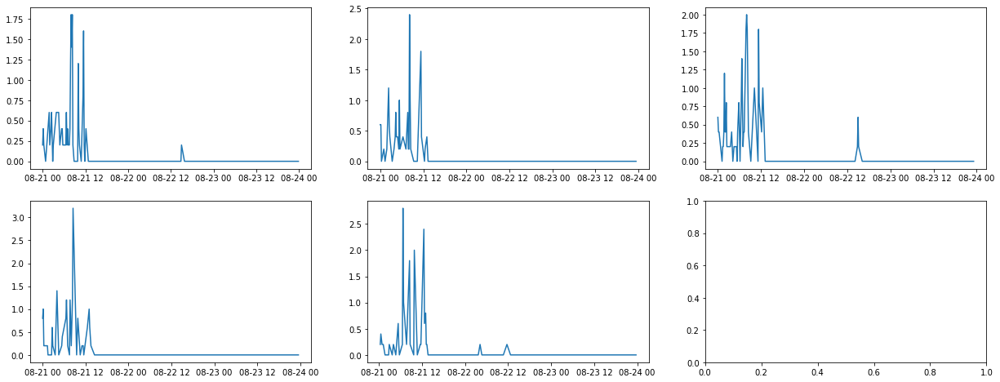

In [57]:
fig, ax = plt.subplots(2,3, figsize=(21,8))

estacoes = jp['nomeEstacao'].unique()

x=[]
y=[]
for estacao in estacoes:
    y.append(jp[jp['nomeEstacao']==estacao]['2020-08-21':'2020-08-23']['valorMedida'])
    x.append(jp[jp['nomeEstacao']==estacao]['2020-08-21':'2020-08-23'].index)
    

ax[0][0].plot(x[0],y[0])
ax[0][1].plot(x[1],y[1])
ax[0][2].plot(x[2],y[2])
ax[1][0].plot(x[3],y[3])
ax[1][1].plot(x[4],y[4])


In [337]:
tweet = chuvas[99]
print(tweet.full_text)
print('\n----------------------\n')


print(tweet.created_at - timedelta(hours=3))

@amana_chuva mas às vezes isso é culpa do torrent kkk

----------------------

2020-08-20 22:22:19


In [338]:
jp_tweets = [0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
             0, 0, 0, 0, 0, 0, 0, 1, 0, 0,
             1, 0, 0, 1, 0, 0, 0, 0, 1, 0,
             1, 1, 1, 1, 1, 0, 1, 0, 0, 0,
             1, 1, 1, 1, 0, 0, 1, 0, 1, 1,
             1, 1, 1, 1, 0, 1, 1, 1, 0, 1,
             1, 1, 1, 1, 1, 1, 1, 1, 0, 1,
             1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
             1, 1, 1, 1, 1, 1, 1, 0, 1, 1,
             0, 0, 1, 1, 1, 1, 1, 0, 1, 1]

In [345]:
dic_jp = {'horario':[tweet.created_at - timedelta(hours=3) for tweet in chuvas],
       'local':[tweet.user.location for tweet in chuvas],
       'texto': [tweet.full_text for tweet in chuvas],
       'relevancia':jp_tweets} 

In [346]:
jp_df = pd.DataFrame(dic)

In [347]:
jp_df

,horario,local,texto,relevancia
0,2020-08-22 20:57:12,"João Pessoa, Brasil",@qbrunito Se você perceber os jurados todos es...,0
1,2020-08-22 20:13:07,"João Pessoa, Brasil",Tudo que eu queria agora era uma chuva beeeeee...,0
2,2020-08-22 20:01:39,João Pessoa - PB,@JapaArtes @CorreiosBR @jairbolsonaro Essa mer...,0
3,2020-08-22 16:53:34,"João Pessoa, Brazil",E ̶p̶a̶r̶e̶c̶e̶ ̶q̶u̶e̶ ̶ quanto mais você mo...,0
4,2020-08-22 16:26:59,"João Pessoa, Brasil","@xicosa @fabi2moraes Foi chuva, mas essa chuva...",0
...,...,...,...,...
95,2020-08-20 22:52:09,"João Pessoa, Brasil",Eu amo dormir com esse barulho de chuva,1
96,2020-08-20 22:48:45,João Pessoa - PB,E essa chuva... do nada? 🙄🙄🙄,1
97,2020-08-20 22:36:04,"João Pessoa, Brasil",Se jogarem água em cima de casa a internet diz...,0
98,2020-08-20 22:32:12,"João Pessoa, Brasil","chuva do carai, tomei no rabo",1


In [348]:
import pickle


pickle.dump(chuvas, open('chuvas_jp_2123-08.p', 'wb'))

In [350]:
jp_df.to_csv("chuvas_jp_2123-08.csv")

#### Campina Grande

In [29]:
lat = cg.groupby('nomeEstacao')['latitude'].unique().astype(float)
lon = cg.groupby('nomeEstacao')['longitude'].unique().astype(float)

In [30]:
lat

nomeEstacao
Alto Branco          -35.886000
Bairro das Cidades   -35.932000
Bodocongó            -35.924000
CAMPINA GRANDE       -36.098937
Cruzeiro             -35.917000
Jardim Paulistano    -35.895000
Mutirão              -35.947000
Sandra Cavalcante    -35.874000
Name: latitude, dtype: float64

In [31]:
lon

nomeEstacao
Alto Branco          -7.207000
Bairro das Cidades   -7.274000
Bodocongó            -7.215000
CAMPINA GRANDE       -7.273366
Cruzeiro             -7.249000
Jardim Paulistano    -7.252000
Mutirão              -7.229000
Sandra Cavalcante    -7.244000
Name: longitude, dtype: float64

In [32]:
coordenadasCG = pd.DataFrame([lat, lon]).T

In [33]:
coordenadasCG

,latitude,longitude
nomeEstacao,,
Alto Branco,-35.886000,-7.207000
Bairro das Cidades,-35.932000,-7.274000
Bodocongó,-35.924000,-7.215000
CAMPINA GRANDE,-36.098937,-7.273366
Cruzeiro,-35.917000,-7.249000
Jardim Paulistano,-35.895000,-7.252000
Mutirão,-35.947000,-7.229000
Sandra Cavalcante,-35.874000,-7.244000


In [34]:
Paraiba = 'PB.json'
latitudeCG = -7.23072
longitudeCG = -35.8817
raio = 18


centro = [latitudeCG,longitudeCG]
mapa = folium.Map(
    location = centro,
    zoom_start=11
)

folium.GeoJson(
    Paraiba,
    name='geojson'
).add_to(mapa)


folium.Circle(
    radius=raio*1000,
    location=centro,
    popup='Centro',
    color='crimson',
    fill=False,
).add_to(mapa)

for index, row in coordenadasCG.iterrows():
    folium.Marker(
        location=[row['longitude'], row['latitude']],
        popup=index,
    ).add_to(mapa)


mapa

In [37]:
geocodeStr = '{},{},{}km'.format(latitudeCG, longitudeCG, raio)
geocodeStr

'-7.23072,-35.8817,18km'

In [50]:
chuvas = api.search(q = 'chuva OR enchente OR chuvendo OR chove OR chuvas',
                    geocode = geocodeStr, 
                    count = 101,
                    tweet_mode = 'extended',
                    until = '2020-08-23')

In [51]:
len(chuvas)

33

In [52]:
[print(tweet.full_text) for tweet in chuvas]

santa chuva é foda, triste dms
@carlalarrat @loranmoreira_ eu quero chuva, comprei um casaco e quero usar🤡🤡🤡🤡🤡🤡
@YagoCostat rapaz a brisa não pode ver chuva kkk
E essa chuva ein??? 💢🖤

#SuperLiveVascoTV
"Vou por a "FOTO de minha CIDADE" aqui pra vcs a conhecerem. É a TERRA do "MAIOR SÃO JOÃO DO MUNDO". Este ano não teve "A FESTANÇA", nem FOGUEIRA ACENDERAM. Faz duas SEMANAS que "CHOVE FINO" e o CALOR é insuportável." GOSTO de FRIO!!!
COISA que aqui não tem.
Um ABRAÇO pra vcs. https://t.co/QHzNGIqLLK
Tomei muita chuva... quem disser que eu n amo oq faço ta mentindo mt
Chuva para por favor pra eu dar uns grauzinho🥺🥺🥺🥺🙏🏻
#flor #branca #gotas #chuva #flower #white #waterdrop #rain #galaxys9plus #flora #nature #natureza em Campina Grande https://t.co/8I8cpS5HLD
Eu sei onde o coelho anda,
Como também sei até onde vai a sua toca.

Pois quando a "chuva brilhante" vier
As montanhas será uma morada,
E apenas o seu coração o salvará
@SorayaThronicke Qual a sua dificuldade de entender que funcioná

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

In [53]:
[print(tweet.created_at) for tweet in chuvas]

2020-08-22 14:03:59
2020-08-22 05:54:42
2020-08-22 01:23:54
2020-08-22 00:28:11
2020-08-22 00:22:21
2020-08-21 23:26:02
2020-08-21 21:04:20
2020-08-21 20:25:42
2020-08-21 18:18:38
2020-08-21 16:34:42
2020-08-21 14:21:10
2020-08-21 13:52:52
2020-08-21 13:11:15
2020-08-21 12:24:33
2020-08-21 11:12:38
2020-08-21 06:01:44
2020-08-21 03:45:01
2020-08-21 03:01:12
2020-08-20 21:58:23
2020-08-20 19:00:16
2020-08-20 11:01:18
2020-08-20 00:39:30
2020-08-19 08:36:29
2020-08-19 02:43:56
2020-08-19 02:20:37
2020-08-19 00:37:02
2020-08-18 11:59:19
2020-08-18 03:49:31
2020-08-17 23:13:20
2020-08-17 12:18:38
2020-08-17 12:18:07
2020-08-17 08:44:59
2020-08-17 08:31:27


[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

In [67]:
cg['2020-08-17':'2020-08-23'].groupby('nomeEstacao').resample('D').max()['valorMedida']

nomeEstacao         datahora  
Alto Branco         2020-08-17    0.0
                    2020-08-18    0.0
                    2020-08-19    0.0
                    2020-08-20    0.0
                    2020-08-21    0.2
                    2020-08-22    0.0
                    2020-08-23    0.0
Bairro das Cidades  2020-08-17    0.0
                    2020-08-18    0.0
                    2020-08-19    0.0
                    2020-08-20    0.0
                    2020-08-21    0.2
                    2020-08-22    0.0
                    2020-08-23    0.0
Bodocongó           2020-08-17    0.0
                    2020-08-18    0.0
                    2020-08-19    0.0
                    2020-08-20    0.0
                    2020-08-21    0.0
                    2020-08-22    0.0
                    2020-08-23    0.0
CAMPINA GRANDE      2020-08-17    0.2
                    2020-08-18    0.0
                    2020-08-19    0.0
                    2020-08-20    0.0
                   

In [43]:
import numpy as np

In [63]:
estacoes = cg['nomeEstacao'].unique()
d = np.where(estacoes=='CAMPINA GRANDE')
d

(array([1]),)

In [64]:
estacoes = np.delete(estacoes, d)
estacoes

array(['Alto Branco', 'Sandra Cavalcante', 'Jardim Paulistano',
       'Cruzeiro', 'Bodocongó', 'Bairro das Cidades', 'Mutirão'],
      dtype=object)

In [65]:
len(estacoes)

7

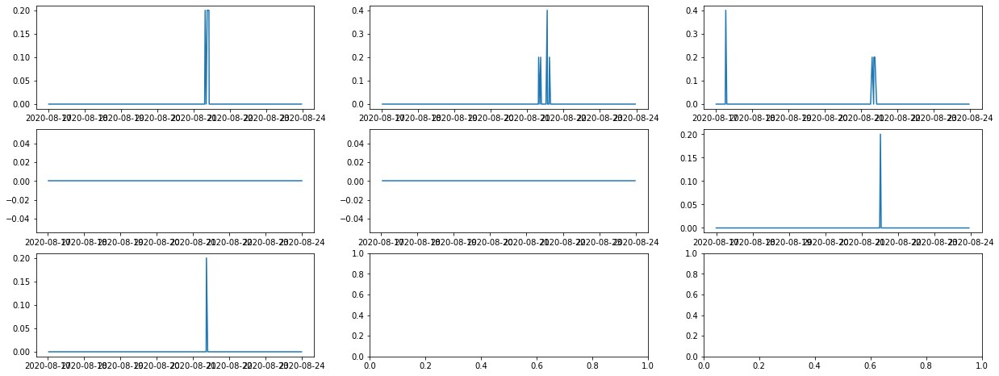

In [66]:
fig, ax = plt.subplots(3,3, figsize=(21,8))



x=[]
y=[]

for estacao in estacoes:
    y.append(cg[cg['nomeEstacao']==estacao]['2020-08-17':'2020-08-23']['valorMedida'])
    x.append(cg[cg['nomeEstacao']==estacao]['2020-08-17':'2020-08-23'].index)
    

ax[0][0].plot(x[0],y[0])
ax[0][1].plot(x[1],y[1])
ax[0][2].plot(x[2],y[2])
ax[1][0].plot(x[3],y[3])
ax[1][1].plot(x[4],y[4])
ax[1][2].plot(x[5],y[5])
ax[2][0].plot(x[6],y[6])

In [105]:
tweet = chuvas[32]
print(tweet.full_text)
print('\n----------------------\n')


print(tweet.created_at - timedelta(hours=3))

Odeio chuva, me deixa tão aflita😓

----------------------

2020-08-17 05:31:27


In [104]:
cg_tweets = [0, 0, 0, 1, 0, 1, 1, 0, 0, 0,
             0, 0, 1, 1, 1, 0, 1, 0, 1, 1,
             0, 0, 0, 0, 0, 0, 0, 0, 1, 1,
             0, 0, 0]

In [107]:
dic_cg = {'horario':[tweet.created_at - timedelta(hours=3) for tweet in chuvas],
       'local':[tweet.user.location for tweet in chuvas],
       'texto': [tweet.full_text for tweet in chuvas],
       'relevancia':cg_tweets} 

In [108]:
cg_df = pd.DataFrame(dic_cg)

In [109]:
cg_df

,horario,local,texto,relevancia
0,2020-08-22 11:03:59,Campina Grande- Paraíba,"santa chuva é foda, triste dms",0
1,2020-08-22 02:54:42,"Campina Grande, Brasil","@carlalarrat @loranmoreira_ eu quero chuva, co...",0
2,2020-08-21 22:23:54,Campina Grande,@YagoCostat rapaz a brisa não pode ver chuva kkk,0
3,2020-08-21 21:28:11,"Campina Grande, Brasil",E essa chuva ein??? 💢🖤\n\n#SuperLiveVascoTV,1
4,2020-08-21 21:22:21,Campina Grande-Paraíba,"""Vou por a ""FOTO de minha CIDADE"" aqui pra vcs...",0
5,2020-08-21 20:26:02,cpv,Tomei muita chuva... quem disser que eu n amo ...,1
6,2020-08-21 18:04:20,cpv,Chuva para por favor pra eu dar uns grauzinho🥺...,1
7,2020-08-21 17:25:42,Brazil,#flor #branca #gotas #chuva #flower #white #wa...,0
8,2020-08-21 15:18:38,Antártida,"Eu sei onde o coelho anda,\nComo também sei at...",0
9,2020-08-21 13:34:42,"Campina Grande-PB, Brasil",@SorayaThronicke Qual a sua dificuldade de ent...,0


In [112]:
pickle.dump(chuvas, open('chuvas_cg_1723-08.p', 'wb'))

In [113]:
cg_df.to_csv("chuvas_cg_1723-08.csv")

#### __Pernambuco__

In [114]:
pe = pd.read_csv('dados/PE.csv', sep=';', decimal=',',parse_dates=[6],infer_datetime_format = True,index_col=False)

In [115]:
pe.head()

,municipio,codEstacao,uf,nomeEstacao,latitude,longitude,datahora,valorMedida
0,RECIFE,261160601A,PE,Varzea,-34.98,-8.036,2020-08-01 00:10:00,0.0
1,RECIFE,261160601A,PE,Varzea,-34.98,-8.036,2020-08-01 01:10:00,0.0
2,RECIFE,261160601A,PE,Varzea,-34.98,-8.036,2020-08-01 02:10:00,0.0
3,RECIFE,261160601A,PE,Varzea,-34.98,-8.036,2020-08-01 03:10:00,0.0
4,RECIFE,261160601A,PE,Varzea,-34.98,-8.036,2020-08-01 04:10:00,0.0


In [116]:
pe.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15536 entries, 0 to 15535
Data columns (total 8 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   municipio    15536 non-null  object        
 1   codEstacao   15536 non-null  object        
 2   uf           15536 non-null  object        
 3   nomeEstacao  15536 non-null  object        
 4   latitude     15536 non-null  float64       
 5   longitude    15536 non-null  float64       
 6   datahora     15536 non-null  datetime64[ns]
 7   valorMedida  15536 non-null  float64       
dtypes: datetime64[ns](1), float64(3), object(4)
memory usage: 971.1+ KB


In [117]:
pe.set_index('datahora', inplace=True)
pe.head()

,municipio,codEstacao,uf,nomeEstacao,latitude,longitude,valorMedida
datahora,,,,,,,
2020-08-01 00:10:00,RECIFE,261160601A,PE,Varzea,-34.98,-8.036,0.0
2020-08-01 01:10:00,RECIFE,261160601A,PE,Varzea,-34.98,-8.036,0.0
2020-08-01 02:10:00,RECIFE,261160601A,PE,Varzea,-34.98,-8.036,0.0
2020-08-01 03:10:00,RECIFE,261160601A,PE,Varzea,-34.98,-8.036,0.0
2020-08-01 04:10:00,RECIFE,261160601A,PE,Varzea,-34.98,-8.036,0.0


In [138]:
pe.groupby('nomeEstacao')['latitude'].unique()

nomeEstacao
Alto Bela Vista                                 [-34.941528000000005]
Alto Mandu                                                  [-34.927]
Alto do Céu                                     [-34.891999999999996]
Areias                                                      [-34.929]
Barreira                                                 [-34.964622]
Boa Vista                                                   [-34.891]
Brega e Chique                                           [-34.979298]
Campina do Barreto                                          [-34.881]
Corrego Jenipapo                                            [-34.936]
Dois Irmãos                                              [-34.947058]
Dois Unidos                                              [-34.909167]
Ibura                                                       [-34.955]
Imbiribeira                                              [-34.913983]
Lagoa Encantada - COHAB                                  [-34.950142]
Morro da

In [133]:
 pe.groupby('nomeEstacao')['longitude'].unique()

nomeEstacao
Alto Bela Vista                       [-8.123583]
Alto Mandu                               [-8.024]
Alto do Céu                              [-8.012]
Areias                                   [-8.102]
Barreira                              [-8.024215]
Boa Vista                    [-8.068999999999999]
Brega e Chique                        [-8.038048]
Campina do Barreto                       [-8.013]
Corrego Jenipapo                         [-8.007]
Dois Irmãos                           [-8.018378]
Dois Unidos                           [-7.996278]
Ibura                                    [-8.122]
Imbiribeira                           [-8.120975]
Lagoa Encantada - COHAB                [-8.11784]
Morro da Conceição                       [-8.019]
Nova Descoberta            [-8.001917, -8.000933]
Pina                                     [-8.099]
Porto                                    [-8.054]
RECIFE - APAC                          [-8.04491]
San Martin                            

In [128]:
pe[pe['nomeEstacao']=='Nova Descoberta']['latitude'].value_counts()

-34.933022    631
-34.919278    596
Name: latitude, dtype: int64

In [153]:
pe[pe['nomeEstacao']=='Nova Descoberta']['longitude'].value_counts()

-8.000933    631
-8.001917    596
Name: longitude, dtype: int64

In [130]:
mediaLat = pe[pe['nomeEstacao']=='Nova Descoberta']['latitude'].mean() 
mediaLon = pe[pe['nomeEstacao']=='Nova Descoberta']['longitude'].mean() 

In [135]:
mediaLat

-34.926346022819615

In [165]:
pe2 = pe.reset_index()
pe2.head()

,datahora,municipio,codEstacao,uf,nomeEstacao,latitude,longitude,valorMedida
0,2020-08-01 00:10:00,RECIFE,261160601A,PE,Varzea,-34.98,-8.036,0.0
1,2020-08-01 01:10:00,RECIFE,261160601A,PE,Varzea,-34.98,-8.036,0.0
2,2020-08-01 02:10:00,RECIFE,261160601A,PE,Varzea,-34.98,-8.036,0.0
3,2020-08-01 03:10:00,RECIFE,261160601A,PE,Varzea,-34.98,-8.036,0.0
4,2020-08-01 04:10:00,RECIFE,261160601A,PE,Varzea,-34.98,-8.036,0.0


In [169]:
ind=pe2[pe2['nomeEstacao']=='Nova Descoberta'].index

In [171]:
pe2.loc[ind,'latitude'] = mediaLat
pe2.loc[ind,'longitude'] = mediaLon

In [173]:
pe2.groupby('nomeEstacao')['latitude'].unique()

nomeEstacao
Alto Bela Vista            [-34.941528000000005]
Alto Mandu                             [-34.927]
Alto do Céu                [-34.891999999999996]
Areias                                 [-34.929]
Barreira                            [-34.964622]
Boa Vista                              [-34.891]
Brega e Chique                      [-34.979298]
Campina do Barreto                     [-34.881]
Corrego Jenipapo                       [-34.936]
Dois Irmãos                         [-34.947058]
Dois Unidos                         [-34.909167]
Ibura                                  [-34.955]
Imbiribeira                         [-34.913983]
Lagoa Encantada - COHAB             [-34.950142]
Morro da Conceição                     [-34.915]
Nova Descoberta            [-34.926346022819615]
Pina                                   [-34.887]
Porto                      [-34.873000000000005]
RECIFE - APAC                        [-34.87518]
San Martin                             [-34.925]
Torreão 

In [174]:
pe2.set_index('datahora', inplace=True)

In [175]:
lat = pe2.groupby('nomeEstacao')['latitude'].unique().astype(float)
lon = pe2.groupby('nomeEstacao')['longitude'].unique().astype(float)

In [176]:
lat

nomeEstacao
Alto Bela Vista           -34.941528
Alto Mandu                -34.927000
Alto do Céu               -34.892000
Areias                    -34.929000
Barreira                  -34.964622
Boa Vista                 -34.891000
Brega e Chique            -34.979298
Campina do Barreto        -34.881000
Corrego Jenipapo          -34.936000
Dois Irmãos               -34.947058
Dois Unidos               -34.909167
Ibura                     -34.955000
Imbiribeira               -34.913983
Lagoa Encantada - COHAB   -34.950142
Morro da Conceição        -34.915000
Nova Descoberta           -34.926346
Pina                      -34.887000
Porto                     -34.873000
RECIFE - APAC             -34.875180
San Martin                -34.925000
Torreão                   -34.884000
UR12 - COHAB              -34.952180
UR2 - COHAB               -34.952593
UR3 - Ibura               -34.949029
Varzea                    -34.980000
Name: latitude, dtype: float64

In [177]:
lon

nomeEstacao
Alto Bela Vista           -8.123583
Alto Mandu                -8.024000
Alto do Céu               -8.012000
Areias                    -8.102000
Barreira                  -8.024215
Boa Vista                 -8.069000
Brega e Chique            -8.038048
Campina do Barreto        -8.013000
Corrego Jenipapo          -8.007000
Dois Irmãos               -8.018378
Dois Unidos               -7.996278
Ibura                     -8.122000
Imbiribeira               -8.120975
Lagoa Encantada - COHAB   -8.117840
Morro da Conceição        -8.019000
Nova Descoberta           -8.001411
Pina                      -8.099000
Porto                     -8.054000
RECIFE - APAC             -8.044910
San Martin                -8.073000
Torreão                   -8.037000
UR12 - COHAB              -8.121520
UR2 - COHAB               -8.122034
UR3 - Ibura               -8.114365
Varzea                    -8.036000
Name: longitude, dtype: float64

In [178]:
coordenadasPE= pd.DataFrame([lat, lon]).T

In [179]:
coordenadasPE

,latitude,longitude
nomeEstacao,,
Alto Bela Vista,-34.941528,-8.123583
Alto Mandu,-34.927000,-8.024000
Alto do Céu,-34.892000,-8.012000
Areias,-34.929000,-8.102000
Barreira,-34.964622,-8.024215
Boa Vista,-34.891000,-8.069000
Brega e Chique,-34.979298,-8.038048
Campina do Barreto,-34.881000,-8.013000
Corrego Jenipapo,-34.936000,-8.007000


In [186]:
Pernambuco = 'dados/geojson/PE.json'
latitudePE = -8.05428
longitudePE = -34.8813 
raio = 12


centro = [latitudePE,longitudePE]
mapa = folium.Map(
    location = centro,
    zoom_start=11
)

folium.GeoJson(
    Pernambuco,
    name='geojson'
).add_to(mapa)


folium.Circle(
    radius=raio*1000,
    location=centro,
    popup='Centro',
    color='crimson',
    fill=False,
).add_to(mapa)

for index, row in coordenadasPE.iterrows():
    folium.Marker(
        location=[row['longitude'], row['latitude']],
        popup=index,
    ).add_to(mapa)


mapa

In [190]:
geocodeStr = '{},{},{}km'.format(latitudePE, longitudePE, raio)
geocodeStr

'-8.05428,-34.8813,12km'

In [191]:
chuvas = api.search(q = 'chuva OR enchente OR chuvendo OR chove OR chuvas',
                    geocode = geocodeStr, 
                    count = 101,
                    tweet_mode = 'extended',
                    until = '2020-08-23')

In [192]:
len(chuvas)

100

In [193]:
[print(tweet.full_text) for tweet in chuvas]

RT @LorranPhelipe: Como posso desejar chuva e neve, se tem gente que dorme no relento! https://t.co/PgOQehbvuS
RT @LorranPhelipe: Como posso desejar chuva e neve, se tem gente que dorme no relento! https://t.co/PgOQehbvuS
RT @LorranPhelipe: Como posso desejar chuva e neve, se tem gente que dorme no relento! https://t.co/PgOQehbvuS
@TiagoAraujo___ Eu fui guerreira e fui na chuva msm kkkk
Já silenciei os grupos do trabalho. Já comprei minhas brejas e shopping agora só TERÇA. 

Chuva de likes!!!!!
pelo amor de Deus sem chuva amnh 😫
RT @__aquarianxx: cinco minutos de chuva e o ibura de baixo se acaba na água kkkkk
@ta1carai ne foda kkkkkkkkkkkkk levei chuva umas 4 vezes hj
RT @_lucasgbsilva: Recifense quando chove um pouco
Recifense quando chove um pouco https://t.co/E7M93vBw9P
RT @LorranPhelipe: Como posso desejar chuva e neve, se tem gente que dorme no relento! https://t.co/PgOQehbvuS
RT @LorranPhelipe: Como posso desejar chuva e neve, se tem gente que dorme no relento! https://t.co/PgOQ

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

In [194]:
[print(tweet.created_at) for tweet in chuvas]

2020-08-22 23:59:40
2020-08-22 23:39:07
2020-08-22 23:34:32
2020-08-22 23:28:20
2020-08-22 23:18:40
2020-08-22 22:49:51
2020-08-22 22:47:04
2020-08-22 22:39:09
2020-08-22 22:37:29
2020-08-22 22:36:38
2020-08-22 22:33:09
2020-08-22 22:30:07
2020-08-22 22:21:36
2020-08-22 22:02:59
2020-08-22 22:02:05
2020-08-22 22:01:28
2020-08-22 21:54:27
2020-08-22 21:53:05
2020-08-22 21:52:03
2020-08-22 21:47:35
2020-08-22 21:44:03
2020-08-22 21:38:16
2020-08-22 21:36:44
2020-08-22 21:36:29
2020-08-22 21:29:45
2020-08-22 21:28:16
2020-08-22 21:20:01
2020-08-22 21:18:39
2020-08-22 21:18:02
2020-08-22 21:16:04
2020-08-22 21:15:36
2020-08-22 21:12:12
2020-08-22 21:11:56
2020-08-22 21:08:24
2020-08-22 21:02:07
2020-08-22 20:58:58
2020-08-22 20:49:55
2020-08-22 20:49:47
2020-08-22 20:48:09
2020-08-22 20:47:41
2020-08-22 20:41:49
2020-08-22 20:37:32
2020-08-22 20:31:35
2020-08-22 20:31:31
2020-08-22 20:29:14
2020-08-22 20:27:31
2020-08-22 20:25:04
2020-08-22 20:24:37
2020-08-22 20:24:28
2020-08-22 20:15:41


[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

In [195]:
pe['2020-08-23'].groupby('nomeEstacao').resample('D').max()['valorMedida']

nomeEstacao              datahora  
Alto Bela Vista          2020-08-23    0.0
Alto Mandu               2020-08-23    0.0
Alto do Céu              2020-08-23    0.0
Areias                   2020-08-23    0.0
Barreira                 2020-08-23    0.2
Boa Vista                2020-08-23    0.0
Brega e Chique           2020-08-23    0.0
Campina do Barreto       2020-08-23    0.0
Corrego Jenipapo         2020-08-23    0.2
Dois Irmãos              2020-08-23    0.0
Dois Unidos              2020-08-23    0.2
Ibura                    2020-08-23    0.0
Imbiribeira              2020-08-23    0.0
Lagoa Encantada - COHAB  2020-08-23    0.0
Morro da Conceição       2020-08-23    0.2
Nova Descoberta          2020-08-23    0.0
Pina                     2020-08-23    0.2
Porto                    2020-08-23    0.0
RECIFE - APAC            2020-08-23    0.0
Torreão                  2020-08-23    0.2
UR12 - COHAB             2020-08-23    0.0
UR2 - COHAB              2020-08-23    0.0
UR3 - Ibura       

In [63]:
#estacoes = cg['nomeEstacao'].unique()
#d = np.where(estacoes=='CAMPINA GRANDE')
#d

(array([1]),)

In [64]:
#estacoes = np.delete(estacoes, d)
#estacoes

array(['Alto Branco', 'Sandra Cavalcante', 'Jardim Paulistano',
       'Cruzeiro', 'Bodocongó', 'Bairro das Cidades', 'Mutirão'],
      dtype=object)

In [199]:
estacoes = pe2['nomeEstacao'].unique()
len(estacoes)

25

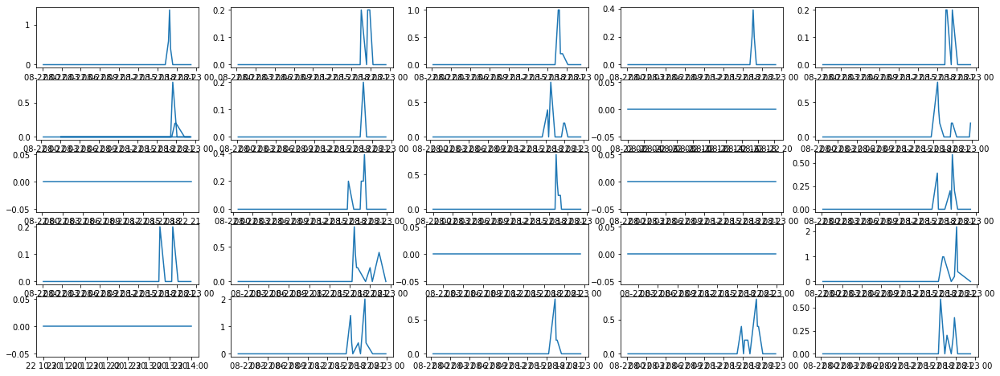

In [201]:
fig, ax = plt.subplots(5,5, figsize=(21,8))



x=[]
y=[]

for estacao in estacoes:
    y.append(pe2[pe2['nomeEstacao']==estacao]['2020-08-22']['valorMedida'])
    x.append(pe2[pe2['nomeEstacao']==estacao]['2020-08-22'].index)
    

ax[0][0].plot(x[0],y[0])
ax[0][1].plot(x[1],y[1])
ax[0][2].plot(x[2],y[2])
ax[0][3].plot(x[3],y[3])
ax[0][4].plot(x[4],y[4])
ax[1][0].plot(x[5],y[5])
ax[1][1].plot(x[6],y[6])
ax[1][2].plot(x[7],y[7])
ax[1][3].plot(x[8],y[8])
ax[1][4].plot(x[9],y[9])
ax[2][0].plot(x[10],y[10])
ax[2][1].plot(x[11],y[11])
ax[2][2].plot(x[12],y[12])
ax[2][3].plot(x[13],y[13])
ax[2][4].plot(x[14],y[14])
ax[3][0].plot(x[15],y[15])
ax[3][1].plot(x[16],y[16])
ax[3][2].plot(x[17],y[17])
ax[3][3].plot(x[18],y[18])
ax[3][4].plot(x[19],y[19])
ax[4][0].plot(x[20],y[20])
ax[4][1].plot(x[21],y[21])
ax[4][2].plot(x[22],y[22])
ax[4][3].plot(x[23],y[23])
ax[4][4].plot(x[24],y[24])

In [311]:
tweet = chuvas[99]
print(tweet.full_text)
print('\n----------------------\n')


print(tweet.created_at - timedelta(hours=3))

@amandagomes212 KKKKKKKKKK É bom demais po e é bem real você pega serviços, tem que tirar habilitação, abastecer o caminhão, fazer manutenção, anoitece, chove, se o caminhão quebrar você chama o reboque. É cheio de frescurinha kkk viciante 😅

----------------------

2020-08-22 14:28:17


In [312]:
pe_tweets = [0, 0, 0, 0, 0, 0, 1, 0, 0, 0,
             0, 0, 0, 1, 0, 0, 0, 0, 0, 0,
             1, 0, 1, 1, 0, 1, 0, 0, 1, 1,
             1, 1, 0, 0, 0, 0, 1, 1, 1, 1,
             1, 0, 1, 0, 0, 1, 1, 1, 0, 1,
             0, 1, 0, 0, 1, 1, 1, 1, 1, 1,
             0, 0, 1, 0, 0, 1, 1, 1, 1, 0,
             0, 0, 1, 0, 1, 1, 0, 1, 0, 1,
             1, 0, 1, 1, 1, 0, 1, 0, 0, 0,
             1, 0, 0, 0, 1, 0, 0, 0, 1, 0]

In [316]:
dic_pe = {'horario':[tweet.created_at - timedelta(hours=3) for tweet in chuvas],
       'local':[tweet.user.location for tweet in chuvas],
       'texto': [tweet.full_text for tweet in chuvas],
       'relevancia':pe_tweets} 

In [317]:
pe_df = pd.DataFrame(dic_pe)

In [318]:
pe_df

,horario,local,texto,relevancia
0,2020-08-22 20:59:40,,RT @LorranPhelipe: Como posso desejar chuva e ...,0
1,2020-08-22 20:39:07,"Guanambi, Brasil",RT @LorranPhelipe: Como posso desejar chuva e ...,0
2,2020-08-22 20:34:32,,RT @LorranPhelipe: Como posso desejar chuva e ...,0
3,2020-08-22 20:28:20,"Recife,PE",@TiagoAraujo___ Eu fui guerreira e fui na chuv...,0
4,2020-08-22 20:18:40,"Recife, Brasil",Já silenciei os grupos do trabalho. Já comprei...,0
...,...,...,...,...
95,2020-08-22 15:02:16,"Recife, Brasil",O problema no filme parasita não era a chuva.....,0
96,2020-08-22 14:55:06,João Pessoa/PB,RT @LorranPhelipe: Como posso desejar chuva e ...,0
97,2020-08-22 14:54:06,"Recife, Brasil",Minutos antes de correr da chuva https://t.co/...,0
98,2020-08-22 14:47:07,"Olinda, Brasil",INTERNET DE FDP DA UMA CHUVA CAI,1


In [319]:
pickle.dump(chuvas, open('chuvas_pe_22-08.p', 'wb'))

In [474]:
pe_df.to_csv("chuvas_pe_22-08.csv")

#### __Alagoas__

In [322]:
al = pd.read_csv('dados/AL.csv', sep=';', decimal=',',parse_dates=[6],infer_datetime_format = True,index_col=False)

In [323]:
al.head()

,municipio,codEstacao,uf,nomeEstacao,latitude,longitude,datahora,valorMedida
0,MACEIÓ,270430202A,AL,Tabuleiro do Martins2,-35.768,-9.581,2020-08-01 00:20:00,0.39
1,MACEIÓ,270430202A,AL,Tabuleiro do Martins2,-35.768,-9.581,2020-08-01 00:30:00,0.20
2,MACEIÓ,270430202A,AL,Tabuleiro do Martins2,-35.768,-9.581,2020-08-01 00:40:00,1.18
3,MACEIÓ,270430202A,AL,Tabuleiro do Martins2,-35.768,-9.581,2020-08-01 00:50:00,3.15
4,MACEIÓ,270430202A,AL,Tabuleiro do Martins2,-35.768,-9.581,2020-08-01 01:00:00,9.35


In [324]:
al.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7839 entries, 0 to 7838
Data columns (total 8 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   municipio    7839 non-null   object        
 1   codEstacao   7839 non-null   object        
 2   uf           7839 non-null   object        
 3   nomeEstacao  7839 non-null   object        
 4   latitude     7839 non-null   float64       
 5   longitude    7839 non-null   float64       
 6   datahora     7839 non-null   datetime64[ns]
 7   valorMedida  7839 non-null   float64       
dtypes: datetime64[ns](1), float64(3), object(4)
memory usage: 490.1+ KB


In [325]:
al.set_index('datahora', inplace=True)
al.head()

,municipio,codEstacao,uf,nomeEstacao,latitude,longitude,valorMedida
datahora,,,,,,,
2020-08-01 00:20:00,MACEIÓ,270430202A,AL,Tabuleiro do Martins2,-35.768,-9.581,0.39
2020-08-01 00:30:00,MACEIÓ,270430202A,AL,Tabuleiro do Martins2,-35.768,-9.581,0.20
2020-08-01 00:40:00,MACEIÓ,270430202A,AL,Tabuleiro do Martins2,-35.768,-9.581,1.18
2020-08-01 00:50:00,MACEIÓ,270430202A,AL,Tabuleiro do Martins2,-35.768,-9.581,3.15
2020-08-01 01:00:00,MACEIÓ,270430202A,AL,Tabuleiro do Martins2,-35.768,-9.581,9.35


In [326]:
al.groupby('nomeEstacao')['latitude'].unique()

nomeEstacao
Antares                              [-35.741]
Benedito Bentes I                    [-35.727]
Cambona                            [-35.75779]
Chã da Jaqueira          [-35.748000000000005]
Cidade Universitária     [-35.760999999999996]
Clima Bom                          [-35.79703]
Cruz das Almas                       [-35.707]
Farol                                [-35.735]
Farol2                            [-35.737905]
Ipioca                   [-35.608000000000004]
Tabuleiro do Martins     [-35.763000000000005]
Tabuleiro do Martins2                [-35.768]
Trapiche da Barra                    [-35.778]
Name: latitude, dtype: object

In [327]:
al.groupby('nomeEstacao')['longitude'].unique()

nomeEstacao
Antares                     [-9.573]
Benedito Bentes I           [-9.552]
Cambona                   [-9.66117]
Chã da Jaqueira            [-9.6214]
Cidade Universitária         [-9.55]
Clima Bom                 [-9.56652]
Cruz das Almas              [-9.632]
Farol                       [-9.641]
Farol2                   [-9.628603]
Ipioca                      [-9.529]
Tabuleiro do Martins        [-9.587]
Tabuleiro do Martins2       [-9.581]
Trapiche da Barra           [-9.696]
Name: longitude, dtype: object

In [328]:
lat = al.groupby('nomeEstacao')['latitude'].unique().astype(float)
lon = al.groupby('nomeEstacao')['longitude'].unique().astype(float)

In [329]:
lat

nomeEstacao
Antares                 -35.741000
Benedito Bentes I       -35.727000
Cambona                 -35.757790
Chã da Jaqueira         -35.748000
Cidade Universitária    -35.761000
Clima Bom               -35.797030
Cruz das Almas          -35.707000
Farol                   -35.735000
Farol2                  -35.737905
Ipioca                  -35.608000
Tabuleiro do Martins    -35.763000
Tabuleiro do Martins2   -35.768000
Trapiche da Barra       -35.778000
Name: latitude, dtype: float64

In [331]:
lon

nomeEstacao
Antares                 -9.573000
Benedito Bentes I       -9.552000
Cambona                 -9.661170
Chã da Jaqueira         -9.621400
Cidade Universitária    -9.550000
Clima Bom               -9.566520
Cruz das Almas          -9.632000
Farol                   -9.641000
Farol2                  -9.628603
Ipioca                  -9.529000
Tabuleiro do Martins    -9.587000
Tabuleiro do Martins2   -9.581000
Trapiche da Barra       -9.696000
Name: longitude, dtype: float64

In [332]:
coordenadasAL= pd.DataFrame([lat, lon]).T

In [333]:
coordenadasAL

,latitude,longitude
nomeEstacao,,
Antares,-35.741000,-9.573000
Benedito Bentes I,-35.727000,-9.552000
Cambona,-35.757790,-9.661170
Chã da Jaqueira,-35.748000,-9.621400
Cidade Universitária,-35.761000,-9.550000
Clima Bom,-35.797030,-9.566520
Cruz das Almas,-35.707000,-9.632000
Farol,-35.735000,-9.641000
Farol2,-35.737905,-9.628603


In [335]:
estacoes = al['nomeEstacao'].unique()
len(estacoes)

13

In [337]:
Alagoas = 'dados/geojson/AL.json'
latitudeAL = -9.648
longitudeAL = -35.7351 
raio = 18


centro = [latitudeAL,longitudeAL]
mapa = folium.Map(
    location = centro,
    zoom_start=11
)

folium.GeoJson(
    Alagoas,
    name='geojson'
).add_to(mapa)


folium.Circle(
    radius=raio*1000,
    location=centro,
    popup='Centro',
    color='crimson',
    fill=False,
).add_to(mapa)

for index, row in coordenadasAL.iterrows():
    folium.Marker(
        location=[row['longitude'], row['latitude']],
        popup=index,
    ).add_to(mapa)


mapa

In [340]:
geocodeStr = '{},{},{}km'.format(latitudeAL, longitudeAL, raio)
geocodeStr

'-9.648,-35.7351,18km'

In [341]:
chuvas = api.search(q = 'chuva OR enchente OR chuvendo OR chove OR chuvas',
                    geocode = geocodeStr, 
                    count = 101,
                    tweet_mode = 'extended',
                    until = '2020-08-23')

In [342]:
len(chuvas)

100

In [343]:
[print(tweet.full_text) for tweet in chuvas]

@Enaldinho1 @uselolja @QGDoEnaldinho Chuva #MPN #Enaldinho
"– Hayden. O nome dele será Hayden."
(Chuva - Livro II)
Ainda tô no prólogo de Chuva e já senti vontade de chorar duas vezes... A Alycia de 15 anos me olharia exasperada.
"Ela soluçava ruidosamente. Era um choro partido e desesperado, de tal modo que o frágil coração de Selina quebrou-se. Porque ela já chorara daquela forma uma vez – e reconhecia aquela dor quando a via."
(Chuva - Livro II)
"A chuva estava quase chegando."
(Chuva - Livro II)
É oficial: comecei a revisão de Chuva para colocar na Amazon. Talvez hajam até novas cenas... Quem sabe.
@rebecadrumonda Que coisa fofa! Pulando e "dançando na chuva"😀😍
Água de chuva não sobe ladeira ! nuncaa
ficam com esse papo de "ai a vida imita a arte ai a arte imita a vida pipipopo", por isso q aparece uns merdas desse falando q nao gosta de frio/neve/chuva pq o filme Parasita
@richardlc8 nem chuva te para né piranha
@playgodsf é, total... e por causa de uma larry sem noção vem uma chu

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

In [344]:
[print(tweet.created_at) for tweet in chuvas]

2020-08-22 22:53:38
2020-08-22 21:30:26
2020-08-22 21:16:59
2020-08-22 21:16:13
2020-08-22 20:49:46
2020-08-22 20:29:20
2020-08-22 19:52:59
2020-08-22 19:27:03
2020-08-22 15:52:53
2020-08-22 15:38:50
2020-08-22 14:09:00
2020-08-22 13:49:59
2020-08-22 13:26:50
2020-08-22 12:52:59
2020-08-22 12:21:42
2020-08-22 09:30:10
2020-08-22 07:41:55
2020-08-22 05:25:59
2020-08-22 02:17:21
2020-08-22 01:43:41
2020-08-22 01:36:44
2020-08-22 01:30:08
2020-08-22 01:17:42
2020-08-21 23:56:09
2020-08-21 21:54:20
2020-08-21 21:39:52
2020-08-21 20:42:38
2020-08-21 20:32:16
2020-08-21 20:32:06
2020-08-21 20:31:14
2020-08-21 19:59:13
2020-08-21 16:53:03
2020-08-21 16:49:16
2020-08-21 15:54:03
2020-08-21 14:37:42
2020-08-21 14:35:59
2020-08-21 14:31:27
2020-08-21 14:17:47
2020-08-21 14:00:31
2020-08-21 13:55:42
2020-08-21 13:49:06
2020-08-21 13:47:44
2020-08-21 13:32:28
2020-08-21 13:30:55
2020-08-21 12:53:28
2020-08-21 12:23:39
2020-08-21 12:17:51
2020-08-21 12:14:51
2020-08-21 11:59:14
2020-08-21 11:56:03


[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

In [347]:
al['2020-08-18':'2020-08-22'].groupby('nomeEstacao').resample('D').max()['valorMedida']

nomeEstacao           datahora  
Antares               2020-08-18    0.00
                      2020-08-19    1.80
                      2020-08-20    1.40
                      2020-08-21    0.80
                      2020-08-22    0.00
Benedito Bentes I     2020-08-18    1.18
                      2020-08-19    0.20
                      2020-08-20    0.20
                      2020-08-21    1.57
                      2020-08-22    0.00
Cambona               2020-08-18    0.00
                      2020-08-19    0.60
                      2020-08-20    0.60
                      2020-08-21    1.20
                      2020-08-22    0.00
Chã da Jaqueira       2020-08-18    0.00
                      2020-08-19    0.80
                      2020-08-20    0.20
                      2020-08-21    1.80
                      2020-08-22    0.00
Cidade Universitária  2020-08-18    0.80
                      2020-08-19    0.00
                      2020-08-20    2.20
                      20

In [351]:
estacoes = al['nomeEstacao'].unique()
d = np.where(estacoes=='Ipioca')
d

(array([6]),)

In [352]:
estacoes = np.delete(estacoes, d)
estacoes

array(['Tabuleiro do Martins2', 'Farol', 'Tabuleiro do Martins', 'Farol2',
       'Trapiche da Barra', 'Benedito Bentes I', 'Cruz das Almas',
       'Antares', 'Clima Bom', 'Cidade Universitária', 'Chã da Jaqueira',
       'Cambona'], dtype=object)

In [353]:
len(estacoes)

12

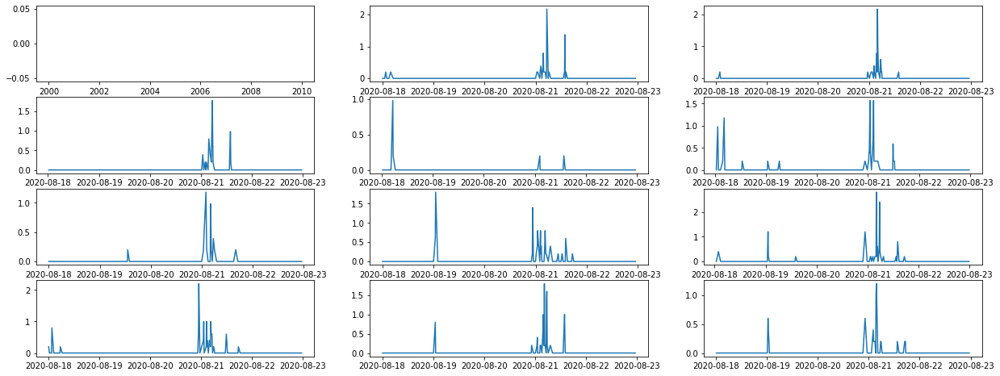

In [354]:
fig, ax = plt.subplots(4,3, figsize=(21,8))



x=[]
y=[]

for estacao in estacoes:
    y.append(al[al['nomeEstacao']==estacao]['2020-08-18':'2020-08-22']['valorMedida'])
    x.append(al[al['nomeEstacao']==estacao]['2020-08-18':'2020-08-22'].index)
    

ax[0][0].plot(x[0],y[0])
ax[0][1].plot(x[1],y[1])
ax[0][2].plot(x[2],y[2])
ax[1][0].plot(x[3],y[3])
ax[1][1].plot(x[4],y[4])
ax[1][2].plot(x[5],y[5])
ax[2][0].plot(x[6],y[6])
ax[2][1].plot(x[7],y[7])
ax[2][2].plot(x[8],y[8])
ax[3][0].plot(x[9],y[9])
ax[3][1].plot(x[10],y[10])
ax[3][2].plot(x[11],y[11])

In [462]:
tweet = chuvas[99]
print(tweet.full_text)
print('\n----------------------\n')


print(tweet.created_at - timedelta(hours=3))

RT @tehlopess: @IrlanLopess Ainda colocou barulho de chuva na tv, adorei dormi assim. 🥰

----------------------

2020-08-18 09:36:26


In [464]:
al_tweets = [0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
             0, 0, 0, 1, 0, 0, 0, 0, 0, 0,
             0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
             0, 0, 1, 0, 1, 1, 1, 0, 1, 0,
             0, 1, 1, 1, 0, 0, 1, 1, 1, 0,
             1, 0, 0, 1, 0, 1, 1, 0, 0, 1,
             0, 0, 1, 0, 0, 1, 1, 0, 1, 0,
             0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
             0, 0, 0, 0, 0, 0, 1, 1, 1, 0,
             0, 1, 1, 1, 0, 0, 0, 0, 0, 0]

In [465]:
dic_al = {'horario':[tweet.created_at - timedelta(hours=3) for tweet in chuvas],
       'local':[tweet.user.location for tweet in chuvas],
       'texto': [tweet.full_text for tweet in chuvas],
       'relevancia':al_tweets} 

In [468]:
al_df = pd.DataFrame(dic_al)

In [469]:
al_df

,horario,local,texto,relevancia
0,2020-08-22 19:53:38,Alagoas,@Enaldinho1 @uselolja @QGDoEnaldinho Chuva #MP...,0
1,2020-08-22 18:30:26,𝒂𝒕𝒂𝒍𝒂𝒊𝒂,"""– Hayden. O nome dele será Hayden.""\n(Chuva -...",0
2,2020-08-22 18:16:59,𝒂𝒕𝒂𝒍𝒂𝒊𝒂,Ainda tô no prólogo de Chuva e já senti vontad...,0
3,2020-08-22 18:16:13,𝒂𝒕𝒂𝒍𝒂𝒊𝒂,"""Ela soluçava ruidosamente. Era um choro parti...",0
4,2020-08-22 17:49:46,𝒂𝒕𝒂𝒍𝒂𝒊𝒂,"""A chuva estava quase chegando.""\n(Chuva - Liv...",0
...,...,...,...,...
95,2020-08-18 14:59:36,"Maceió, Brasil",eu odeio n ter condições de criar outro cachor...,0
96,2020-08-18 12:34:05,Alagoas🌵,Chuva de arroz??? https://t.co/3RhcvW0M4h,0
97,2020-08-18 09:57:46,"Maceió, Brasil",@lenycatia @ThRod @correio Imagina 57mil pesso...,0
98,2020-08-18 09:43:29,"Alagoas, Brazil",a chuva da vitoria vai reinar no fim 🌈🌈🌈🌈🌈🌈🌈🌈,0


In [470]:
pickle.dump(chuvas, open('chuvas_al_1822-08.p', 'wb'))

In [471]:
al_df.to_csv("chuvas_al_1822-08.csv")

#### __Pará__

In [974]:
ba = pd.read_csv('dados/BA.csv', sep=';', decimal=',',parse_dates=[6],infer_datetime_format = True,index_col=False)

In [975]:
ba.head()

,municipio,codEstacao,uf,nomeEstacao,latitude,longitude,datahora,valorMedida
0,SALVADOR,292740801A,BA,Pirajá,-38.458867,-12.898697,2020-08-01 00:20:00,0.0
1,SALVADOR,292740801A,BA,Pirajá,-38.458867,-12.898697,2020-08-01 00:40:00,0.2
2,SALVADOR,292740801A,BA,Pirajá,-38.458867,-12.898697,2020-08-01 01:20:00,0.0
3,SALVADOR,292740801A,BA,Pirajá,-38.458867,-12.898697,2020-08-01 02:20:00,0.0
4,SALVADOR,292740801A,BA,Pirajá,-38.458867,-12.898697,2020-08-01 03:00:00,0.2


In [976]:
ba.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13567 entries, 0 to 13566
Data columns (total 8 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   municipio    13567 non-null  object        
 1   codEstacao   13567 non-null  object        
 2   uf           13567 non-null  object        
 3   nomeEstacao  13567 non-null  object        
 4   latitude     13567 non-null  float64       
 5   longitude    13567 non-null  float64       
 6   datahora     13567 non-null  datetime64[ns]
 7   valorMedida  13567 non-null  float64       
dtypes: datetime64[ns](1), float64(3), object(4)
memory usage: 848.1+ KB


In [977]:
ba.set_index('datahora', inplace=True)
ba.head()

,municipio,codEstacao,uf,nomeEstacao,latitude,longitude,valorMedida
datahora,,,,,,,
2020-08-01 00:20:00,SALVADOR,292740801A,BA,Pirajá,-38.458867,-12.898697,0.0
2020-08-01 00:40:00,SALVADOR,292740801A,BA,Pirajá,-38.458867,-12.898697,0.2
2020-08-01 01:20:00,SALVADOR,292740801A,BA,Pirajá,-38.458867,-12.898697,0.0
2020-08-01 02:20:00,SALVADOR,292740801A,BA,Pirajá,-38.458867,-12.898697,0.0
2020-08-01 03:00:00,SALVADOR,292740801A,BA,Pirajá,-38.458867,-12.898697,0.2


In [978]:
ba.groupby('nomeEstacao')['latitude'].unique()

nomeEstacao
CAB                                  [-38.421264]
Cabula                               [-38.460007]
Centro                               [-38.515945]
Fazenda Coutos                       [-38.460738]
Fazenda Grande do Retiro             [-38.485074]
Federação                            [-38.510245]
Itapuã                               [-38.369031]
Matatu                                [-38.49497]
Monte Serrat                          [-38.51579]
Mussurunga                            [-38.36589]
Periperi                              [-38.45637]
Pirajá                               [-38.458867]
Rio Sena                    [-38.468270000000004]
Stiep                                [-38.452599]
São Caetano                          [-38.474428]
São Tomé de Paripe                   [-38.489829]
Tancredo Neves                       [-38.452408]
Valéria                              [-38.437301]
Águas Claras                         [-38.441356]
Name: latitude, dtype: object

In [979]:
ba.groupby('nomeEstacao')['longitude'].unique()

nomeEstacao
CAB                                  [-12.943354]
Cabula                               [-12.960038]
Centro                                [-12.97821]
Fazenda Coutos                       [-12.848643]
Fazenda Grande do Retiro             [-12.937639]
Federação                            [-12.999514]
Itapuã                               [-12.946369]
Matatu                                 [-12.9779]
Monte Serrat                          [-12.92951]
Mussurunga                           [-12.914686]
Periperi                             [-12.865468]
Pirajá                               [-12.898697]
Rio Sena                              [-12.88769]
Stiep                                [-12.975868]
São Caetano                          [-12.937967]
São Tomé de Paripe                   [-12.794191]
Tancredo Neves              [-12.944007000000001]
Valéria                              [-12.862807]
Águas Claras                [-12.893244000000001]
Name: longitude, dtype: object

In [987]:
lat = ba.groupby('nomeEstacao')['latitude'].unique().astype(float)
lon = ba.groupby('nomeEstacao')['longitude'].unique().astype(float)

In [988]:
lat

nomeEstacao
CAB                        -38.421264
Cabula                     -38.460007
Centro                     -38.515945
Fazenda Coutos             -38.460738
Fazenda Grande do Retiro   -38.485074
Federação                  -38.510245
Itapuã                     -38.369031
Matatu                     -38.494970
Monte Serrat               -38.515790
Mussurunga                 -38.365890
Periperi                   -38.456370
Pirajá                     -38.458867
Rio Sena                   -38.468270
Stiep                      -38.452599
São Caetano                -38.474428
São Tomé de Paripe         -38.489829
Tancredo Neves             -38.452408
Valéria                    -38.437301
Águas Claras               -38.441356
Name: latitude, dtype: float64

In [989]:
lon

nomeEstacao
CAB                        -12.943354
Cabula                     -12.960038
Centro                     -12.978210
Fazenda Coutos             -12.848643
Fazenda Grande do Retiro   -12.937639
Federação                  -12.999514
Itapuã                     -12.946369
Matatu                     -12.977900
Monte Serrat               -12.929510
Mussurunga                 -12.914686
Periperi                   -12.865468
Pirajá                     -12.898697
Rio Sena                   -12.887690
Stiep                      -12.975868
São Caetano                -12.937967
São Tomé de Paripe         -12.794191
Tancredo Neves             -12.944007
Valéria                    -12.862807
Águas Claras               -12.893244
Name: longitude, dtype: float64

In [990]:
coordenadasBA= pd.DataFrame([lat, lon]).T

In [991]:
coordenadasBA

,latitude,longitude
nomeEstacao,,
CAB,-38.421264,-12.943354
Cabula,-38.460007,-12.960038
Centro,-38.515945,-12.978210
Fazenda Coutos,-38.460738,-12.848643
Fazenda Grande do Retiro,-38.485074,-12.937639
Federação,-38.510245,-12.999514
Itapuã,-38.369031,-12.946369
Matatu,-38.494970,-12.977900
Monte Serrat,-38.515790,-12.929510


In [992]:
estacoes = ba['nomeEstacao'].unique()
len(estacoes)

19

In [993]:
Bahia = 'dados/geojson/BA.json'
latitudeBA = -12.9704
longitudeBA = -38.5124 
raio = 20


centro = [latitudeBA,longitudeBA]
mapa = folium.Map(
    location = centro,
    zoom_start=11
)

folium.GeoJson(
    Bahia,
    name='geojson'
).add_to(mapa)


folium.Circle(
    radius=raio*1000,
    location=centro,
    popup='Centro',
    color='crimson',
    fill=False,
).add_to(mapa)

for index, row in coordenadasBA.iterrows():
    folium.Marker(
        location=[row['longitude'], row['latitude']],
        popup=index,
    ).add_to(mapa)


mapa

In [1001]:
geocodeStr = '{},{},{}km'.format(latitudeBA, longitudeBA, raio)
geocodeStr

'-12.9704,-38.5124,20km'

In [1002]:
chuvas = api.search(q = 'chuva OR enchente OR chuvendo OR chove OR chuvas',
                    geocode = geocodeStr, 
                    count = 101,
                    tweet_mode = 'extended',
                    until = '2020-08-22')

In [1003]:
len(chuvas)

100

In [1004]:
[print(tweet.full_text) for tweet in chuvas]

@LuciaLo20914588 🤣🤣🤣 vdd!
Morei em Belém, chove e não muda nada! Calor da desgraça mesmo!
Que conversa é essa que vcs querem neve aqui em salvador? Se quando chove a rua fica uma imundície, imagine a neve junto com a lama... tranca o cu, deixe de Maluquice
Toda vez que chove eu oro pedindo a Deus que proteja as pessoas em situação de rua consigam encarar esse momento difícil https://t.co/gV4ZELfhlL
RT @jrmutti: @MarquinhosAssu2 @simpraisa Morei aí 10 meses. Até que choveu bem mas foi considerado hiper atípico. Em outras viagens nunca v…
RT @MarcilioJuniior: Sexta feira, frio do caralho, chuva e eu no terreiro... A vida do candomblecista é uma luta viu
Sexta feira, frio do caralho, chuva e eu no terreiro... A vida do candomblecista é uma luta viu
Hj foi horrível trabalhar nessa chuva
Só queria poder lavar meu cabelo pra me sentir biito e não a água suja do córrego depois de uma chuva que os dejetos tamparam as bocas de lobo
@mina_boba_ @mile_bs Sim, penso nisso demais! Um exemplo aqui d

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

In [1005]:
[print(tweet.created_at) for tweet in chuvas]

2020-08-21 23:57:24
2020-08-21 23:50:01
2020-08-21 23:34:33
2020-08-21 23:19:56
2020-08-21 23:04:13
2020-08-21 22:56:09
2020-08-21 22:38:14
2020-08-21 22:17:24
2020-08-21 21:35:46
2020-08-21 21:14:47
2020-08-21 21:11:47
2020-08-21 21:09:24
2020-08-21 20:57:03
2020-08-21 20:53:38
2020-08-21 20:35:16
2020-08-21 19:58:14
2020-08-21 19:28:21
2020-08-21 19:24:35
2020-08-21 19:12:03
2020-08-21 19:04:37
2020-08-21 19:00:52
2020-08-21 18:58:33
2020-08-21 18:18:59
2020-08-21 18:08:39
2020-08-21 18:04:49
2020-08-21 17:50:54
2020-08-21 17:50:26
2020-08-21 17:46:55
2020-08-21 17:41:06
2020-08-21 17:34:48
2020-08-21 17:09:27
2020-08-21 16:51:48
2020-08-21 15:34:51
2020-08-21 15:14:55
2020-08-21 15:11:34
2020-08-21 15:02:29
2020-08-21 14:47:18
2020-08-21 14:12:27
2020-08-21 14:02:34
2020-08-21 13:55:00
2020-08-21 13:10:07
2020-08-21 13:08:59
2020-08-21 13:04:40
2020-08-21 12:55:29
2020-08-21 12:42:04
2020-08-21 12:39:04
2020-08-21 12:05:12
2020-08-21 11:46:07
2020-08-21 11:32:44
2020-08-21 06:12:20


[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

In [1006]:
ba['2020-08-22'].groupby('nomeEstacao').resample('D').max()['valorMedida']

nomeEstacao               datahora  
CAB                       2020-08-22    0.0
Cabula                    2020-08-22    0.0
Centro                    2020-08-22    0.0
Fazenda Coutos            2020-08-22    0.0
Fazenda Grande do Retiro  2020-08-22    0.0
Federação                 2020-08-22    0.0
Itapuã                    2020-08-22    0.0
Matatu                    2020-08-22    0.0
Monte Serrat              2020-08-22    0.0
Mussurunga                2020-08-22    0.0
Periperi                  2020-08-22    0.0
Pirajá                    2020-08-22    0.0
Rio Sena                  2020-08-22    0.0
Stiep                     2020-08-22    0.0
São Caetano               2020-08-22    0.0
São Tomé de Paripe        2020-08-22    0.0
Tancredo Neves            2020-08-22    0.0
Valéria                   2020-08-22    0.0
Águas Claras              2020-08-22    0.0
Name: valorMedida, dtype: float64

In [351]:
#estacoes = al['nomeEstacao'].unique()
#d = np.where(estacoes=='Ipioca')
#d

(array([6]),)

In [352]:
#estacoes = np.delete(estacoes, d)
#estacoes

array(['Tabuleiro do Martins2', 'Farol', 'Tabuleiro do Martins', 'Farol2',
       'Trapiche da Barra', 'Benedito Bentes I', 'Cruz das Almas',
       'Antares', 'Clima Bom', 'Cidade Universitária', 'Chã da Jaqueira',
       'Cambona'], dtype=object)

In [1007]:
len(estacoes)

19

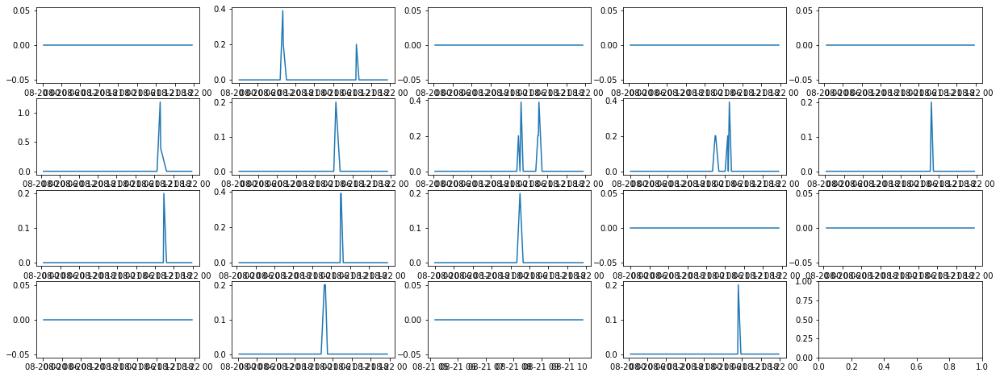

In [1009]:
fig, ax = plt.subplots(4,5, figsize=(21,8))



x=[]
y=[]

for estacao in estacoes:
    y.append(ba[ba['nomeEstacao']==estacao]['2020-08-20':'2020-08-21']['valorMedida'])
    x.append(ba[ba['nomeEstacao']==estacao]['2020-08-20':'2020-08-21'].index)
    

ax[0][0].plot(x[0],y[0])
ax[0][1].plot(x[1],y[1])
ax[0][2].plot(x[2],y[2])
ax[0][3].plot(x[3],y[3])
ax[0][4].plot(x[4],y[4])
ax[1][0].plot(x[5],y[5])
ax[1][1].plot(x[6],y[6])
ax[1][2].plot(x[7],y[7])
ax[1][3].plot(x[8],y[8])
ax[1][4].plot(x[9],y[9])
ax[2][0].plot(x[10],y[10])
ax[2][1].plot(x[11],y[11])
ax[2][2].plot(x[12],y[12])
ax[2][3].plot(x[13],y[13])
ax[2][4].plot(x[14],y[14])
ax[3][0].plot(x[15],y[15])
ax[3][1].plot(x[16],y[16])
ax[3][2].plot(x[17],y[17])
ax[3][3].plot(x[18],y[18])


In [1010]:
tweet = chuvas[4]
print(tweet.full_text)
print('\n----------------------\n')


print(tweet.created_at - timedelta(hours=3))

RT @MarcilioJuniior: Sexta feira, frio do caralho, chuva e eu no terreiro... A vida do candomblecista é uma luta viu

----------------------

2020-08-21 20:04:13


In [614]:
ba_tweets = [0, 0, 0, 0, 1, 1, 0, 0, 0, 0,
             0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
             0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
             0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
             0, 0, 0, 0, 0, 1, 0, 0, 0, 0,
             0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
             1, 0, 0, 0, 0, 0, 0, 0, 0, 0,
             0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
             0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
             0, 0, 0, 0, 0, 0, 0, 0, 0, 0]

In [616]:
dic_ba = {'horario':[tweet.created_at - timedelta(hours=3) for tweet in chuvas],
       'local':[tweet.user.location for tweet in chuvas],
       'texto': [tweet.full_text for tweet in chuvas],
       'relevancia':al_tweets} 

In [618]:
ba_df = pd.DataFrame(dic_ba)

In [619]:
ba_df

,horario,local,texto,relevancia
0,2020-08-21 20:57:24,salvador bahia,"@LuciaLo20914588 🤣🤣🤣 vdd!\nMorei em Belém, cho...",0
1,2020-08-21 20:50:01,"Salvador, Brasil",Que conversa é essa que vcs querem neve aqui e...,0
2,2020-08-21 20:34:33,Salvador,Toda vez que chove eu oro pedindo a Deus que p...,0
3,2020-08-21 20:19:56,João Pessoa/PB,RT @jrmutti: @MarquinhosAssu2 @simpraisa Morei...,0
4,2020-08-21 20:04:13,,"RT @MarcilioJuniior: Sexta feira, frio do cara...",0
...,...,...,...,...
95,2020-08-20 18:59:45,"Salvador, Brazil",@urubullish Chuva de dinheiro,0
96,2020-08-20 18:50:23,"Salvador, Brasil",Coisas que eu quero fazer depois da pandemia :...,0
97,2020-08-20 18:36:22,"Salvador, Bahia, Brasil",Toda vez que vejo qualquer série ou filme ambi...,0
98,2020-08-20 17:37:40,,"@pauloocesarpc Jovem, o meu é de 2012 aHaHahHa...",0


In [620]:
pickle.dump(chuvas, open('chuvas_ba_2021-08.p', 'wb'))

In [621]:
ba_df.to_csv("chuvas_ba_2021-08.csv")

#### __Ceará__

In [627]:
ce = pd.read_csv('dados/CE.csv', sep=';', decimal=',',parse_dates=[6],infer_datetime_format = True,index_col=False)

In [628]:
ce.head()

,municipio,codEstacao,uf,nomeEstacao,latitude,longitude,datahora,valorMedida
0,FORTALEZA,230440001A,CE,Edson Queiroz,-38.462167,-3.774444,2020-08-01 00:20:00,0.0
1,FORTALEZA,230440001A,CE,Edson Queiroz,-38.462167,-3.774444,2020-08-01 01:20:00,0.0
2,FORTALEZA,230440001A,CE,Edson Queiroz,-38.462167,-3.774444,2020-08-01 02:20:00,0.0
3,FORTALEZA,230440001A,CE,Edson Queiroz,-38.462167,-3.774444,2020-08-01 03:20:00,0.0
4,FORTALEZA,230440001A,CE,Edson Queiroz,-38.462167,-3.774444,2020-08-01 04:20:00,0.0


In [629]:
ce.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4360 entries, 0 to 4359
Data columns (total 8 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   municipio    4360 non-null   object        
 1   codEstacao   4360 non-null   object        
 2   uf           4360 non-null   object        
 3   nomeEstacao  4360 non-null   object        
 4   latitude     4360 non-null   float64       
 5   longitude    4360 non-null   float64       
 6   datahora     4360 non-null   datetime64[ns]
 7   valorMedida  4360 non-null   float64       
dtypes: datetime64[ns](1), float64(3), object(4)
memory usage: 272.6+ KB


In [630]:
ce.set_index('datahora', inplace=True)
ce.head()

,municipio,codEstacao,uf,nomeEstacao,latitude,longitude,valorMedida
datahora,,,,,,,
2020-08-01 00:20:00,FORTALEZA,230440001A,CE,Edson Queiroz,-38.462167,-3.774444,0.0
2020-08-01 01:20:00,FORTALEZA,230440001A,CE,Edson Queiroz,-38.462167,-3.774444,0.0
2020-08-01 02:20:00,FORTALEZA,230440001A,CE,Edson Queiroz,-38.462167,-3.774444,0.0
2020-08-01 03:20:00,FORTALEZA,230440001A,CE,Edson Queiroz,-38.462167,-3.774444,0.0
2020-08-01 04:20:00,FORTALEZA,230440001A,CE,Edson Queiroz,-38.462167,-3.774444,0.0


In [631]:
ce.groupby('nomeEstacao')['latitude'].unique()

nomeEstacao
Antonio Bezerra                   [-38.589]
Antonio Bezerra2                  [-38.598]
Edson Queiroz                  [-38.462167]
João XXIII            [-38.586999999999996]
Parangaba                         [-38.555]
Passare                           [-38.533]
Presidente Kennedy                [-38.565]
Rio Coco                         [-38.5329]
Vila Pery             [-38.580999999999996]
Name: latitude, dtype: object

In [632]:
ce.groupby('nomeEstacao')['longitude'].unique()

nomeEstacao
Antonio Bezerra                    [-3.736]
Antonio Bezerra2      [-3.7260000000000004]
Edson Queiroz         [-3.7744440000000004]
João XXIII            [-3.7739999999999996]
Parangaba                          [-3.781]
Passare                            [-3.819]
Presidente Kennedy                 [-3.728]
Rio Coco                          [-3.8382]
Vila Pery                           [-3.79]
Name: longitude, dtype: object

In [633]:
lat = ce.groupby('nomeEstacao')['latitude'].unique().astype(float)
lon = ce.groupby('nomeEstacao')['longitude'].unique().astype(float)

In [634]:
lat

nomeEstacao
Antonio Bezerra      -38.589000
Antonio Bezerra2     -38.598000
Edson Queiroz        -38.462167
João XXIII           -38.587000
Parangaba            -38.555000
Passare              -38.533000
Presidente Kennedy   -38.565000
Rio Coco             -38.532900
Vila Pery            -38.581000
Name: latitude, dtype: float64

In [635]:
lon

nomeEstacao
Antonio Bezerra      -3.736000
Antonio Bezerra2     -3.726000
Edson Queiroz        -3.774444
João XXIII           -3.774000
Parangaba            -3.781000
Passare              -3.819000
Presidente Kennedy   -3.728000
Rio Coco             -3.838200
Vila Pery            -3.790000
Name: longitude, dtype: float64

In [636]:
coordenadasCE= pd.DataFrame([lat, lon]).T

In [637]:
coordenadasCE

,latitude,longitude
nomeEstacao,,
Antonio Bezerra,-38.589000,-3.736000
Antonio Bezerra2,-38.598000,-3.726000
Edson Queiroz,-38.462167,-3.774444
João XXIII,-38.587000,-3.774000
Parangaba,-38.555000,-3.781000
Passare,-38.533000,-3.819000
Presidente Kennedy,-38.565000,-3.728000
Rio Coco,-38.532900,-3.838200
Vila Pery,-38.581000,-3.790000


In [638]:
estacoes = ce['nomeEstacao'].unique()
len(estacoes)

9

In [646]:
Ceara = 'dados/geojson/CE.json'
latitudeCE = -3.71839
longitudeCE = -38.5434 
raio = 14


centro = [latitudeCE,longitudeCE]
mapa = folium.Map(
    location = centro,
    zoom_start=11
)

folium.GeoJson(
    Ceara,
    name='geojson'
).add_to(mapa)


folium.Circle(
    radius=raio*1000,
    location=centro,
    popup='Centro',
    color='crimson',
    fill=False,
).add_to(mapa)

for index, row in coordenadasCE.iterrows():
    folium.Marker(
        location=[row['longitude'], row['latitude']],
        popup=index,
    ).add_to(mapa)


mapa

In [661]:
geocodeStr = '{},{},{}km'.format(latitudeCE, longitudeCE, raio)
geocodeStr

'-3.71839,-38.5434,14km'

In [662]:
chuvas = api.search(q = 'chuva OR enchente OR chuvendo OR chove OR chuvas',
                    geocode = geocodeStr, 
                    count = 101,
                    tweet_mode = 'extended',
                    until = '2020-08-23')

In [663]:
len(chuvas)

100

In [664]:
[print(tweet.full_text) for tweet in chuvas]

@jacksoncruz A chuva dos 200 espirros
a unica certeza q tenho eh q qdo abrir o insta vai ter uma ruma de story da "chuva"
@Marisaaloppes aproveita a chuva marisinha vc merece tudo de bom linda
do nada uma chuva em sobral??
CHUVA REAL EM SOBRAL EM AGOSTO PQP
@soucamiis aparentemente a chuva aumentou? 😳
e essa chuva?? do nada
Chuva em sobral?????
RT @fortalordinaria: Será que chove ou é só Fortaleza frescando com a nossa cara? https://t.co/fzDkzTXZd0
amoo a chuva de 2 segundos
Valha e essa chuva do nada??
Vou jantar logo pq tá ameaçando uma chuva e tomar banho de chuva de noite/madrugada me dá uma sensação boa
Sim mulher iai? vai dar em que?
Quarentena tá ai,tu não vai me pegar hoje nao.Pode tirar seu cavalinho da chuva,não vou sair na rua aí pra brigar com tu nao.
Eu? me arriscar pegar um corona? 
Hum tu é dodja https://t.co/7KMjiwbnWP
Só eu que sinto cheiro de chuva e sinto vontade de beber? 😰
RT @RCresolve: Chuva Municipal em ação ☔️
RT @Filhote155: A chuva acabando com os planos 😏
A 

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

In [665]:
[print(tweet.created_at) for tweet in chuvas]

2020-08-22 23:58:44
2020-08-22 23:44:18
2020-08-22 23:43:48
2020-08-22 23:29:17
2020-08-22 23:28:10
2020-08-22 23:24:24
2020-08-22 23:21:35
2020-08-22 23:13:27
2020-08-22 23:11:15
2020-08-22 23:11:08
2020-08-22 23:08:42
2020-08-22 23:02:43
2020-08-22 22:43:59
2020-08-22 22:43:36
2020-08-22 22:32:37
2020-08-22 22:30:33
2020-08-22 22:29:07
2020-08-22 21:46:27
2020-08-22 21:07:55
2020-08-22 20:29:46
2020-08-22 20:04:55
2020-08-22 19:38:00
2020-08-22 18:23:06
2020-08-22 18:13:03
2020-08-22 18:08:58
2020-08-22 18:04:21
2020-08-22 17:39:42
2020-08-22 17:35:03
2020-08-22 17:29:38
2020-08-22 17:23:07
2020-08-22 17:19:02
2020-08-22 16:57:59
2020-08-22 16:31:41
2020-08-22 16:20:58
2020-08-22 15:23:04
2020-08-22 14:54:05
2020-08-22 14:47:14
2020-08-22 14:28:40
2020-08-22 14:19:27
2020-08-22 14:13:00
2020-08-22 13:59:39
2020-08-22 13:57:29
2020-08-22 13:56:28
2020-08-22 13:47:44
2020-08-22 13:40:51
2020-08-22 13:32:43
2020-08-22 13:19:45
2020-08-22 13:12:24
2020-08-22 13:08:58
2020-08-22 13:08:45


[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

In [666]:
ce['2020-08-22'].groupby('nomeEstacao').resample('D').max()['valorMedida']

nomeEstacao         datahora  
Antonio Bezerra     2020-08-22    0.2
Antonio Bezerra2    2020-08-22    0.0
Edson Queiroz       2020-08-22    0.0
João XXIII          2020-08-22    0.2
Parangaba           2020-08-22    0.0
Passare             2020-08-22    0.0
Presidente Kennedy  2020-08-22    0.2
Vila Pery           2020-08-22    0.0
Name: valorMedida, dtype: float64

In [351]:
#estacoes = al['nomeEstacao'].unique()
#d = np.where(estacoes=='Ipioca')
#d

(array([6]),)

In [352]:
#estacoes = np.delete(estacoes, d)
#estacoes

array(['Tabuleiro do Martins2', 'Farol', 'Tabuleiro do Martins', 'Farol2',
       'Trapiche da Barra', 'Benedito Bentes I', 'Cruz das Almas',
       'Antares', 'Clima Bom', 'Cidade Universitária', 'Chã da Jaqueira',
       'Cambona'], dtype=object)

In [667]:
len(estacoes)

9

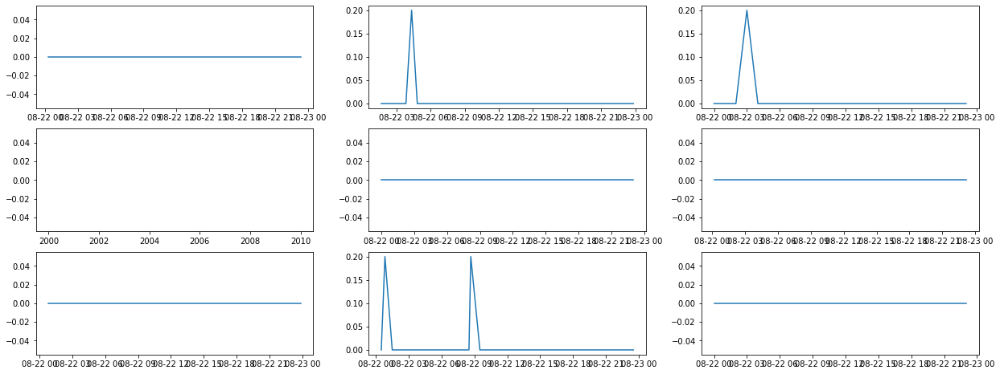

In [669]:
fig, ax = plt.subplots(3,3, figsize=(21,8))



x=[]
y=[]

for estacao in estacoes:
    y.append(ce[ce['nomeEstacao']==estacao]['2020-08-22']['valorMedida'])
    x.append(ce[ce['nomeEstacao']==estacao]['2020-08-22'].index)
    

ax[0][0].plot(x[0],y[0])
ax[0][1].plot(x[1],y[1])
ax[0][2].plot(x[2],y[2])
ax[1][0].plot(x[3],y[3])
ax[1][1].plot(x[4],y[4])
ax[1][2].plot(x[5],y[5])
ax[2][0].plot(x[6],y[6])
ax[2][1].plot(x[7],y[7])
ax[2][2].plot(x[8],y[8])




In [771]:
tweet = chuvas[99]
print(tweet.full_text)
print('\n----------------------\n')


print(tweet.created_at - timedelta(hours=3))

Chuva cai la fora ....

----------------------

2020-08-21 23:34:46


In [772]:
ce_tweets = [0, 0, 0, 1, 1, 1, 1, 1, 0, 0,
             1, 0, 0, 0, 0, 0, 0, 0, 0, 0,
             0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
             0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
             0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
             0, 0, 0, 0, 0, 0, 0, 0, 0, 1,
             0, 0, 0, 0, 0, 1, 0, 1, 1, 1,
             0, 0, 1, 0, 0, 0, 0, 0, 0, 0,
             1, 0, 1, 1, 0, 0, 0, 0, 0, 0,
             1, 0, 0, 0, 1, 1, 0, 1, 1, 1]

In [773]:
dic_ce = {'horario':[tweet.created_at - timedelta(hours=3) for tweet in chuvas],
       'local':[tweet.user.location for tweet in chuvas],
       'texto': [tweet.full_text for tweet in chuvas],
       'relevancia':ce_tweets} 

In [774]:
ce_df = pd.DataFrame(dic_ce)

In [775]:
ce_df

,horario,local,texto,relevancia
0,2020-08-22 20:58:44,"Fortaleza, Brasil",@jacksoncruz A chuva dos 200 espirros,0
1,2020-08-22 20:44:18,Ceará,a unica certeza q tenho eh q qdo abrir o insta...,0
2,2020-08-22 20:43:48,Ceará,@Marisaaloppes aproveita a chuva marisinha vc ...,0
3,2020-08-22 20:29:17,"Ceará, Brazil",do nada uma chuva em sobral??,1
4,2020-08-22 20:28:10,"Ceará, Brasil",CHUVA REAL EM SOBRAL EM AGOSTO PQP,1
...,...,...,...,...
95,2020-08-21 23:41:45,"Fortaleza, Brasil",cheirinho de chuva,1
96,2020-08-21 23:40:59,"Fortaleza, Brasil","@otacarina Mulher, a desgraça saiu correndo at...",0
97,2020-08-21 23:40:57,Fortaleza,Chuva na Sapiranga 🌿,1
98,2020-08-21 23:37:43,"Fortaleza, Ceará - Brasil.",CHUVA EM FORTALEZA 😭🌧️ finalmenteeee pq esses ...,1


In [776]:
pickle.dump(chuvas, open('chuvas_ce_22-08.p', 'wb'))

In [778]:
ce_df.to_csv("chuvas_ce_22-08.csv")

#### __Amazonas__

In [779]:
am = pd.read_csv('dados/AM.csv', sep=';', decimal=',',parse_dates=[6],infer_datetime_format = True,index_col=False)

In [780]:
am.head()

,municipio,codEstacao,uf,nomeEstacao,latitude,longitude,datahora,valorMedida
0,MANAUS,130260327A,AM,Cidade de Deus,-59.940258,-3.019539,2020-08-08 13:50:00,0.2
1,MANAUS,130260327A,AM,Cidade de Deus,-59.940258,-3.019539,2020-08-08 14:30:00,0.0
2,MANAUS,130260327A,AM,Cidade de Deus,-59.940258,-3.019539,2020-08-08 15:30:00,0.0
3,MANAUS,130260327A,AM,Cidade de Deus,-59.940258,-3.019539,2020-08-08 16:30:00,0.0
4,MANAUS,130260327A,AM,Cidade de Deus,-59.940258,-3.019539,2020-08-08 17:30:00,0.0


In [781]:
am.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1358 entries, 0 to 1357
Data columns (total 8 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   municipio    1358 non-null   object        
 1   codEstacao   1358 non-null   object        
 2   uf           1358 non-null   object        
 3   nomeEstacao  1358 non-null   object        
 4   latitude     1358 non-null   float64       
 5   longitude    1358 non-null   float64       
 6   datahora     1358 non-null   datetime64[ns]
 7   valorMedida  1358 non-null   float64       
dtypes: datetime64[ns](1), float64(3), object(4)
memory usage: 85.0+ KB


In [782]:
am.set_index('datahora', inplace=True)
am.head()

,municipio,codEstacao,uf,nomeEstacao,latitude,longitude,valorMedida
datahora,,,,,,,
2020-08-08 13:50:00,MANAUS,130260327A,AM,Cidade de Deus,-59.940258,-3.019539,0.2
2020-08-08 14:30:00,MANAUS,130260327A,AM,Cidade de Deus,-59.940258,-3.019539,0.0
2020-08-08 15:30:00,MANAUS,130260327A,AM,Cidade de Deus,-59.940258,-3.019539,0.0
2020-08-08 16:30:00,MANAUS,130260327A,AM,Cidade de Deus,-59.940258,-3.019539,0.0
2020-08-08 17:30:00,MANAUS,130260327A,AM,Cidade de Deus,-59.940258,-3.019539,0.0


In [783]:
am.groupby('nomeEstacao')['latitude'].unique()

nomeEstacao
Cidade de Deus     [-59.94025799999999]
Mauazinho         [-59.940003000000004]
Puraquequara      [-59.844910999999996]
Name: latitude, dtype: object

In [784]:
am.groupby('nomeEstacao')['longitude'].unique()

nomeEstacao
Cidade de Deus    [-3.019539]
Mauazinho         [-3.124403]
Puraquequara      [-3.059128]
Name: longitude, dtype: object

In [785]:
lat = am.groupby('nomeEstacao')['latitude'].unique().astype(float)
lon = am.groupby('nomeEstacao')['longitude'].unique().astype(float)

In [786]:
lat

nomeEstacao
Cidade de Deus   -59.940258
Mauazinho        -59.940003
Puraquequara     -59.844911
Name: latitude, dtype: float64

In [787]:
lon

nomeEstacao
Cidade de Deus   -3.019539
Mauazinho        -3.124403
Puraquequara     -3.059128
Name: longitude, dtype: float64

In [788]:
coordenadasAM= pd.DataFrame([lat, lon]).T

In [789]:
coordenadasAM

,latitude,longitude
nomeEstacao,,
Cidade de Deus,-59.940258,-3.019539
Mauazinho,-59.940003,-3.124403
Puraquequara,-59.844911,-3.059128


In [790]:
estacoes = am['nomeEstacao'].unique()
len(estacoes)

3

In [795]:
Amazonas = 'dados/geojson/AM.json'
latitudeAM = -3.10719
longitudeAM = -60.0261
raio = 22


centro = [latitudeAM,longitudeAM]
mapa = folium.Map(
    location = centro,
    zoom_start=11
)

folium.GeoJson(
    Amazonas,
    name='geojson'
).add_to(mapa)


folium.Circle(
    radius=raio*1000,
    location=centro,
    popup='Centro',
    color='crimson',
    fill=False,
).add_to(mapa)

for index, row in coordenadasAM.iterrows():
    folium.Marker(
        location=[row['longitude'], row['latitude']],
        popup=index,
    ).add_to(mapa)


mapa

In [824]:
geocodeStr = '{},{},{}km'.format(latitudeAM, longitudeAM, raio)
geocodeStr

'-3.10719,-60.0261,22km'

In [825]:
chuvas = api.search(q = 'chuva OR enchente OR chuvendo OR chove OR chuvas',
                    geocode = geocodeStr, 
                    count = 101,
                    tweet_mode = 'extended',
                    until = '2020-08-23')

In [826]:
len(chuvas)

100

In [827]:
[print(tweet.full_text) for tweet in chuvas]

RT @cigarctic: ventou, ventou, ventou e nenhuma chuva

porra manaus
RT @vitrrhugo: quando chove em manaus https://t.co/iv3lHxrnSn
@tiagotheworld Amo q ela levou chuva de unf mas a galera já voltou em dobro
@dunburnt Pior que eu fui olhar agora e tá com mó pinta de chuva. Somos 2 iludidos
RT @vitrrhugo: quando chove em manaus https://t.co/iv3lHxrnSn
Parece que vem uma chuva das grades e hoje mais do que nunca eu digo rain on me caralho
“Chuva: Os Dez Cavaleiros” é obra de Caio Porfírio Carneiro. Conto. São Paulo, Editora Hucitec, 1977. O nosso abraço fraterno aos capixabas de Serra, Vila Velha, Guarapari, Colatina, Aracruz e Viana. Acervo do escritor Raimundo Colares Ribeiro.
#Literatura #Escritores #Livros https://t.co/0xmi61nulF
@hebk___ o que tá acontecendo que tá uma chuva de filme da DC hoje????
RT @anticristah: A PREVISÃO DO TEMPO DIZ Q O CÉU FECHOOOOU O PODER NA VITÓRIA VAI CURAR A DOR O TEMPORAL AGORA VAI CAIR EM MIM A CHUVA DA V…
pensando seriamente e sair pra correr, mas fica 

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

In [828]:
[print(tweet.created_at) for tweet in chuvas]

2020-08-22 23:48:03
2020-08-22 23:39:24
2020-08-22 23:38:49
2020-08-22 23:03:03
2020-08-22 22:46:21
2020-08-22 22:45:59
2020-08-22 22:31:32
2020-08-22 22:26:40
2020-08-22 22:26:28
2020-08-22 22:25:14
2020-08-22 22:18:40
2020-08-22 21:41:52
2020-08-22 21:25:06
2020-08-22 21:02:03
2020-08-22 21:02:02
2020-08-22 20:38:29
2020-08-22 20:16:22
2020-08-22 19:59:54
2020-08-22 19:33:33
2020-08-22 19:31:40
2020-08-22 18:48:51
2020-08-22 18:47:43
2020-08-22 18:23:09
2020-08-22 18:05:23
2020-08-22 17:50:31
2020-08-22 17:38:33
2020-08-22 17:34:41
2020-08-22 17:13:59
2020-08-22 17:07:58
2020-08-22 16:59:48
2020-08-22 16:51:09
2020-08-22 16:21:53
2020-08-22 16:21:38
2020-08-22 16:09:34
2020-08-22 15:43:33
2020-08-22 15:43:11
2020-08-22 15:42:09
2020-08-22 15:31:13
2020-08-22 15:27:36
2020-08-22 15:13:31
2020-08-22 15:05:39
2020-08-22 15:05:14
2020-08-22 15:04:30
2020-08-22 14:46:39
2020-08-22 14:46:01
2020-08-22 14:45:58
2020-08-22 14:44:18
2020-08-22 14:41:10
2020-08-22 14:40:17
2020-08-22 14:33:36


[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

In [814]:
am['2020-08-22'].groupby('nomeEstacao').resample('D').max()['valorMedida']

nomeEstacao     datahora  
Cidade de Deus  2020-08-22    0.00
Mauazinho       2020-08-22    2.56
Puraquequara    2020-08-22    0.00
Name: valorMedida, dtype: float64

In [351]:
#estacoes = al['nomeEstacao'].unique()
#d = np.where(estacoes=='Ipioca')
#d

(array([6]),)

In [352]:
#estacoes = np.delete(estacoes, d)
#estacoes

array(['Tabuleiro do Martins2', 'Farol', 'Tabuleiro do Martins', 'Farol2',
       'Trapiche da Barra', 'Benedito Bentes I', 'Cruz das Almas',
       'Antares', 'Clima Bom', 'Cidade Universitária', 'Chã da Jaqueira',
       'Cambona'], dtype=object)

In [806]:
len(estacoes)

3

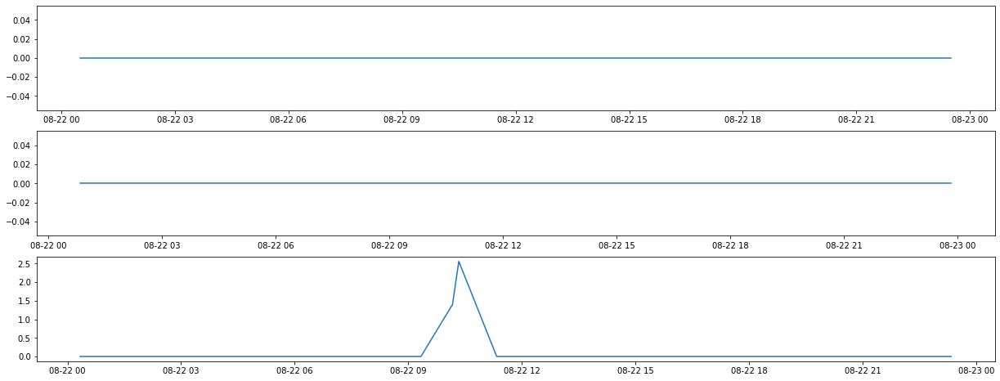

In [816]:
fig, ax = plt.subplots(3,1, figsize=(21,8))



x=[]
y=[]

for estacao in estacoes:
    y.append(am[am['nomeEstacao']==estacao]['2020-08-22']['valorMedida'])
    x.append(am[am['nomeEstacao']==estacao]['2020-08-22'].index)
    

ax[0].plot(x[0],y[0])
ax[1].plot(x[1],y[1])
ax[2].plot(x[2],y[2])



In [931]:
tweet = chuvas[99]
print(tweet.full_text)
print('\n----------------------\n')


print(tweet.created_at - timedelta(hours=3))

RT @anticristah: A PREVISÃO DO TEMPO DIZ Q O CÉU FECHOOOOU O PODER NA VITÓRIA VAI CURAR A DOR O TEMPORAL AGORA VAI CAIR EM MIM A CHUVA DA V…

----------------------

2020-08-22 07:00:00


In [933]:
am_tweets = [0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
             1, 1, 0, 0, 0, 0, 0, 0, 0, 0,
             0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
             0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
             0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
             0, 0, 0, 0, 0, 0, 0, 0, 1, 0,
             0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
             0, 1, 0, 0, 0, 0, 0, 0, 0, 1,
             0, 0, 0, 0, 0, 0, 0, 0, 1, 1,
             1, 0, 1, 1, 1, 1, 1, 1, 0, 0]

In [934]:
dic_am = {'horario':[tweet.created_at - timedelta(hours=3) for tweet in chuvas],
       'local':[tweet.user.location for tweet in chuvas],
       'texto': [tweet.full_text for tweet in chuvas],
       'relevancia':al_tweets} 

In [935]:
am_df = pd.DataFrame(dic_am)

In [936]:
am_df

,horario,local,texto,relevancia
0,2020-08-22 20:48:03,"Manaus, Brasil","RT @cigarctic: ventou, ventou, ventou e nenhum...",0
1,2020-08-22 20:39:24,,RT @vitrrhugo: quando chove em manaus https://...,0
2,2020-08-22 20:38:49,"Manaus, Brasil",@tiagotheworld Amo q ela levou chuva de unf ma...,0
3,2020-08-22 20:03:03,"Manaus, Brasil",@dunburnt Pior que eu fui olhar agora e tá com...,0
4,2020-08-22 19:46:21,Manaus,RT @vitrrhugo: quando chove em manaus https://...,0
...,...,...,...,...
95,2020-08-22 07:19:54,"Manaus, Brasil",Chuva de manhãzinha,0
96,2020-08-22 07:16:20,"Manaus, Brasil",Planejei a semana toda que faria uma foto hoje...,0
97,2020-08-22 07:15:25,Manaus,A chuva manoooo até quefim,0
98,2020-08-22 07:02:12,"Manaus, Brasil","Bom dia, finalmente Manaus não acordou com o b...",0


In [938]:
pickle.dump(chuvas, open('chuvas_am_22-08.p', 'wb'))

In [942]:
am_df.to_csv("chuvas_am_22-08.csv")

#### __Pará__

In [1011]:
pa = pd.read_csv('dados/PA.csv', sep=';', decimal=',',parse_dates=[6],infer_datetime_format = True,index_col=False)

In [1012]:
pa.head()

,municipio,codEstacao,uf,nomeEstacao,latitude,longitude,datahora,valorMedida
0,BELÉM,150140201H,PA,Canal da Quintino Bocaiuva,-48.483548,-1.467778,2020-08-01 00:10:00,0.0
1,BELÉM,150140201H,PA,Canal da Quintino Bocaiuva,-48.483548,-1.467778,2020-08-01 01:10:00,0.0
2,BELÉM,150140201H,PA,Canal da Quintino Bocaiuva,-48.483548,-1.467778,2020-08-01 02:10:00,0.0
3,BELÉM,150140201H,PA,Canal da Quintino Bocaiuva,-48.483548,-1.467778,2020-08-01 03:10:00,0.0
4,BELÉM,150140201H,PA,Canal da Quintino Bocaiuva,-48.483548,-1.467778,2020-08-01 04:10:00,0.0


In [1013]:
pa.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4250 entries, 0 to 4249
Data columns (total 8 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   municipio    4250 non-null   object        
 1   codEstacao   4250 non-null   object        
 2   uf           4250 non-null   object        
 3   nomeEstacao  4250 non-null   object        
 4   latitude     4250 non-null   float64       
 5   longitude    4250 non-null   float64       
 6   datahora     4250 non-null   datetime64[ns]
 7   valorMedida  4250 non-null   float64       
dtypes: datetime64[ns](1), float64(3), object(4)
memory usage: 265.8+ KB


In [1014]:
pa.set_index('datahora', inplace=True)
pa.head()

,municipio,codEstacao,uf,nomeEstacao,latitude,longitude,valorMedida
datahora,,,,,,,
2020-08-01 00:10:00,BELÉM,150140201H,PA,Canal da Quintino Bocaiuva,-48.483548,-1.467778,0.0
2020-08-01 01:10:00,BELÉM,150140201H,PA,Canal da Quintino Bocaiuva,-48.483548,-1.467778,0.0
2020-08-01 02:10:00,BELÉM,150140201H,PA,Canal da Quintino Bocaiuva,-48.483548,-1.467778,0.0
2020-08-01 03:10:00,BELÉM,150140201H,PA,Canal da Quintino Bocaiuva,-48.483548,-1.467778,0.0
2020-08-01 04:10:00,BELÉM,150140201H,PA,Canal da Quintino Bocaiuva,-48.483548,-1.467778,0.0


In [1015]:
pa.groupby('nomeEstacao')['latitude'].unique()

nomeEstacao
Canal da Quintino Bocaiuva             [-48.483548]
Cremação                               [-48.481624]
Guamá                                  [-48.464282]
Ilha Outeiro                  [-48.457778999999995]
Nazaré                                 [-48.482217]
Pedreira                      [-48.468028000000004]
Terra Firme                            [-48.446255]
Vila Mosqueiro                         [-48.468548]
Name: latitude, dtype: object

In [1016]:
pa.groupby('nomeEstacao')['longitude'].unique()

nomeEstacao
Canal da Quintino Bocaiuva    [-1.467778]
Cremação                      [-1.468867]
Guamá                         [-1.466283]
Ilha Outeiro                  [-1.249272]
Nazaré                        [-1.449707]
Pedreira                      [-1.422716]
Terra Firme                   [-1.450385]
Vila Mosqueiro                [-1.164264]
Name: longitude, dtype: object

In [1017]:
lat = pa.groupby('nomeEstacao')['latitude'].unique().astype(float)
lon = pa.groupby('nomeEstacao')['longitude'].unique().astype(float)

In [1018]:
lat

nomeEstacao
Canal da Quintino Bocaiuva   -48.483548
Cremação                     -48.481624
Guamá                        -48.464282
Ilha Outeiro                 -48.457779
Nazaré                       -48.482217
Pedreira                     -48.468028
Terra Firme                  -48.446255
Vila Mosqueiro               -48.468548
Name: latitude, dtype: float64

In [1019]:
lon

nomeEstacao
Canal da Quintino Bocaiuva   -1.467778
Cremação                     -1.468867
Guamá                        -1.466283
Ilha Outeiro                 -1.249272
Nazaré                       -1.449707
Pedreira                     -1.422716
Terra Firme                  -1.450385
Vila Mosqueiro               -1.164264
Name: longitude, dtype: float64

In [1020]:
coordenadasPA= pd.DataFrame([lat, lon]).T

In [1021]:
coordenadasPA

,latitude,longitude
nomeEstacao,,
Canal da Quintino Bocaiuva,-48.483548,-1.467778
Cremação,-48.481624,-1.468867
Guamá,-48.464282,-1.466283
Ilha Outeiro,-48.457779,-1.249272
Nazaré,-48.482217,-1.449707
Pedreira,-48.468028,-1.422716
Terra Firme,-48.446255,-1.450385
Vila Mosqueiro,-48.468548,-1.164264


In [1022]:
estacoes = pa['nomeEstacao'].unique()
len(estacoes)

8

In [1024]:
Para = 'dados/geojson/PA.json'
latitudePA = -1.45502
longitudePA = -48.5024 
raio = 10


centro = [latitudePA,longitudePA]
mapa = folium.Map(
    location = centro,
    zoom_start=11
)

folium.GeoJson(
    Para,
    name='geojson'
).add_to(mapa)


folium.Circle(
    radius=raio*1000,
    location=centro,
    popup='Centro',
    color='crimson',
    fill=False,
).add_to(mapa)

for index, row in coordenadasPA.iterrows():
    folium.Marker(
        location=[row['longitude'], row['latitude']],
        popup=index,
    ).add_to(mapa)


mapa

In [1026]:
geocodeStr = '{},{},{}km'.format(latitudePA, longitudePA, raio)
geocodeStr

'-1.45502,-48.5024,10km'

In [1027]:
chuvas = api.search(q = 'chuva OR enchente OR chuvendo OR chove OR chuvas',
                    geocode = geocodeStr, 
                    count = 101,
                    tweet_mode = 'extended',
                    until = '2020-08-23')

In [1028]:
len(chuvas)

100

In [1029]:
[print(tweet.full_text) for tweet in chuvas]

RT @cassioffaial: Em Belém não chega nem a chuva que cai em Ananindeua do que dirá o frio lá do Sul do país.
RT @cassioffaial: Em Belém não chega nem a chuva que cai em Ananindeua do que dirá o frio lá do Sul do país.
A chuva de hoje foi tão boa❤❤
Ouvindo anunciação e lembrando dele

chove chuva https://t.co/J3tSUJBNIh
RT @cassioffaial: Em Belém não chega nem a chuva que cai em Ananindeua do que dirá o frio lá do Sul do país.
Que odio que ela nao veio😭😭😭😭 hj não foi meu dia, chuva
@livmartinz @belemtransito O tempo fecha, fica umas nuvens carregadas, um vento tímido, mas chuva que é bom kk😔
A chuva vem dizendo que: é tempo de mudanças!!
Meu pai a chuva em Santy Mary  AMÉM, AMÉM
RT @_eumariane: chuva c cheirin de terra molhada
RT @cassioffaial: Em Belém não chega nem a chuva que cai em Ananindeua do que dirá o frio lá do Sul do país.
RT @cassioffaial: Em Belém não chega nem a chuva que cai em Ananindeua do que dirá o frio lá do Sul do país.
@iasmimfrances Eu reclamo do calor e reclamo, 

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

In [1030]:
[print(tweet.created_at) for tweet in chuvas]

2020-08-22 23:52:33
2020-08-22 23:50:59
2020-08-22 23:50:27
2020-08-22 23:29:19
2020-08-22 23:20:10
2020-08-22 23:04:38
2020-08-22 22:55:31
2020-08-22 22:53:32
2020-08-22 22:49:20
2020-08-22 22:41:29
2020-08-22 22:36:15
2020-08-22 22:36:04
2020-08-22 22:33:53
2020-08-22 22:28:14
2020-08-22 22:28:01
2020-08-22 22:26:04
2020-08-22 22:24:33
2020-08-22 22:19:50
2020-08-22 22:18:14
2020-08-22 22:14:15
2020-08-22 22:08:54
2020-08-22 21:59:15
2020-08-22 21:58:35
2020-08-22 21:57:34
2020-08-22 21:56:11
2020-08-22 21:54:30
2020-08-22 21:51:13
2020-08-22 21:50:40
2020-08-22 21:49:42
2020-08-22 21:49:24
2020-08-22 21:49:11
2020-08-22 21:48:17
2020-08-22 21:47:45
2020-08-22 21:47:37
2020-08-22 21:46:27
2020-08-22 21:46:14
2020-08-22 21:45:48
2020-08-22 21:43:48
2020-08-22 21:42:00
2020-08-22 21:41:16
2020-08-22 21:40:42
2020-08-22 21:40:25
2020-08-22 21:40:21
2020-08-22 21:40:05
2020-08-22 21:40:03
2020-08-22 21:39:29
2020-08-22 21:36:46
2020-08-22 21:25:52
2020-08-22 21:24:06
2020-08-22 21:21:44


[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

In [1033]:
pa['2020-08-22'].groupby('nomeEstacao').resample('D').max()['valorMedida']

nomeEstacao                 datahora  
Canal da Quintino Bocaiuva  2020-08-22    0.0
Cremação                    2020-08-22    0.0
Guamá                       2020-08-22    0.0
Ilha Outeiro                2020-08-22    0.0
Nazaré                      2020-08-22    0.0
Pedreira                    2020-08-22    0.0
Terra Firme                 2020-08-22    0.6
Name: valorMedida, dtype: float64

In [351]:
#estacoes = al['nomeEstacao'].unique()
#d = np.where(estacoes=='Ipioca')
#d

(array([6]),)

In [1036]:
#estacoes = np.delete(estacoes, d)
estacoes

array(['Canal da Quintino Bocaiuva', 'Terra Firme', 'Nazaré',
       'Ilha Outeiro', 'Vila Mosqueiro', 'Cremação', 'Guamá', 'Pedreira'],
      dtype=object)

In [1034]:
len(estacoes)

8

KeyError: '2020-08-22'

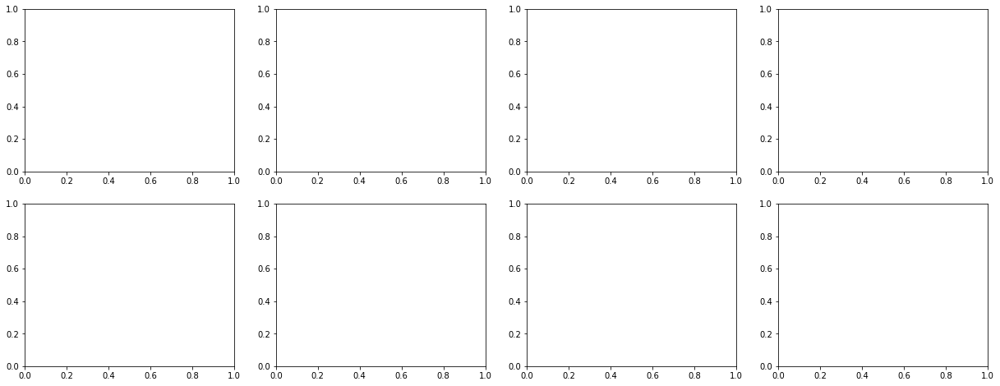

In [1035]:
fig, ax = plt.subplots(2,4, figsize=(21,8))



x=[]
y=[]

for estacao in estacoes:
    y.append(pa[pa['nomeEstacao']==estacao]['2020-08-22']['valorMedida'])
    x.append(pa[pa['nomeEstacao']==estacao]['2020-08-22'].index)
    

ax[0][0].plot(x[0],y[0])
ax[0][1].plot(x[1],y[1])
ax[0][2].plot(x[2],y[2])
ax[0][3].plot(x[3],y[3])
ax[1][0].plot(x[4],y[4])
ax[1][1].plot(x[5],y[5])
ax[1][2].plot(x[6],y[6])
ax[1][3].plot(x[7],y[7])



In [1108]:
textos = []
horario = []
for tweet in chuvas:
    textos.append(tweet.full_text)
    horario.append(tweet.created_at)
textos[0]

'RT @cassioffaial: Em Belém não chega nem a chuva que cai em Ananindeua do que dirá o frio lá do Sul do país.'

In [1115]:
for ind, texto in enumerate(textos[90:100]):
    print(ind, '--', texto)
    print('\n')
    print(horario[ind])
    print('--------------------\n')
    

0 -- RT @cassioffaial: Em Belém não chega nem a chuva que cai em Ananindeua do que dirá o frio lá do Sul do país.


2020-08-22 23:52:33
--------------------

1 -- se essa chuva vier aí mesmo eu durmo agora e vou até amanhã se Deus quiser


2020-08-22 23:50:59
--------------------

2 -- 2° dia seguido que chove aqui

finalmente o mundo tá voltando ao eixo


2020-08-22 23:50:27
--------------------

3 -- Tô indo aqui Ananindeua na casa da mamãe tomar um café e pegar uma chuva já que em Belém não chove


2020-08-22 23:29:19
--------------------

4 -- lá vem a chuva cuns caralho de novo.


2020-08-22 23:20:10
--------------------

5 -- Tudo p gente essa chuva, amo


2020-08-22 23:04:38
--------------------

6 -- Eu quase nunca venho no Novo Horizonte aí quando eu venho, chove -.-


2020-08-22 22:55:31
--------------------

7 -- a chuva que todo mundo pediu


2020-08-22 22:53:32
--------------------

8 -- chove um pouquinho, Belém
uma chuva de uma hora tá ótimo pra mim


2020-08-22 22:49:20

In [1116]:
pa_tweets = [0, 0, 0, 0, 0, 0, 0, 0, 1, 1,
             0, 0, 0, 1, 1, 1, 1, 0, 0, 0,
             0, 0, 1, 0, 1, 0, 0, 0, 1, 0,
             0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 
             1, 1, 1, 1, 1, 1, 1, 1, 0, 0,
             0, 0, 0, 0, 0, 0, 0, 1, 1, 0,
             1, 1, 1, 0, 0, 0, 1, 0, 0, 0,
             0, 1, 0, 0, 0, 0, 1, 1, 0, 0,
             1, 0, 1, 1, 0, 0, 0, 1, 0, 0,
             0, 0, 1, 0, 1, 1, 1, 1, 1, 0 ]

In [1118]:
dic_pa = {'horario':[tweet.created_at - timedelta(hours=3) for tweet in chuvas],
       'local':[tweet.user.location for tweet in chuvas],
       'texto': [tweet.full_text for tweet in chuvas],
       'relevancia':pa_tweets} 

In [1119]:
pa_df = pd.DataFrame(dic_pa)

In [1120]:
pa_df

,horario,local,texto,relevancia
0,2020-08-22 20:52:33,"Belém, Brasil",RT @cassioffaial: Em Belém não chega nem a chu...,0
1,2020-08-22 20:50:59,"Belém, Brasil",RT @cassioffaial: Em Belém não chega nem a chu...,0
2,2020-08-22 20:50:27,"Pará, Brasil",A chuva de hoje foi tão boa❤❤,0
3,2020-08-22 20:29:19,Belém,Ouvindo anunciação e lembrando dele\n\nchove c...,0
4,2020-08-22 20:20:10,"Belém, Brasil",RT @cassioffaial: Em Belém não chega nem a chu...,0
...,...,...,...,...
95,2020-08-22 17:18:42,"Ananindeua, Brasil","Tudo p gente essa chuva, amo",1
96,2020-08-22 17:17:07,"Pará, Brasil",Eu quase nunca venho no Novo Horizonte aí quan...,1
97,2020-08-22 17:14:09,"Pará, Brasil",a chuva que todo mundo pediu,1
98,2020-08-22 17:13:02,Belém do Pará,"chove um pouquinho, Belém\numa chuva de uma ho...",1


In [1121]:
pickle.dump(chuvas, open('chuvas_pa_22-08.p', 'wb'))

In [1122]:
pa_df.to_csv("chuvas_pa_22-08.csv")

#### __Mato Grosso__

In [1123]:
mt = pd.read_csv('dados/MT.csv', sep=';', decimal=',',parse_dates=[6],infer_datetime_format = True,index_col=False)

In [1124]:
mt.head()

,municipio,codEstacao,uf,nomeEstacao,latitude,longitude,datahora,valorMedida
0,CUIABÁ,510340301H,MT,Corrego do Barbado,-56.077172,-15.619291,2020-08-01 00:10:00,0.0
1,CUIABÁ,510340301H,MT,Corrego do Barbado,-56.077172,-15.619291,2020-08-01 01:10:00,0.0
2,CUIABÁ,510340301H,MT,Corrego do Barbado,-56.077172,-15.619291,2020-08-01 02:10:00,0.0
3,CUIABÁ,510340301H,MT,Corrego do Barbado,-56.077172,-15.619291,2020-08-01 03:10:00,0.0
4,CUIABÁ,510340301H,MT,Corrego do Barbado,-56.077172,-15.619291,2020-08-01 04:10:00,0.0


In [1125]:
mt.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 557 entries, 0 to 556
Data columns (total 8 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   municipio    557 non-null    object        
 1   codEstacao   557 non-null    object        
 2   uf           557 non-null    object        
 3   nomeEstacao  557 non-null    object        
 4   latitude     557 non-null    float64       
 5   longitude    557 non-null    float64       
 6   datahora     557 non-null    datetime64[ns]
 7   valorMedida  557 non-null    float64       
dtypes: datetime64[ns](1), float64(3), object(4)
memory usage: 34.9+ KB


In [1126]:
mt.set_index('datahora', inplace=True)
mt.head()

,municipio,codEstacao,uf,nomeEstacao,latitude,longitude,valorMedida
datahora,,,,,,,
2020-08-01 00:10:00,CUIABÁ,510340301H,MT,Corrego do Barbado,-56.077172,-15.619291,0.0
2020-08-01 01:10:00,CUIABÁ,510340301H,MT,Corrego do Barbado,-56.077172,-15.619291,0.0
2020-08-01 02:10:00,CUIABÁ,510340301H,MT,Corrego do Barbado,-56.077172,-15.619291,0.0
2020-08-01 03:10:00,CUIABÁ,510340301H,MT,Corrego do Barbado,-56.077172,-15.619291,0.0
2020-08-01 04:10:00,CUIABÁ,510340301H,MT,Corrego do Barbado,-56.077172,-15.619291,0.0


In [1127]:
mt.groupby('nomeEstacao')['latitude'].unique()

nomeEstacao
Corrego do Barbado    [-56.077172]
Name: latitude, dtype: object

In [1128]:
mt.groupby('nomeEstacao')['longitude'].unique()

nomeEstacao
Corrego do Barbado    [-15.619291]
Name: longitude, dtype: object

In [1129]:
lat = mt.groupby('nomeEstacao')['latitude'].unique().astype(float)
lon = mt.groupby('nomeEstacao')['longitude'].unique().astype(float)

In [1130]:
lat

nomeEstacao
Corrego do Barbado   -56.077172
Name: latitude, dtype: float64

In [1131]:
lon

nomeEstacao
Corrego do Barbado   -15.619291
Name: longitude, dtype: float64

In [1132]:
coordenadasMT= pd.DataFrame([lat, lon]).T

In [1133]:
coordenadasMT

,latitude,longitude
nomeEstacao,,
Corrego do Barbado,-56.077172,-15.619291


In [1134]:
estacoes = mt['nomeEstacao'].unique()
len(estacoes)

1

In [1135]:
MatoGrosso = 'dados/geojson/MT.json'
latitudeMT = -15.5989
longitudeMT = -56.0949
raio = 10


centro = [latitudeMT,longitudeMT]
mapa = folium.Map(
    location = centro,
    zoom_start=11
)

folium.GeoJson(
    MatoGrosso,
    name='geojson'
).add_to(mapa)


folium.Circle(
    radius=raio*1000,
    location=centro,
    popup='Centro',
    color='crimson',
    fill=False,
).add_to(mapa)

for index, row in coordenadasMT.iterrows():
    folium.Marker(
        location=[row['longitude'], row['latitude']],
        popup=index,
    ).add_to(mapa)


mapa

In [1136]:
geocodeStr = '{},{},{}km'.format(latitudeMT, longitudeMT, raio)
geocodeStr

'-15.5989,-56.0949,10km'

In [1137]:
chuvas = api.search(q = 'chuva OR enchente OR chuvendo OR chove OR chuvas',
                    geocode = geocodeStr, 
                    count = 101,
                    tweet_mode = 'extended',
                    until = '2020-08-23')

In [1138]:
len(chuvas)

100

In [1139]:
[print(tweet.full_text) for tweet in chuvas]

RT @henricre: @bofumaporro so fumo maconha quando chove e quando nao chove
@bofumaporro so fumo maconha quando chove e quando nao chove
bolinho de chuva eh tão bom
eu no carnaval proucurando a leticia na porra da chuva https://t.co/oouY2V0GT7
Meu pai tá tão enjoado de fica em casa que na chuva ele quer ir pra casa de praia só pra ir em algum lugar diferente kkkk que ponto ele chegou
@vanifior Exatamente, as vezes armo o Black aí na primeira sacudida começa a chuva de cabelos.
@mari_fonseca Esse lance de “fingir costume” é pra gente chata! Recebi um primo gringo que morou a vida toda na Califórnia. Chegou aqui e viu chuva com raios e trovões, parecia uma criança! Deixa o povo ser feliz oras..
@JanjaLula Em Cuiabá-MT, sequidão. Depois de calor intenso, 40°, chegou um frio gelado. Deu uma garoa só, sem chuva. Agora 12°.
que nojo mlk o pé descalço na chuva sabe o cabelo seboso a roupa feia ah naooo n tem condições direitistas não são GENTE
tinha q ser estadunidense trump fã pra fazer uma p

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

In [1140]:
[print(tweet.created_at) for tweet in chuvas]

2020-08-22 23:59:17
2020-08-22 22:00:24
2020-08-22 19:48:14
2020-08-22 17:05:26
2020-08-22 16:22:26
2020-08-22 15:00:18
2020-08-22 14:49:05
2020-08-22 12:45:08
2020-08-22 06:55:14
2020-08-22 06:51:35
2020-08-22 05:40:25
2020-08-22 05:40:10
2020-08-22 05:12:46
2020-08-22 02:56:31
2020-08-21 23:43:05
2020-08-21 21:28:18
2020-08-21 21:23:26
2020-08-21 21:00:10
2020-08-21 20:15:48
2020-08-21 18:41:13
2020-08-21 18:00:08
2020-08-21 17:46:40
2020-08-21 17:45:20
2020-08-21 17:41:21
2020-08-21 17:40:46
2020-08-21 17:21:11
2020-08-21 14:52:52
2020-08-21 14:50:35
2020-08-21 14:19:51
2020-08-21 14:19:03
2020-08-21 14:16:51
2020-08-21 14:07:13
2020-08-21 13:38:06
2020-08-21 13:27:10
2020-08-21 13:27:08
2020-08-21 13:04:16
2020-08-21 12:46:56
2020-08-21 12:40:49
2020-08-21 12:23:06
2020-08-21 12:09:21
2020-08-21 11:49:19
2020-08-21 11:17:30
2020-08-21 11:13:28
2020-08-21 11:09:41
2020-08-21 10:11:41
2020-08-21 09:41:31
2020-08-21 09:39:08
2020-08-21 09:37:10
2020-08-21 08:00:32
2020-08-21 07:34:16


[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

In [1150]:
mt['2020-08-20':'2020-08-22'].resample('D').max()['valorMedida']

datahora
2020-08-20    0.0
2020-08-21    0.2
2020-08-22    0.0
Freq: D, Name: valorMedida, dtype: float64

In [351]:
#estacoes = al['nomeEstacao'].unique()
#d = np.where(estacoes=='Ipioca')
#d

(array([6]),)

In [1142]:
#estacoes = np.delete(estacoes, d)
estacoes

array(['Corrego do Barbado'], dtype=object)

In [1143]:
len(estacoes)

1

In [1149]:
y

datahora
2020-08-22 00:10:00    0.0
2020-08-22 01:10:00    0.0
2020-08-22 02:10:00    0.0
2020-08-22 03:10:00    0.0
2020-08-22 04:10:00    0.0
2020-08-22 05:10:00    0.0
2020-08-22 06:10:00    0.0
2020-08-22 07:10:00    0.0
2020-08-22 08:10:00    0.0
2020-08-22 09:10:00    0.0
2020-08-22 10:10:00    0.0
2020-08-22 11:10:00    0.0
2020-08-22 12:10:00    0.0
2020-08-22 13:10:00    0.0
2020-08-22 14:10:00    0.0
2020-08-22 15:10:00    0.0
2020-08-22 16:10:00    0.0
2020-08-22 17:10:00    0.0
2020-08-22 18:10:00    0.0
2020-08-22 19:10:00    0.0
2020-08-22 20:10:00    0.0
2020-08-22 21:10:00    0.0
2020-08-22 22:10:00    0.0
2020-08-22 23:10:00    0.0
Name: valorMedida, dtype: float64

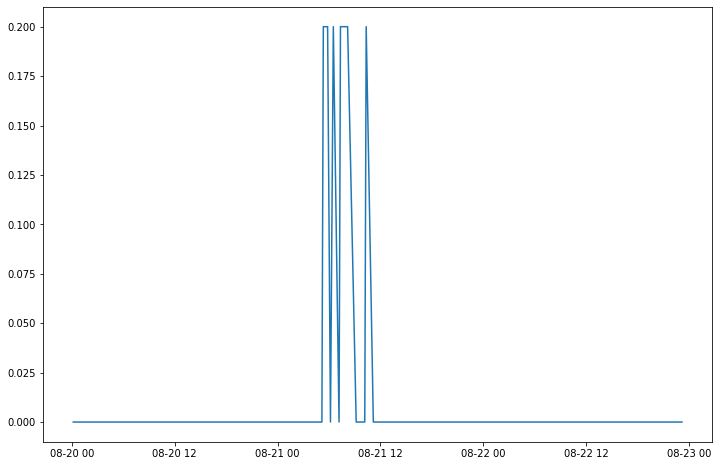

In [1151]:
#fig, ax = plt.subplots(2,4, figsize=(21,8))

y = mt['2020-08-20':'2020-08-22']['valorMedida']
x = mt['2020-08-20':'2020-08-22'].index
    
plt.figure(figsize = (12,8))
plt.plot(x,y)

In [1156]:
textos = []
horario = []
for tweet in chuvas:
    textos.append(tweet.full_text)
    horario.append(tweet.created_at - timedelta(hours=3))
textos[5]

'@vanifior Exatamente, as vezes armo o Black aí na primeira sacudida começa a chuva de cabelos.'

In [1157]:
for ind, texto in enumerate(textos):
    print(ind, '--', texto)
    print('\n')
    print(horario[ind])
    print('--------------------\n')
    

0 -- RT @henricre: @bofumaporro so fumo maconha quando chove e quando nao chove


2020-08-22 20:59:17
--------------------

1 -- @bofumaporro so fumo maconha quando chove e quando nao chove


2020-08-22 19:00:24
--------------------

2 -- bolinho de chuva eh tão bom


2020-08-22 16:48:14
--------------------

3 -- eu no carnaval proucurando a leticia na porra da chuva https://t.co/oouY2V0GT7


2020-08-22 14:05:26
--------------------

4 -- Meu pai tá tão enjoado de fica em casa que na chuva ele quer ir pra casa de praia só pra ir em algum lugar diferente kkkk que ponto ele chegou


2020-08-22 13:22:26
--------------------

5 -- @vanifior Exatamente, as vezes armo o Black aí na primeira sacudida começa a chuva de cabelos.


2020-08-22 12:00:18
--------------------

6 -- @mari_fonseca Esse lance de “fingir costume” é pra gente chata! Recebi um primo gringo que morou a vida toda na Califórnia. Chegou aqui e viu chuva com raios e trovões, parecia uma criança! Deixa o povo ser feliz oras..


In [1158]:
mt_tweets = [0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
             0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
             0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
             0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
             0, 0, 0, 0, 1, 1, 0, 0, 1, 1,
             1, 1, 1, 1, 1, 0, 1, 0, 1, 1,
             1, 1, 1, 1, 0, 0, 0, 0, 0, 0,
             0, 1, 0, 0, 0, 0, 0, 0, 0, 0,
             0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
             1, 0, 0, 0, 0, 0, 0, 0, 0, 0,]

In [1159]:
dic_mt = {'horario':[tweet.created_at - timedelta(hours=3) for tweet in chuvas],
       'local':[tweet.user.location for tweet in chuvas],
       'texto': [tweet.full_text for tweet in chuvas],
       'relevancia':mt_tweets} 

In [1160]:
mt_df = pd.DataFrame(dic_mt)

In [1161]:
mt_df

,horario,local,texto,relevancia
0,2020-08-22 20:59:17,"Cuiabá, Brasil",RT @henricre: @bofumaporro so fumo maconha qua...,0
1,2020-08-22 19:00:24,"Cuiabá, Brasil",@bofumaporro so fumo maconha quando chove e qu...,0
2,2020-08-22 16:48:14,"Cuiabá, Brasil",bolinho de chuva eh tão bom,0
3,2020-08-22 14:05:26,"Cuiabá, Brasil",eu no carnaval proucurando a leticia na porra ...,0
4,2020-08-22 13:22:26,"Cuiabá, Brasil",Meu pai tá tão enjoado de fica em casa que na ...,0
...,...,...,...,...
95,2020-08-20 13:08:47,"Cuiabá, Brasil",Deus se vc n tiver desistido da gente ainda po...,0
96,2020-08-20 13:07:24,Cuiabá-MT,@Angy_Chuva Muito bom continue assim,0
97,2020-08-20 13:06:33,Cuiabá,@carolaraujj triste... e a chuva nem vingou 😔,0
98,2020-08-20 13:01:34,Mato,"RT @madeforbrazil: em cuiabá, essa semana cons...",0


In [1162]:
pickle.dump(chuvas, open('chuvas_mt_2022-08.p', 'wb'))

In [1163]:
mt_df.to_csv("chuvas_mt_2022-08.csv")

#### __Paraná__

In [1213]:
pr = pd.read_csv('dados/PR.csv', sep=';', decimal=',',parse_dates=[6],infer_datetime_format = True,index_col=False)

In [1214]:
pr.head()

,municipio,codEstacao,uf,nomeEstacao,latitude,longitude,datahora,valorMedida
0,CURITIBA,410690201A,PR,Butiatuvinha,-49.36184,-25.41118,2020-08-01 00:40:00,0.0
1,CURITIBA,410690201A,PR,Butiatuvinha,-49.36184,-25.41118,2020-08-01 01:40:00,0.0
2,CURITIBA,410690201A,PR,Butiatuvinha,-49.36184,-25.41118,2020-08-01 02:40:00,0.0
3,CURITIBA,410690201A,PR,Butiatuvinha,-49.36184,-25.41118,2020-08-01 03:40:00,0.0
4,CURITIBA,410690201A,PR,Butiatuvinha,-49.36184,-25.41118,2020-08-01 04:40:00,0.0


In [1215]:
pr.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7921 entries, 0 to 7920
Data columns (total 8 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   municipio    7921 non-null   object        
 1   codEstacao   7921 non-null   object        
 2   uf           7921 non-null   object        
 3   nomeEstacao  7921 non-null   object        
 4   latitude     7921 non-null   float64       
 5   longitude    7921 non-null   float64       
 6   datahora     7921 non-null   datetime64[ns]
 7   valorMedida  7921 non-null   float64       
dtypes: datetime64[ns](1), float64(3), object(4)
memory usage: 495.2+ KB


In [1216]:
pr.set_index('datahora', inplace=True)
pr.head()

,municipio,codEstacao,uf,nomeEstacao,latitude,longitude,valorMedida
datahora,,,,,,,
2020-08-01 00:40:00,CURITIBA,410690201A,PR,Butiatuvinha,-49.36184,-25.41118,0.0
2020-08-01 01:40:00,CURITIBA,410690201A,PR,Butiatuvinha,-49.36184,-25.41118,0.0
2020-08-01 02:40:00,CURITIBA,410690201A,PR,Butiatuvinha,-49.36184,-25.41118,0.0
2020-08-01 03:40:00,CURITIBA,410690201A,PR,Butiatuvinha,-49.36184,-25.41118,0.0
2020-08-01 04:40:00,CURITIBA,410690201A,PR,Butiatuvinha,-49.36184,-25.41118,0.0


In [1217]:
pr.groupby('nomeEstacao')['latitude'].unique()

nomeEstacao
Atuba               [-49.196999999999996]
Boa Vista                       [-49.245]
Butiatuvinha                  [-49.36184]
Cachoeira                     [-49.25527]
Pilarzinho                      [-49.295]
Santa Felicidade        [-49.332, -49.35]
São Braz                        [-49.342]
Umbará                          [-49.284]
Vista Alegre                    [-49.301]
Name: latitude, dtype: object

In [1218]:
pr.groupby('nomeEstacao')['longitude'].unique()

nomeEstacao
Atuba                                    [-25.384]
Boa Vista                                [-25.379]
Butiatuvinha                 [-25.411179999999998]
Cachoeira                               [-25.3536]
Pilarzinho                                [-25.38]
Santa Felicidade    [-25.381999999999998, -25.435]
São Braz                     [-25.416999999999998]
Umbará                                   [-25.555]
Vista Alegre                             [-25.413]
Name: longitude, dtype: object

In [1221]:
lat = pr.groupby('nomeEstacao')['latitude'].unique().astype(float)
lon = pr.groupby('nomeEstacao')['longitude'].unique().astype(float)

ValueError: setting an array element with a sequence.

In [1224]:
mediaLat = pr[pr['nomeEstacao']=='Santa Felicidade']['latitude'].mean() 
mediaLon = pr[pr['nomeEstacao']=='Santa Felicidade']['longitude'].mean() 

In [1225]:
mediaLat

-49.339425485960774

In [1226]:
pr2 = pr.reset_index()
pr2.head()

,datahora,municipio,codEstacao,uf,nomeEstacao,latitude,longitude,valorMedida
0,2020-08-01 00:40:00,CURITIBA,410690201A,PR,Butiatuvinha,-49.36184,-25.41118,0.0
1,2020-08-01 01:40:00,CURITIBA,410690201A,PR,Butiatuvinha,-49.36184,-25.41118,0.0
2,2020-08-01 02:40:00,CURITIBA,410690201A,PR,Butiatuvinha,-49.36184,-25.41118,0.0
3,2020-08-01 03:40:00,CURITIBA,410690201A,PR,Butiatuvinha,-49.36184,-25.41118,0.0
4,2020-08-01 04:40:00,CURITIBA,410690201A,PR,Butiatuvinha,-49.36184,-25.41118,0.0


In [1227]:
ind=pr2[pr2['nomeEstacao']=='Santa Felicidade'].index

In [1228]:
pr2.loc[ind,'latitude'] = mediaLat
pr2.loc[ind,'longitude'] = mediaLon

In [1229]:
pe2.groupby('nomeEstacao')['latitude'].unique()

nomeEstacao
Alto Bela Vista            [-34.941528000000005]
Alto Mandu                             [-34.927]
Alto do Céu                [-34.891999999999996]
Areias                                 [-34.929]
Barreira                            [-34.964622]
Boa Vista                              [-34.891]
Brega e Chique                      [-34.979298]
Campina do Barreto                     [-34.881]
Corrego Jenipapo                       [-34.936]
Dois Irmãos                         [-34.947058]
Dois Unidos                         [-34.909167]
Ibura                                  [-34.955]
Imbiribeira                         [-34.913983]
Lagoa Encantada - COHAB             [-34.950142]
Morro da Conceição                     [-34.915]
Nova Descoberta            [-34.926346022819615]
Pina                                   [-34.887]
Porto                      [-34.873000000000005]
RECIFE - APAC                        [-34.87518]
San Martin                             [-34.925]
Torreão 

In [1230]:
pr2.set_index('datahora', inplace=True)

In [1231]:
lat = pr2.groupby('nomeEstacao')['latitude'].unique().astype(float)
lon = pr2.groupby('nomeEstacao')['longitude'].unique().astype(float)

In [1232]:
lat

nomeEstacao
Atuba              -49.197000
Boa Vista          -49.245000
Butiatuvinha       -49.361840
Cachoeira          -49.255270
Pilarzinho         -49.295000
Santa Felicidade   -49.339425
São Braz           -49.342000
Umbará             -49.284000
Vista Alegre       -49.301000
Name: latitude, dtype: float64

In [1233]:
lon

nomeEstacao
Atuba              -25.384000
Boa Vista          -25.379000
Butiatuvinha       -25.411180
Cachoeira          -25.353600
Pilarzinho         -25.380000
Santa Felicidade   -25.403864
São Braz           -25.417000
Umbará             -25.555000
Vista Alegre       -25.413000
Name: longitude, dtype: float64

In [1234]:
coordenadasPR= pd.DataFrame([lat, lon]).T

In [1235]:
coordenadasPR

,latitude,longitude
nomeEstacao,,
Atuba,-49.197000,-25.384000
Boa Vista,-49.245000,-25.379000
Butiatuvinha,-49.361840,-25.411180
Cachoeira,-49.255270,-25.353600
Pilarzinho,-49.295000,-25.380000
Santa Felicidade,-49.339425,-25.403864
São Braz,-49.342000,-25.417000
Umbará,-49.284000,-25.555000
Vista Alegre,-49.301000,-25.413000


In [1236]:
estacoes = pr['nomeEstacao'].unique()
len(estacoes)

9

In [1237]:
Parana = 'dados/geojson/PR.json'
latitudePR =  -25.4284
longitudePR = -49.2733 
raio = 18


centro = [latitudePR,longitudePR]
mapa = folium.Map(
    location = centro,
    zoom_start=11
)

folium.GeoJson(
    Parana,
    name='geojson'
).add_to(mapa)


folium.Circle(
    radius=raio*1000,
    location=centro,
    popup='Centro',
    color='crimson',
    fill=False,
).add_to(mapa)

for index, row in coordenadasPR.iterrows():
    folium.Marker(
        location=[row['longitude'], row['latitude']],
        popup=index,
    ).add_to(mapa)


mapa

In [1238]:
geocodeStr = '{},{},{}km'.format(latitudePR, longitudePR, raio)
geocodeStr

'-25.4284,-49.2733,18km'

In [1239]:
chuvas = api.search(q = 'chuva OR enchente OR chuvendo OR chove OR chuvas',
                    geocode = geocodeStr, 
                    count = 101,
                    tweet_mode = 'extended',
                    until = '2020-08-23')

In [1240]:
len(chuvas)

100

In [1242]:
[print(tweet.full_text) for tweet in chuvas]

na tour do ciano 10 anos ficou eu a jana e o wagner mais de 2h na chuva, se o show n tivesse sido tão bom eu teria trauma desse dia
@elaynebaeta Bolsa de água quente no pé e se vc tiver dinheiro compra um aquecedor elétrico pequeno (mas cuidado com a conta de luz) 
Independente da temperatura, leve um guarda chuva e um casaco na bolsa. 
Compre chá em casa de produto natural e se embebede
@Henriquetsin_ com 4 anos eu tinha medo de chuva mano
@detailsawae Eu pelo menos não tô dizendo pra uma pessoa que tá em extremo sofrimento a ponto de querer tirar a própria vida pra ela ficar viva pra sentir a chuva mais uma vez ao invés de orientar a procurar ajuda profissional pra poder realmente ser ajudada

tem depressão? se cure! 😍
pelo amor de deus hj fazendo bolinho de chuva a panela de oleo explodiu em mim e na minha cara, nao sei como mas eu nao me queimei 
??? mds 
descobrimos q era pq a panela n foi bem seca antes de colocar oleo
@CBNCuritiba #fiqueemcasa semana com chuva e frio, o históric

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

In [1243]:
[print(tweet.created_at) for tweet in chuvas]

2020-08-22 23:26:22
2020-08-22 23:20:15
2020-08-22 23:19:06
2020-08-22 23:16:17
2020-08-22 23:00:30
2020-08-22 22:59:13
2020-08-22 22:58:38
2020-08-22 22:58:03
2020-08-22 22:31:03
2020-08-22 22:29:46
2020-08-22 22:20:48
2020-08-22 22:14:50
2020-08-22 22:13:14
2020-08-22 21:57:56
2020-08-22 21:51:48
2020-08-22 21:49:24
2020-08-22 21:32:24
2020-08-22 21:30:29
2020-08-22 21:25:24
2020-08-22 21:19:03
2020-08-22 21:06:45
2020-08-22 20:33:12
2020-08-22 20:11:34
2020-08-22 20:09:05
2020-08-22 20:07:16
2020-08-22 20:02:08
2020-08-22 20:01:10
2020-08-22 19:47:12
2020-08-22 19:39:29
2020-08-22 19:17:57
2020-08-22 18:59:51
2020-08-22 18:58:14
2020-08-22 18:48:09
2020-08-22 18:47:55
2020-08-22 18:33:34
2020-08-22 18:22:48
2020-08-22 18:11:55
2020-08-22 18:03:32
2020-08-22 18:01:52
2020-08-22 18:01:08
2020-08-22 17:52:47
2020-08-22 17:51:26
2020-08-22 17:47:12
2020-08-22 17:34:58
2020-08-22 17:32:22
2020-08-22 17:31:06
2020-08-22 17:30:10
2020-08-22 17:07:18
2020-08-22 16:37:44
2020-08-22 16:29:10


[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

In [1244]:
pr['2020-08-22'].groupby('nomeEstacao').resample('D').max()['valorMedida']

nomeEstacao       datahora  
Atuba             2020-08-22    0.0
Boa Vista         2020-08-22    0.2
Butiatuvinha      2020-08-22    0.0
Cachoeira         2020-08-22    0.0
Pilarzinho        2020-08-22    0.0
Santa Felicidade  2020-08-22    0.2
São Braz          2020-08-22    0.0
Umbará            2020-08-22    0.2
Vista Alegre      2020-08-22    0.0
Name: valorMedida, dtype: float64

In [351]:
#estacoes = al['nomeEstacao'].unique()
#d = np.where(estacoes=='Ipioca')
#d

(array([6]),)

In [1245]:
#estacoes = np.delete(estacoes, d)
estacoes

array(['Butiatuvinha', 'Cachoeira', 'Vista Alegre', 'Pilarzinho',
       'Boa Vista', 'Santa Felicidade', 'São Braz', 'Atuba', 'Umbará'],
      dtype=object)

In [1246]:
len(estacoes)

9

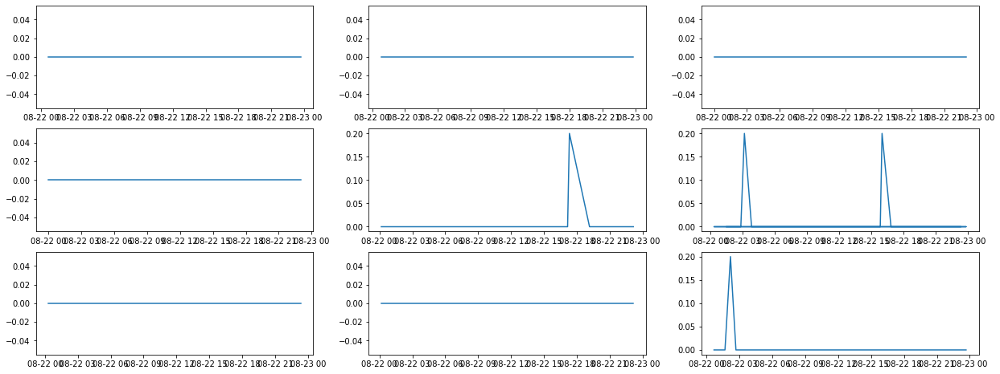

In [1247]:
fig, ax = plt.subplots(3,3, figsize=(21,8))



x=[]
y=[]

for estacao in estacoes:
    y.append(pr[pr['nomeEstacao']==estacao]['2020-08-22']['valorMedida'])
    x.append(pr[pr['nomeEstacao']==estacao]['2020-08-22'].index)
    

ax[0][0].plot(x[0],y[0])
ax[0][1].plot(x[1],y[1])
ax[0][2].plot(x[2],y[2])
ax[1][0].plot(x[3],y[3])
ax[1][1].plot(x[4],y[4])
ax[1][2].plot(x[5],y[5])
ax[2][0].plot(x[6],y[6])
ax[2][1].plot(x[7],y[7])
ax[2][2].plot(x[8],y[8])




In [1249]:
textos = []
horario = []
for tweet in chuvas:
    textos.append(tweet.full_text)
    horario.append(tweet.created_at  - timedelta(hours=3))
textos[5]

'@CBNCuritiba #fiqueemcasa semana com chuva e frio, o histórico mostra que saberemos em 14 dias o que virá.  @Curitiba_PMC @Rafael_Greca'

In [1250]:
for ind, texto in enumerate(textos):
    print(ind, '--', texto)
    print('\n')
    print(horario[ind])
    print('--------------------\n')
    

0 -- na tour do ciano 10 anos ficou eu a jana e o wagner mais de 2h na chuva, se o show n tivesse sido tão bom eu teria trauma desse dia


2020-08-22 20:26:22
--------------------

1 -- @elaynebaeta Bolsa de água quente no pé e se vc tiver dinheiro compra um aquecedor elétrico pequeno (mas cuidado com a conta de luz) 
Independente da temperatura, leve um guarda chuva e um casaco na bolsa. 
Compre chá em casa de produto natural e se embebede


2020-08-22 20:20:15
--------------------

2 -- @Henriquetsin_ com 4 anos eu tinha medo de chuva mano


2020-08-22 20:19:06
--------------------

3 -- @detailsawae Eu pelo menos não tô dizendo pra uma pessoa que tá em extremo sofrimento a ponto de querer tirar a própria vida pra ela ficar viva pra sentir a chuva mais uma vez ao invés de orientar a procurar ajuda profissional pra poder realmente ser ajudada

tem depressão? se cure! 😍


2020-08-22 20:16:17
--------------------

4 -- pelo amor de deus hj fazendo bolinho de chuva a panela de oleo explo

In [1251]:
pr_tweets = [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 
             0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 
             0, 0, 0, 0, 0, 0, 1, 0, 0, 0,
             0, 0, 0, 0, 0, 0, 0, 0, 1, 0,
             0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
             0, 0, 0, 0, 0, 0, 0, 0, 1, 0,
             0, 0, 0, 0, 0, 0 ,0, 0, 0, 0,
             0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
             0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
             0, 0, 0, 0, 0, 0, 0, 0, 0, 0,]

In [1252]:
dic_pr = {'horario':[tweet.created_at - timedelta(hours=3) for tweet in chuvas],
       'local':[tweet.user.location for tweet in chuvas],
       'texto': [tweet.full_text for tweet in chuvas],
       'relevancia':pr_tweets} 

In [1253]:
pr_df = pd.DataFrame(dic_pa)

In [1254]:
pr_df

,horario,local,texto,relevancia
0,2020-08-22 20:52:33,"Belém, Brasil",RT @cassioffaial: Em Belém não chega nem a chu...,0
1,2020-08-22 20:50:59,"Belém, Brasil",RT @cassioffaial: Em Belém não chega nem a chu...,0
2,2020-08-22 20:50:27,"Pará, Brasil",A chuva de hoje foi tão boa❤❤,0
3,2020-08-22 20:29:19,Belém,Ouvindo anunciação e lembrando dele\n\nchove c...,0
4,2020-08-22 20:20:10,"Belém, Brasil",RT @cassioffaial: Em Belém não chega nem a chu...,0
...,...,...,...,...
95,2020-08-22 17:18:42,"Ananindeua, Brasil","Tudo p gente essa chuva, amo",1
96,2020-08-22 17:17:07,"Pará, Brasil",Eu quase nunca venho no Novo Horizonte aí quan...,1
97,2020-08-22 17:14:09,"Pará, Brasil",a chuva que todo mundo pediu,1
98,2020-08-22 17:13:02,Belém do Pará,"chove um pouquinho, Belém\numa chuva de uma ho...",1


In [1255]:
pickle.dump(chuvas, open('chuvas_pr_22-08.p', 'wb'))

In [1256]:
pr_df.to_csv("chuvas_pr_22-08.csv")

#### __Rio Grande do Sul__

In [1257]:
rs = pd.read_csv('dados/RS.csv', sep=';', decimal=',',parse_dates=[6],infer_datetime_format = True,index_col=False)

In [1258]:
rs.head()

,municipio,codEstacao,uf,nomeEstacao,latitude,longitude,datahora,valorMedida
0,PORTO ALEGRE,431490201A,RS,Centro,-51.228,-30.029,2020-08-01 00:40:00,0.0
1,PORTO ALEGRE,431490201A,RS,Centro,-51.228,-30.029,2020-08-01 01:40:00,0.0
2,PORTO ALEGRE,431490201A,RS,Centro,-51.228,-30.029,2020-08-01 02:40:00,0.0
3,PORTO ALEGRE,431490201A,RS,Centro,-51.228,-30.029,2020-08-01 03:30:00,0.2
4,PORTO ALEGRE,431490201A,RS,Centro,-51.228,-30.029,2020-08-01 03:40:00,0.0


In [1259]:
rs.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7529 entries, 0 to 7528
Data columns (total 8 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   municipio    7529 non-null   object        
 1   codEstacao   7529 non-null   object        
 2   uf           7529 non-null   object        
 3   nomeEstacao  7529 non-null   object        
 4   latitude     7529 non-null   float64       
 5   longitude    7529 non-null   float64       
 6   datahora     7529 non-null   datetime64[ns]
 7   valorMedida  7529 non-null   float64       
dtypes: datetime64[ns](1), float64(3), object(4)
memory usage: 470.7+ KB


In [1260]:
rs.set_index('datahora', inplace=True)
rs.head()

,municipio,codEstacao,uf,nomeEstacao,latitude,longitude,valorMedida
datahora,,,,,,,
2020-08-01 00:40:00,PORTO ALEGRE,431490201A,RS,Centro,-51.228,-30.029,0.0
2020-08-01 01:40:00,PORTO ALEGRE,431490201A,RS,Centro,-51.228,-30.029,0.0
2020-08-01 02:40:00,PORTO ALEGRE,431490201A,RS,Centro,-51.228,-30.029,0.0
2020-08-01 03:30:00,PORTO ALEGRE,431490201A,RS,Centro,-51.228,-30.029,0.2
2020-08-01 03:40:00,PORTO ALEGRE,431490201A,RS,Centro,-51.228,-30.029,0.0


In [1261]:
rs.groupby('nomeEstacao')['latitude'].unique()

nomeEstacao
Agronomia                     [-51.143]
Belm Velho         [-51.17100000000001]
Centro                        [-51.228]
Cidade Baixa                [-51.22765]
Cristal                     [-51.11248]
Hipica                          [-51.2]
Navegantes                    [-51.202]
Partenon                      [-51.195]
Prot sio Alves                [-51.136]
Restinga          [-51.138000000000005]
Serraria                      [-51.228]
São João                      [-51.157]
Name: latitude, dtype: object

In [1262]:
rs.groupby('nomeEstacao')['longitude'].unique()

nomeEstacao
Agronomia         [-30.069000000000003]
Belm Velho                    [-30.104]
Centro                        [-30.029]
Cidade Baixa                [-30.03932]
Cristal           [-30.111420000000003]
Hipica            [-30.159000000000002]
Navegantes                    [-30.002]
Partenon                      [-30.051]
Prot sio Alves    [-30.048000000000002]
Restinga                      [-30.151]
Serraria                      [-30.164]
São João                      [-29.986]
Name: longitude, dtype: object

In [1263]:
lat = rs.groupby('nomeEstacao')['latitude'].unique().astype(float)
lon = rs.groupby('nomeEstacao')['longitude'].unique().astype(float)

In [1264]:
lat

nomeEstacao
Agronomia        -51.14300
Belm Velho       -51.17100
Centro           -51.22800
Cidade Baixa     -51.22765
Cristal          -51.11248
Hipica           -51.20000
Navegantes       -51.20200
Partenon         -51.19500
Prot sio Alves   -51.13600
Restinga         -51.13800
Serraria         -51.22800
São João         -51.15700
Name: latitude, dtype: float64

In [1265]:
lon

nomeEstacao
Agronomia        -30.06900
Belm Velho       -30.10400
Centro           -30.02900
Cidade Baixa     -30.03932
Cristal          -30.11142
Hipica           -30.15900
Navegantes       -30.00200
Partenon         -30.05100
Prot sio Alves   -30.04800
Restinga         -30.15100
Serraria         -30.16400
São João         -29.98600
Name: longitude, dtype: float64

In [1266]:
coordenadasRS= pd.DataFrame([lat, lon]).T

In [1267]:
coordenadasRS

,latitude,longitude
nomeEstacao,,
Agronomia,-51.14300,-30.06900
Belm Velho,-51.17100,-30.10400
Centro,-51.22800,-30.02900
Cidade Baixa,-51.22765,-30.03932
Cristal,-51.11248,-30.11142
Hipica,-51.20000,-30.15900
Navegantes,-51.20200,-30.00200
Partenon,-51.19500,-30.05100
Prot sio Alves,-51.13600,-30.04800


In [1268]:
estacoes = rs['nomeEstacao'].unique()
len(estacoes)

12

In [1269]:
RioGrandeDoSul = 'dados/geojson/RS.json'
latitudeRS = -30.0277
longitudeRS = -51.2287 
raio = 18


centro = [latitudeRS,longitudeRS]
mapa = folium.Map(
    location = centro,
    zoom_start=11
)

folium.GeoJson(
    RioGrandeDoSul,
    name='geojson'
).add_to(mapa)


folium.Circle(
    radius=raio*1000,
    location=centro,
    popup='Centro',
    color='crimson',
    fill=False,
).add_to(mapa)

for index, row in coordenadasRS.iterrows():
    folium.Marker(
        location=[row['longitude'], row['latitude']],
        popup=index,
    ).add_to(mapa)


mapa

In [1270]:
geocodeStr = '{},{},{}km'.format(latitudeRS, longitudeRS, raio)
geocodeStr

'-30.0277,-51.2287,18km'

In [1288]:
chuvas = api.search(q = 'chuva OR enchente OR chuvendo OR chove OR chuvas',
                    geocode = geocodeStr, 
                    count = 101,
                    tweet_mode = 'extended',
                    until = '2020-08-20')

In [1289]:
len(chuvas)

87

In [1290]:
[print(tweet.full_text) for tweet in chuvas]

Dia nublado pós chuva &gt;&gt;&gt;&gt;&gt; https://t.co/ddCV9lgGqO
Mas eu sinto que eu 'to viva
A cada banho de chuva que chega molhando meu corpo nu
RT @amarelito: não vou ficar pra chuva n

abs https://t.co/OkN6L8VbpN
RT @amarelito: não vou ficar pra chuva n

abs https://t.co/OkN6L8VbpN
RT @amarelito: não vou ficar pra chuva n

abs https://t.co/OkN6L8VbpN
@Kerberosgmg @ClaroBrasil Ontem caiu o mundo de chuva em Porto Alegre e o serviço continuou. Hoje, que tava ensolarado, estava sem internet e agora fica mais caindo do que voltando. 

Só quero dar minha aulinha remota Brasil 🥺
Minha fotinho pós natação rendeu hein chuva de reply
RT @c_isabelaa: saudades churrascada na panatlântica ano passado, banho de chuva, caímos no lago, voleizinho e fut a tarde toda, eu tava co…
RT @amarelito: não vou ficar pra chuva n

abs https://t.co/OkN6L8VbpN
Um dia nós se encontra, um altar e chuva de arroz
RT @amarelito: não vou ficar pra chuva n

abs https://t.co/OkN6L8VbpN
RT @amarelito: não vou ficar 

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

In [1291]:
[print(tweet.created_at) for tweet in chuvas]

2020-08-19 23:27:45
2020-08-19 23:27:07
2020-08-19 23:09:03
2020-08-19 22:28:23
2020-08-19 22:27:26
2020-08-19 22:22:51
2020-08-19 22:14:31
2020-08-19 22:11:25
2020-08-19 22:10:28
2020-08-19 22:10:25
2020-08-19 22:09:50
2020-08-19 22:09:20
2020-08-19 22:03:17
2020-08-19 22:00:35
2020-08-19 21:53:51
2020-08-19 21:37:30
2020-08-19 21:37:20
2020-08-19 21:36:18
2020-08-19 21:27:27
2020-08-19 21:25:37
2020-08-19 21:24:56
2020-08-19 21:24:09
2020-08-19 21:24:05
2020-08-19 21:23:33
2020-08-19 21:21:22
2020-08-19 21:21:15
2020-08-19 21:20:58
2020-08-19 21:20:14
2020-08-19 21:19:48
2020-08-19 21:13:18
2020-08-19 21:11:48
2020-08-19 21:08:30
2020-08-19 20:53:23
2020-08-19 20:53:18
2020-08-19 20:51:16
2020-08-19 20:48:07
2020-08-19 20:44:10
2020-08-19 20:42:06
2020-08-19 20:26:32
2020-08-19 19:55:56
2020-08-19 19:53:31
2020-08-19 19:43:26
2020-08-19 19:37:59
2020-08-19 19:37:56
2020-08-19 19:32:44
2020-08-19 19:20:00
2020-08-19 19:05:56
2020-08-19 18:58:14
2020-08-19 18:55:14
2020-08-19 18:52:16


[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

In [1292]:
rs['2020-08-19'].groupby('nomeEstacao').resample('D').max()['valorMedida']

nomeEstacao     datahora  
Agronomia       2020-08-19    0.00
Belm Velho      2020-08-19    0.79
Centro          2020-08-19    0.20
Cidade Baixa    2020-08-19    0.59
Cristal         2020-08-19    0.60
Hipica          2020-08-19    0.39
Navegantes      2020-08-19    0.20
Partenon        2020-08-19    0.59
Prot sio Alves  2020-08-19    0.20
Restinga        2020-08-19    1.77
Serraria        2020-08-19    0.59
São João        2020-08-19    0.59
Name: valorMedida, dtype: float64

In [351]:
#estacoes = al['nomeEstacao'].unique()
#d = np.where(estacoes=='Ipioca')
#d

(array([6]),)

In [1293]:
#estacoes = np.delete(estacoes, d)
estacoes

array(['Centro', 'Cristal', 'Restinga', 'São João', 'Cidade Baixa',
       'Navegantes', 'Belm Velho', 'Serraria', 'Agronomia',
       'Prot\xa0sio Alves', 'Partenon', 'Hipica'], dtype=object)

In [1294]:
len(estacoes)

12

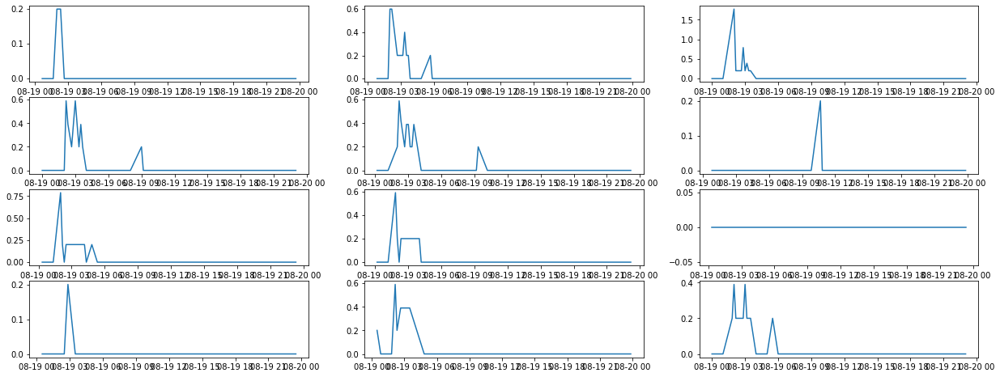

In [1296]:
fig, ax = plt.subplots(4,3, figsize=(21,8))



x=[]
y=[]

for estacao in estacoes:
    y.append(rs[rs['nomeEstacao']==estacao]['2020-08-19']['valorMedida'])
    x.append(rs[rs['nomeEstacao']==estacao]['2020-08-19'].index)
    

ax[0][0].plot(x[0],y[0])
ax[0][1].plot(x[1],y[1])
ax[0][2].plot(x[2],y[2])
ax[1][0].plot(x[3],y[3])
ax[1][1].plot(x[4],y[4])
ax[1][2].plot(x[5],y[5])
ax[2][0].plot(x[6],y[6])
ax[2][1].plot(x[7],y[7])
ax[2][2].plot(x[8],y[8])
ax[3][0].plot(x[9],y[9])
ax[3][1].plot(x[10],y[10])
ax[3][2].plot(x[11],y[11])




In [1298]:
textos = []
horario = []
for tweet in chuvas:
    textos.append(tweet.full_text)
    horario.append(tweet.created_at - timedelta(hours=3))
textos[0]

'Dia nublado pós chuva &gt;&gt;&gt;&gt;&gt; https://t.co/ddCV9lgGqO'

In [1299]:
for ind, texto in enumerate(textos):
    print(ind, '--', texto)
    print('\n')
    print(horario[ind])
    print('--------------------\n')
    

0 -- Dia nublado pós chuva &gt;&gt;&gt;&gt;&gt; https://t.co/ddCV9lgGqO


2020-08-19 20:27:45
--------------------

1 -- Mas eu sinto que eu 'to viva
A cada banho de chuva que chega molhando meu corpo nu


2020-08-19 20:27:07
--------------------

2 -- RT @amarelito: não vou ficar pra chuva n

abs https://t.co/OkN6L8VbpN


2020-08-19 20:09:03
--------------------

3 -- RT @amarelito: não vou ficar pra chuva n

abs https://t.co/OkN6L8VbpN


2020-08-19 19:28:23
--------------------

4 -- RT @amarelito: não vou ficar pra chuva n

abs https://t.co/OkN6L8VbpN


2020-08-19 19:27:26
--------------------

5 -- @Kerberosgmg @ClaroBrasil Ontem caiu o mundo de chuva em Porto Alegre e o serviço continuou. Hoje, que tava ensolarado, estava sem internet e agora fica mais caindo do que voltando. 

Só quero dar minha aulinha remota Brasil 🥺


2020-08-19 19:22:51
--------------------

6 -- Minha fotinho pós natação rendeu hein chuva de reply


2020-08-19 19:14:31
--------------------

7 -- RT @c_isabel

In [1300]:
rs_tweets = [0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
             0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
             0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
             0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
             0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
             0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
             0, 0, 0, 0, 0, 0, 0, 0, 1, 0,
             1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 
             0, 1, 1, 0, 0, 0, 0]

In [1301]:
dic_rs = {'horario':[tweet.created_at - timedelta(hours=3) for tweet in chuvas],
       'local':[tweet.user.location for tweet in chuvas],
       'texto': [tweet.full_text for tweet in chuvas],
       'relevancia':rs_tweets} 

In [1302]:
rs_df = pd.DataFrame(dic_rs)

In [1303]:
rs_df

,horario,local,texto,relevancia
0,2020-08-19 20:27:45,Porto Alegre,Dia nublado pós chuva &gt;&gt;&gt;&gt;&gt; htt...,0
1,2020-08-19 20:27:07,"Porto Alegre, Brasil",Mas eu sinto que eu 'to viva\nA cada banho de ...,0
2,2020-08-19 20:09:03,"Santo André, Brasil",RT @amarelito: não vou ficar pra chuva n\n\nab...,0
3,2020-08-19 19:28:23,Florensobrocolis,RT @amarelito: não vou ficar pra chuva n\n\nab...,0
4,2020-08-19 19:27:26,"São Paulo, Brasil",RT @amarelito: não vou ficar pra chuva n\n\nab...,0
...,...,...,...,...
82,2020-08-19 10:17:48,Porto Alegre,"Pobre nao tem paz um min, quando acho que vai ...",1
83,2020-08-19 10:11:17,"Viamão, RS",Descobri um vídeo de 12h de barulho de chuva e...,0
84,2020-08-19 10:06:43,"Porto Alegre, Brasil",Aqui a frente fria e também o ar polar que che...,0
85,2020-08-19 09:56:14,Porto Alegre - RS🔥,"E se a tempestade não passar, aprenda a dançar...",0


In [1304]:
pickle.dump(chuvas, open('chuvas_rs_19-08.p', 'wb'))

In [1305]:
rs_df.to_csv("chuvas_rs_19-08.csv")

#### __Rio de Janeiro__

In [2]:
rj = pd.read_csv('dados/RJ.csv', sep=';', decimal=',',parse_dates=[6],infer_datetime_format = True,index_col=False)

In [3]:
rj.head()

,municipio,codEstacao,uf,nomeEstacao,latitude,longitude,datahora,valorMedida
0,RIO DE JANEIRO,330455703A,RJ,Abolição,-43.297753,-22.885906,2020-08-01 00:10:00,0.0
1,RIO DE JANEIRO,330455703A,RJ,Abolição,-43.297753,-22.885906,2020-08-01 01:10:00,0.0
2,RIO DE JANEIRO,330455703A,RJ,Abolição,-43.297753,-22.885906,2020-08-01 02:10:00,0.0
3,RIO DE JANEIRO,330455703A,RJ,Abolição,-43.297753,-22.885906,2020-08-01 03:10:00,0.0
4,RIO DE JANEIRO,330455703A,RJ,Abolição,-43.297753,-22.885906,2020-08-01 04:10:00,0.0


In [4]:
rj.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11021 entries, 0 to 11020
Data columns (total 8 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   municipio    11021 non-null  object        
 1   codEstacao   11021 non-null  object        
 2   uf           11021 non-null  object        
 3   nomeEstacao  11021 non-null  object        
 4   latitude     11021 non-null  float64       
 5   longitude    11021 non-null  float64       
 6   datahora     11021 non-null  datetime64[ns]
 7   valorMedida  11021 non-null  float64       
dtypes: datetime64[ns](1), float64(3), object(4)
memory usage: 688.9+ KB


In [5]:
rj.set_index('datahora', inplace=True)
rj.head()

,municipio,codEstacao,uf,nomeEstacao,latitude,longitude,valorMedida
datahora,,,,,,,
2020-08-01 00:10:00,RIO DE JANEIRO,330455703A,RJ,Abolição,-43.297753,-22.885906,0.0
2020-08-01 01:10:00,RIO DE JANEIRO,330455703A,RJ,Abolição,-43.297753,-22.885906,0.0
2020-08-01 02:10:00,RIO DE JANEIRO,330455703A,RJ,Abolição,-43.297753,-22.885906,0.0
2020-08-01 03:10:00,RIO DE JANEIRO,330455703A,RJ,Abolição,-43.297753,-22.885906,0.0
2020-08-01 04:10:00,RIO DE JANEIRO,330455703A,RJ,Abolição,-43.297753,-22.885906,0.0


In [6]:
rj.groupby('nomeEstacao')['latitude'].unique()

nomeEstacao
Abolição                                 [-43.297753]
Alto da Boa Vista                          [-43.2965]
Andaraí                                      [-43.25]
CIEP Dr. João Ramos de Souza                [-43.203]
CIEP Samuel Wainer                          [-43.227]
Guadalupe                                   [-43.372]
Higienópolis                                [-43.265]
Ilha de Paquetá                            [-43.1084]
Jacarepaguá                                 [-43.367]
Padre Miguel                               [-43.4507]
Pavuna                                     [-43.3584]
Pilares                                     [-43.299]
Santa Cruz                                 [-43.7175]
São Conrado                                 [-43.269]
Usina                                       [-43.258]
Vargem Pequena                              [-43.433]
Vicente de Carvalho             [-43.307559999999995]
Vigário Geral                              [-43.3101]
Name: latitude, 

In [7]:
rj.groupby('nomeEstacao')['longitude'].unique()

nomeEstacao
Abolição                                 [-22.885906]
Alto da Boa Vista                          [-22.9666]
Andaraí                                      [-22.93]
CIEP Dr. João Ramos de Souza                [-22.796]
CIEP Samuel Wainer                          [-22.921]
Guadalupe                       [-22.848000000000003]
Higienópolis                                [-22.869]
Ilha de Paquetá                            [-22.7613]
Jacarepaguá                                [-22.9922]
Padre Miguel                               [-22.8689]
Pavuna                                     [-22.8076]
Pilares                                     [-22.875]
Santa Cruz                                 [-22.8897]
São Conrado                                 [-22.995]
Usina                                       [-22.948]
Vargem Pequena                              [-22.989]
Vicente de Carvalho                       [-22.86086]
Vigário Geral                              [-22.8131]
Name: longitude,

In [8]:
lat = rj.groupby('nomeEstacao')['latitude'].unique().astype(float)
lon = rj.groupby('nomeEstacao')['longitude'].unique().astype(float)

In [9]:
lat

nomeEstacao
Abolição                       -43.297753
Alto da Boa Vista              -43.296500
Andaraí                        -43.250000
CIEP Dr. João Ramos de Souza   -43.203000
CIEP Samuel Wainer             -43.227000
Guadalupe                      -43.372000
Higienópolis                   -43.265000
Ilha de Paquetá                -43.108400
Jacarepaguá                    -43.367000
Padre Miguel                   -43.450700
Pavuna                         -43.358400
Pilares                        -43.299000
Santa Cruz                     -43.717500
São Conrado                    -43.269000
Usina                          -43.258000
Vargem Pequena                 -43.433000
Vicente de Carvalho            -43.307560
Vigário Geral                  -43.310100
Name: latitude, dtype: float64

In [10]:
lon

nomeEstacao
Abolição                       -22.885906
Alto da Boa Vista              -22.966600
Andaraí                        -22.930000
CIEP Dr. João Ramos de Souza   -22.796000
CIEP Samuel Wainer             -22.921000
Guadalupe                      -22.848000
Higienópolis                   -22.869000
Ilha de Paquetá                -22.761300
Jacarepaguá                    -22.992200
Padre Miguel                   -22.868900
Pavuna                         -22.807600
Pilares                        -22.875000
Santa Cruz                     -22.889700
São Conrado                    -22.995000
Usina                          -22.948000
Vargem Pequena                 -22.989000
Vicente de Carvalho            -22.860860
Vigário Geral                  -22.813100
Name: longitude, dtype: float64

In [11]:
coordenadasRJ= pd.DataFrame([lat, lon]).T

In [12]:
coordenadasRJ

,latitude,longitude
nomeEstacao,,
Abolição,-43.297753,-22.885906
Alto da Boa Vista,-43.296500,-22.966600
Andaraí,-43.250000,-22.930000
CIEP Dr. João Ramos de Souza,-43.203000,-22.796000
CIEP Samuel Wainer,-43.227000,-22.921000
Guadalupe,-43.372000,-22.848000
Higienópolis,-43.265000,-22.869000
Ilha de Paquetá,-43.108400,-22.761300
Jacarepaguá,-43.367000,-22.992200


In [57]:
estacoes = rj['nomeEstacao'].unique()
len(estacoes)

18

In [16]:
RioDeJaneiro = 'dados/geojson/RJ.json'
latitudeRJ = -22.9035
longitudeRJ =  -43.2096 
raio = 20


centro = [latitudeRJ,longitudeRJ]
mapa = folium.Map(
    location = centro,
    zoom_start=11
)

folium.GeoJson(
    RioDeJaneiro,
    name='geojson'
).add_to(mapa)


folium.Circle(
    radius=raio*1000,
    location=centro,
    popup='Centro',
    color='crimson',
    fill=False,
).add_to(mapa)

for index, row in coordenadasRJ.iterrows():
    folium.Marker(
        location=[row['longitude'], row['latitude']],
        popup=index,
    ).add_to(mapa)


mapa

In [18]:
geocodeStr = '{},{},{}km'.format(latitudeRJ, longitudeRJ, raio)
geocodeStr

'-22.9035,-43.2096,20km'

In [26]:
chuvas = api.search(q = 'chuva OR enchente OR chuvendo OR chove OR chuvas',
                    geocode = geocodeStr, 
                    count = 101,
                    tweet_mode = 'extended',
                    until = '2020-08-23')

In [27]:
len(chuvas)

100

In [28]:
[print(tweet.full_text) for tweet in chuvas]

eu quero a chuva que me prometeram
RT @guilhermesousa: Queria aqui agradecer ao jovem twitteiro por abrir meus olhos. Eu jurava que o problema do planeta era a chuva, estou c…
RT @niquefds: Graças a Deus o tempo melhora amanhã 🙏🏽 nós que temos lar, comida e cobertor seco vivemos reclamando, eu fico pensando nos mo…
Chuva chata do crlho 🤦‍♂️
RT @djxande_: Pandemia + chuva = quem não tem uma costela pra se aquecer, chora 😅😂
RT @meninaaaa90: Chuva desnecessária, frio desnecessário, mês desnecessário...😖
Trabalhei igual fdp na chuva hoje, um frio do crl
RT @crf_isaac3: Chuva quebrou todos os planos ✊🏽😔
RT @meninodohomem5: Odeio chuva,só fico dentro de casa e não gosto de ficar em casa 🤦🏼‍♂️🤬
RT @BrenoLEsquerdo: Tá parecendo Dark só chove
RT @SenhorJuninho: 3$ reais de taxa, é caro né querido cliente? Mal sabe o que nós motoboy passamos, enfrentamos chuvas, roubos, etc.. só p…
RT @rmotta2: Tive que sair nessa chuva pra resolver um assunto.
Parei no sinal em frente a um bar.
LO-TA-DO.
Nunca 

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

In [29]:
[print(tweet.created_at) for tweet in chuvas]

2020-08-22 23:59:10
2020-08-22 23:58:52
2020-08-22 23:58:41
2020-08-22 23:58:10
2020-08-22 23:57:37
2020-08-22 23:57:34
2020-08-22 23:57:33
2020-08-22 23:57:16
2020-08-22 23:57:04
2020-08-22 23:56:54
2020-08-22 23:56:30
2020-08-22 23:56:16
2020-08-22 23:56:16
2020-08-22 23:55:58
2020-08-22 23:55:48
2020-08-22 23:55:41
2020-08-22 23:55:33
2020-08-22 23:55:23
2020-08-22 23:55:20
2020-08-22 23:55:09
2020-08-22 23:54:46
2020-08-22 23:54:45
2020-08-22 23:54:19
2020-08-22 23:54:10
2020-08-22 23:54:07
2020-08-22 23:53:58
2020-08-22 23:53:52
2020-08-22 23:53:46
2020-08-22 23:53:15
2020-08-22 23:53:10
2020-08-22 23:53:00
2020-08-22 23:52:57
2020-08-22 23:52:49
2020-08-22 23:52:44
2020-08-22 23:52:24
2020-08-22 23:51:59
2020-08-22 23:51:58
2020-08-22 23:51:57
2020-08-22 23:51:56
2020-08-22 23:51:51
2020-08-22 23:51:30
2020-08-22 23:51:07
2020-08-22 23:51:04
2020-08-22 23:50:58
2020-08-22 23:50:54
2020-08-22 23:50:52
2020-08-22 23:50:34
2020-08-22 23:50:30
2020-08-22 23:50:13
2020-08-22 23:49:59


[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

In [31]:
rj['2020-08-22'].groupby('nomeEstacao').resample('D').max()['valorMedida']

nomeEstacao                   datahora  
Abolição                      2020-08-22    1.37
Alto da Boa Vista             2020-08-22    3.20
Andaraí                       2020-08-22    2.80
CIEP Dr. João Ramos de Souza  2020-08-22    3.60
CIEP Samuel Wainer            2020-08-22    0.80
Guadalupe                     2020-08-22    1.20
Higienópolis                  2020-08-22    2.00
Ilha de Paquetá               2020-08-22    3.20
Jacarepaguá                   2020-08-22    3.00
Padre Miguel                  2020-08-22    2.80
Pilares                       2020-08-22    1.20
Santa Cruz                    2020-08-22    5.80
São Conrado                   2020-08-22    5.80
Usina                         2020-08-22    5.60
Vargem Pequena                2020-08-22    3.00
Vicente de Carvalho           2020-08-22    1.40
Vigário Geral                 2020-08-22    1.20
Name: valorMedida, dtype: float64

In [58]:
#estacoes = ['nomeEstacao'].unique()
d = np.where((estacoes=='Vargem Pequena') | (estacoes=='Padre Miguel') |(estacoes =='São Miguel')|(estacoes =='Pavuna'))
estacoes[d]

array(['Padre Miguel', 'Vargem Pequena', 'Pavuna'], dtype=object)

In [59]:
estacoes = np.delete(estacoes, d)
estacoes

array(['Abolição', 'Santa Cruz', 'Andaraí', 'CIEP Samuel Wainer',
       'Jacarepaguá', 'CIEP Dr. João Ramos de Souza', 'São Conrado',
       'Guadalupe', 'Vigário Geral', 'Vicente de Carvalho',
       'Alto da Boa Vista', 'Usina', 'Higienópolis', 'Pilares',
       'Ilha de Paquetá'], dtype=object)

In [60]:
len(estacoes)

15

In [61]:
estacoes[8]

'Vigário Geral'

In [62]:
rj[rj['nomeEstacao']==estacoes[8]]['2020-08-22']['valorMedida']

datahora
2020-08-22 00:10:00    0.4
2020-08-22 00:20:00    1.2
2020-08-22 00:30:00    0.8
2020-08-22 00:40:00    0.2
2020-08-22 01:00:00    0.2
                      ... 
2020-08-22 19:50:00    0.0
2020-08-22 20:50:00    0.0
2020-08-22 21:50:00    0.0
2020-08-22 22:50:00    0.0
2020-08-22 23:50:00    0.0
Name: valorMedida, Length: 76, dtype: float64

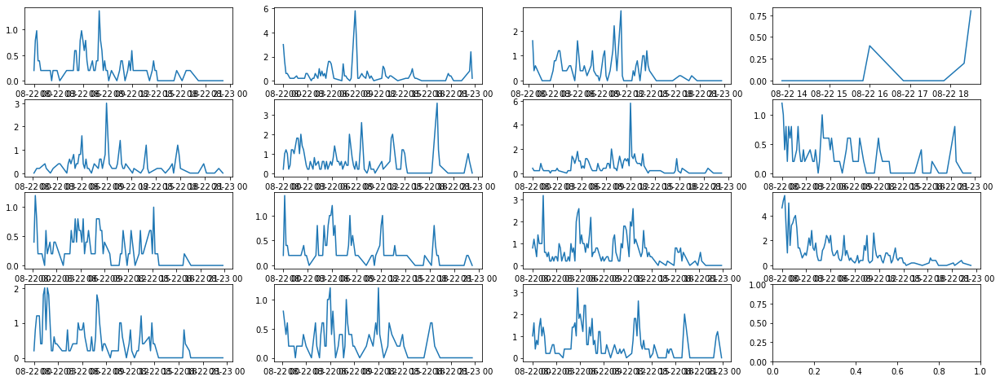

In [63]:
fig, ax = plt.subplots(4,4, figsize=(21,8))



x=[]
y=[]

for estacao in estacoes:
    y.append(rj[rj['nomeEstacao']==estacao]['2020-08-22']['valorMedida'])
    x.append(rj[rj['nomeEstacao']==estacao]['2020-08-22'].index)
    

ax[0][0].plot(x[0],y[0])
ax[0][1].plot(x[1],y[1])
ax[0][2].plot(x[2],y[2])
ax[0][3].plot(x[3],y[3])
ax[1][0].plot(x[4],y[4])
ax[1][1].plot(x[5],y[5])
ax[1][2].plot(x[6],y[6])
ax[1][3].plot(x[7],y[7])
ax[2][0].plot(x[8],y[8])
ax[2][1].plot(x[9],y[9])
ax[2][2].plot(x[10],y[10])
ax[2][3].plot(x[11],y[11])
ax[3][0].plot(x[12],y[12])
ax[3][1].plot(x[13],y[13])
ax[3][2].plot(x[14],y[14])
#ax[3][3].plot(x[15],y[15])



In [65]:
textos = []
horario = []
for tweet in chuvas:
    textos.append(tweet.full_text)
    horario.append(tweet.created_at - timedelta(hours=3))
textos[5]

'RT @meninaaaa90: Chuva desnecessária, frio desnecessário, mês desnecessário...😖'

In [66]:
for ind, texto in enumerate(textos):
    print(ind, '--', texto)
    print('\n')
    print(horario[ind])
    print('--------------------\n')
    

0 -- eu quero a chuva que me prometeram


2020-08-22 20:59:10
--------------------

1 -- RT @guilhermesousa: Queria aqui agradecer ao jovem twitteiro por abrir meus olhos. Eu jurava que o problema do planeta era a chuva, estou c…


2020-08-22 20:58:52
--------------------

2 -- RT @niquefds: Graças a Deus o tempo melhora amanhã 🙏🏽 nós que temos lar, comida e cobertor seco vivemos reclamando, eu fico pensando nos mo…


2020-08-22 20:58:41
--------------------

3 -- Chuva chata do crlho 🤦‍♂️


2020-08-22 20:58:10
--------------------

4 -- RT @djxande_: Pandemia + chuva = quem não tem uma costela pra se aquecer, chora 😅😂


2020-08-22 20:57:37
--------------------

5 -- RT @meninaaaa90: Chuva desnecessária, frio desnecessário, mês desnecessário...😖


2020-08-22 20:57:34
--------------------

6 -- Trabalhei igual fdp na chuva hoje, um frio do crl


2020-08-22 20:57:33
--------------------

7 -- RT @crf_isaac3: Chuva quebrou todos os planos ✊🏽😔


2020-08-22 20:57:16
--------------------

8 

In [67]:
rj_tweets = [0, 0, 0, 1, 0, 1, 0, 1, 0, 1,
             0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
             1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 
             0, 0, 0, 0, 0, 0, 0, 0, 1, 0,
             1, 0, 0, 0, 0, 0, 0, 1, 1, 0,
             0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 
             0, 0, 0, 0, 1, 1, 0, 0, 0, 0,
             0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 
             0, 0, 0, 0, 0, 0, 0, 1, 0, 0,
             1, 0, 0, 0, 0, 0, 0, 0, 0, 0]

In [68]:
dic_rj = {'horario':[tweet.created_at - timedelta(hours=3) for tweet in chuvas],
       'local':[tweet.user.location for tweet in chuvas],
       'texto': [tweet.full_text for tweet in chuvas],
       'relevancia':rj_tweets} 

In [69]:
rj_df = pd.DataFrame(dic_rj)

In [70]:
rj_df

,horario,local,texto,relevancia
0,2020-08-22 20:59:10,"Rio de Janeiro, Brasil",eu quero a chuva que me prometeram,0
1,2020-08-22 20:58:52,"Cuiabá, Brasil",RT @guilhermesousa: Queria aqui agradecer ao j...,0
2,2020-08-22 20:58:41,,RT @niquefds: Graças a Deus o tempo melhora am...,0
3,2020-08-22 20:58:10,Rio de Janeiro,Chuva chata do crlho 🤦‍♂️,1
4,2020-08-22 20:57:37,"Rio de Janeiro, Brasil",RT @djxande_: Pandemia + chuva = quem não tem ...,0
...,...,...,...,...
95,2020-08-22 20:40:44,,"RT @mariozinholago: Em meio à pandemia, ao fri...",0
96,2020-08-22 20:40:42,🇭🇷,RT @jeansilva_22: 5 reais de taxa é caro ne s...,0
97,2020-08-22 20:40:41,,RT @bal_rayane: Queria estar numa pousada na s...,0
98,2020-08-22 20:40:40,022,RT @TrechoPagode: Olha a chuva caindo lá fora ...,0


In [71]:
pickle.dump(chuvas, open('chuvas_rj_22-08.p', 'wb'))

In [72]:
rj_df.to_csv("chuvas_rj_22-08.csv")

#### __São Paulo__

In [74]:
sp = pd.read_csv('dados/SP.csv', sep=';', decimal=',',parse_dates=[6],infer_datetime_format = True,index_col=False)

In [75]:
sp.head()

,municipio,codEstacao,uf,nomeEstacao,latitude,longitude,datahora,valorMedida
0,SÃO PAULO,355030801B,SP,José Bonifácio,-46.439,-23.547,2020-08-01 00:20:00,0.0
1,SÃO PAULO,355030801B,SP,José Bonifácio,-46.439,-23.547,2020-08-01 01:20:00,0.0
2,SÃO PAULO,355030801B,SP,José Bonifácio,-46.439,-23.547,2020-08-01 02:20:00,0.0
3,SÃO PAULO,355030801B,SP,José Bonifácio,-46.439,-23.547,2020-08-01 03:20:00,0.0
4,SÃO PAULO,355030801B,SP,José Bonifácio,-46.439,-23.547,2020-08-01 04:20:00,0.0


In [76]:
sp.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41119 entries, 0 to 41118
Data columns (total 8 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   municipio    41119 non-null  object        
 1   codEstacao   41119 non-null  object        
 2   uf           41119 non-null  object        
 3   nomeEstacao  41119 non-null  object        
 4   latitude     41119 non-null  float64       
 5   longitude    41119 non-null  float64       
 6   datahora     41119 non-null  datetime64[ns]
 7   valorMedida  41119 non-null  float64       
dtypes: datetime64[ns](1), float64(3), object(4)
memory usage: 2.5+ MB


In [77]:
sp.set_index('datahora', inplace=True)
sp.head()

,municipio,codEstacao,uf,nomeEstacao,latitude,longitude,valorMedida
datahora,,,,,,,
2020-08-01 00:20:00,SÃO PAULO,355030801B,SP,José Bonifácio,-46.439,-23.547,0.0
2020-08-01 01:20:00,SÃO PAULO,355030801B,SP,José Bonifácio,-46.439,-23.547,0.0
2020-08-01 02:20:00,SÃO PAULO,355030801B,SP,José Bonifácio,-46.439,-23.547,0.0
2020-08-01 03:20:00,SÃO PAULO,355030801B,SP,José Bonifácio,-46.439,-23.547,0.0
2020-08-01 04:20:00,SÃO PAULO,355030801B,SP,José Bonifácio,-46.439,-23.547,0.0


In [78]:
sp.groupby('nomeEstacao')['latitude'].unique()

nomeEstacao
AC Almeida Lima              [-46.608613]
AC Central de SP             [-46.635987]
Avenida Oratório                [-46.523]
Avenida Tucuruvi                [-46.604]
Barro Branco                     [-46.68]
                            ...          
Vila Constância                 [-46.674]
Vila Leopoldina               [-46.73533]
Vila Prudente        [-46.56100000000001]
Vila Rubi           [-46.696999999999996]
Vila das Belezas                [-46.744]
Name: latitude, Length: 68, dtype: object

In [79]:
sp.groupby('nomeEstacao')['longitude'].unique()

nomeEstacao
AC Almeida Lima               [-23.55196]
AC Central de SP             [-23.543311]
Avenida Oratório    [-23.613000000000003]
Avenida Tucuruvi    [-23.480999999999998]
Barro Branco                    [-23.767]
                            ...          
Vila Constância     [-23.668000000000003]
Vila Leopoldina                [-23.5351]
Vila Prudente                   [-23.584]
Vila Rubi                       [-23.728]
Vila das Belezas                [-23.647]
Name: longitude, Length: 68, dtype: object

In [80]:
lat = sp.groupby('nomeEstacao')['latitude'].unique().astype(float)
lon = sp.groupby('nomeEstacao')['longitude'].unique().astype(float)

ValueError: setting an array element with a sequence.

In [9]:
lat

nomeEstacao
Abolição                       -43.297753
Alto da Boa Vista              -43.296500
Andaraí                        -43.250000
CIEP Dr. João Ramos de Souza   -43.203000
CIEP Samuel Wainer             -43.227000
Guadalupe                      -43.372000
Higienópolis                   -43.265000
Ilha de Paquetá                -43.108400
Jacarepaguá                    -43.367000
Padre Miguel                   -43.450700
Pavuna                         -43.358400
Pilares                        -43.299000
Santa Cruz                     -43.717500
São Conrado                    -43.269000
Usina                          -43.258000
Vargem Pequena                 -43.433000
Vicente de Carvalho            -43.307560
Vigário Geral                  -43.310100
Name: latitude, dtype: float64

In [10]:
lon

nomeEstacao
Abolição                       -22.885906
Alto da Boa Vista              -22.966600
Andaraí                        -22.930000
CIEP Dr. João Ramos de Souza   -22.796000
CIEP Samuel Wainer             -22.921000
Guadalupe                      -22.848000
Higienópolis                   -22.869000
Ilha de Paquetá                -22.761300
Jacarepaguá                    -22.992200
Padre Miguel                   -22.868900
Pavuna                         -22.807600
Pilares                        -22.875000
Santa Cruz                     -22.889700
São Conrado                    -22.995000
Usina                          -22.948000
Vargem Pequena                 -22.989000
Vicente de Carvalho            -22.860860
Vigário Geral                  -22.813100
Name: longitude, dtype: float64

In [11]:
coordenadasRJ= pd.DataFrame([lat, lon]).T

In [12]:
coordenadasRJ

,latitude,longitude
nomeEstacao,,
Abolição,-43.297753,-22.885906
Alto da Boa Vista,-43.296500,-22.966600
Andaraí,-43.250000,-22.930000
CIEP Dr. João Ramos de Souza,-43.203000,-22.796000
CIEP Samuel Wainer,-43.227000,-22.921000
Guadalupe,-43.372000,-22.848000
Higienópolis,-43.265000,-22.869000
Ilha de Paquetá,-43.108400,-22.761300
Jacarepaguá,-43.367000,-22.992200


In [57]:
estacoes = rj['nomeEstacao'].unique()
len(estacoes)

18

In [16]:
RioDeJaneiro = 'dados/geojson/RJ.json'
latitudeRJ = -22.9035
longitudeRJ =  -43.2096 
raio = 20


centro = [latitudeRJ,longitudeRJ]
mapa = folium.Map(
    location = centro,
    zoom_start=11
)

folium.GeoJson(
    RioDeJaneiro,
    name='geojson'
).add_to(mapa)


folium.Circle(
    radius=raio*1000,
    location=centro,
    popup='Centro',
    color='crimson',
    fill=False,
).add_to(mapa)

for index, row in coordenadasRJ.iterrows():
    folium.Marker(
        location=[row['longitude'], row['latitude']],
        popup=index,
    ).add_to(mapa)


mapa

In [82]:
latitudeSP = -23.5489
longitudeSP = -46.6388

geocodeStr = '{},{},{}km'.format(latitudeSP, longitudeSP, raio)
geocodeStr

'-23.5489,-46.6388,20km'

In [92]:
chuvas = api.search(q = 'chuva OR enchente OR chuvendo OR chove OR chuvas',
                    geocode = geocodeStr, 
                    count = 101,
                    tweet_mode = 'extended',
                    until = '2020-08-22')

In [93]:
len(chuvas)

100

In [94]:
[print(tweet.full_text) for tweet in chuvas]

RT @tricovotweets: Ontem, às 20h00, Paulinho Boia não foi relacionado para o jogo pois estava "gripado". Hoje pela manhã, treinou normalmen…
RT @barbaradzz: do que adianta essa friaca e essa chuva se vc não ta aqui pra dormir de conchinha cmg??????????
RT @rebs_rebeca: Esse tempo frio com chuva me lembra muito a Etec
@AmandaAlvesB_ Melhor pegar ônibus na chuva e frio que com um monte de fedido 😳
@goulart_lenita Aqui, litoral sul de sp, 9 graus com sensação de 6 e muita chuva.
RT @DouglasGarcia: 2) Se a luta contra o sistema é vencer pelo cansaço, então preparem-se para a chuva de requerimentos na ALESP e petições…
O melhor barulho do mundo é a chuva caindo...
Quando a gente lê um livro com o som da chuva... 
Ler... é sonhar pela mão de outrem...
Livros... são sonhos que seguramos com as mãos...
Amantes de livros... nunca vão para cama sozinhos... https://t.co/4GExTHFuIZ
RT @DouglasGarcia: 2) Se a luta contra o sistema é vencer pelo cansaço, então preparem-se para a chuva de requeriment

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

In [95]:
[print(tweet.created_at) for tweet in chuvas]

2020-08-21 23:59:35
2020-08-21 23:58:21
2020-08-21 23:57:31
2020-08-21 23:56:02
2020-08-21 23:53:43
2020-08-21 23:51:10
2020-08-21 23:50:53
2020-08-21 23:50:40
2020-08-21 23:50:30
2020-08-21 23:50:25
2020-08-21 23:49:43
2020-08-21 23:49:41
2020-08-21 23:49:15
2020-08-21 23:48:42
2020-08-21 23:47:20
2020-08-21 23:47:17
2020-08-21 23:46:57
2020-08-21 23:46:19
2020-08-21 23:45:42
2020-08-21 23:45:37
2020-08-21 23:45:29
2020-08-21 23:45:15
2020-08-21 23:45:12
2020-08-21 23:42:45
2020-08-21 23:42:34
2020-08-21 23:42:04
2020-08-21 23:40:30
2020-08-21 23:39:46
2020-08-21 23:39:06
2020-08-21 23:39:06
2020-08-21 23:38:37
2020-08-21 23:38:29
2020-08-21 23:37:30
2020-08-21 23:37:10
2020-08-21 23:36:32
2020-08-21 23:36:26
2020-08-21 23:36:19
2020-08-21 23:35:12
2020-08-21 23:34:10
2020-08-21 23:34:03
2020-08-21 23:33:55
2020-08-21 23:33:42
2020-08-21 23:33:41
2020-08-21 23:33:09
2020-08-21 23:32:44
2020-08-21 23:32:26
2020-08-21 23:31:53
2020-08-21 23:31:15
2020-08-21 23:31:08
2020-08-21 23:30:50


[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

In [97]:
sp['2020-08-21'].groupby('nomeEstacao').resample('D').max()['valorMedida']

nomeEstacao                datahora  
AC Almeida Lima            2020-08-21    0.59
Avenida Tucuruvi           2020-08-21    0.00
Barro Branco               2020-08-21    0.59
Burgo Paulista             2020-08-21    1.18
Butantã                    2020-08-21    0.98
Campo Limpo                2020-08-21    0.20
Capão Redondo              2020-08-21    0.20
Capão Redondo2             2020-08-21    0.79
Centro                     2020-08-21    0.59
Chacara Dona Olivia        2020-08-21    0.39
Cidade Dutra               2020-08-21    0.20
Cidade Líder               2020-08-21    0.79
Cidade Tiradentes 2        2020-08-21    0.59
Freguesia do Ó             2020-08-21    0.79
Iguatemi                   2020-08-21    0.59
Interlagos                 2020-08-21    0.98
Ipiranga                   2020-08-21    0.20
Itaim Paulista             2020-08-21    0.20
Itaquera2                  2020-08-21    0.20
Jabaquara                  2020-08-21    0.79
Jaguaré                    2020-08-21    0

In [58]:
#estacoes = ['nomeEstacao'].unique()
#d = np.where((estacoes=='Vargem Pequena') | (estacoes=='Padre Miguel') |(estacoes =='São Miguel')|(estacoes =='Pavuna'))
#estacoes[d]

array(['Padre Miguel', 'Vargem Pequena', 'Pavuna'], dtype=object)

In [59]:
#estacoes = np.delete(estacoes, d)
#estacoes

array(['Abolição', 'Santa Cruz', 'Andaraí', 'CIEP Samuel Wainer',
       'Jacarepaguá', 'CIEP Dr. João Ramos de Souza', 'São Conrado',
       'Guadalupe', 'Vigário Geral', 'Vicente de Carvalho',
       'Alto da Boa Vista', 'Usina', 'Higienópolis', 'Pilares',
       'Ilha de Paquetá'], dtype=object)

In [60]:
#len(estacoes)

15

In [61]:
#estacoes[8]

'Vigário Geral'

In [62]:
rj[rj['nomeEstacao']==estacoes[8]]['2020-08-22']['valorMedida']

datahora
2020-08-22 00:10:00    0.4
2020-08-22 00:20:00    1.2
2020-08-22 00:30:00    0.8
2020-08-22 00:40:00    0.2
2020-08-22 01:00:00    0.2
                      ... 
2020-08-22 19:50:00    0.0
2020-08-22 20:50:00    0.0
2020-08-22 21:50:00    0.0
2020-08-22 22:50:00    0.0
2020-08-22 23:50:00    0.0
Name: valorMedida, Length: 76, dtype: float64

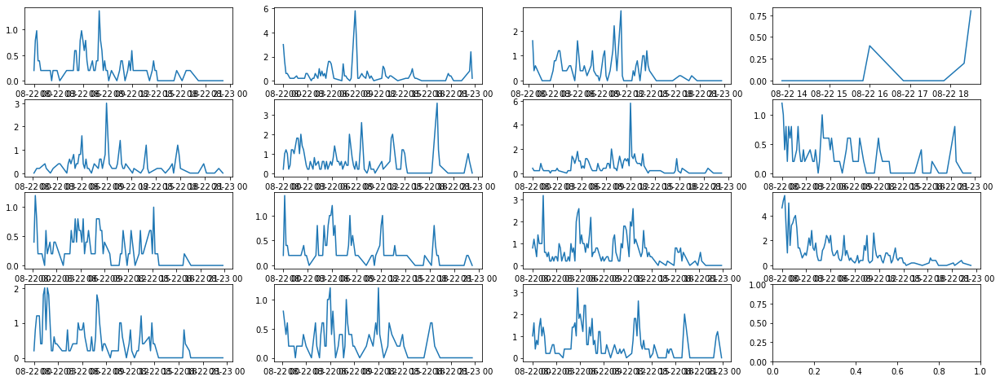

In [63]:
fig, ax = plt.subplots(4,4, figsize=(21,8))



x=[]
y=[]

for estacao in estacoes:
    y.append(rj[rj['nomeEstacao']==estacao]['2020-08-22']['valorMedida'])
    x.append(rj[rj['nomeEstacao']==estacao]['2020-08-22'].index)
    

ax[0][0].plot(x[0],y[0])
ax[0][1].plot(x[1],y[1])
ax[0][2].plot(x[2],y[2])
ax[0][3].plot(x[3],y[3])
ax[1][0].plot(x[4],y[4])
ax[1][1].plot(x[5],y[5])
ax[1][2].plot(x[6],y[6])
ax[1][3].plot(x[7],y[7])
ax[2][0].plot(x[8],y[8])
ax[2][1].plot(x[9],y[9])
ax[2][2].plot(x[10],y[10])
ax[2][3].plot(x[11],y[11])
ax[3][0].plot(x[12],y[12])
ax[3][1].plot(x[13],y[13])
ax[3][2].plot(x[14],y[14])
#ax[3][3].plot(x[15],y[15])



In [98]:
textos = []
horario = []
for tweet in chuvas:
    textos.append(tweet.full_text)
    horario.append(tweet.created_at - timedelta(hours=3))
textos[5]

'RT @DouglasGarcia: 2) Se a luta contra o sistema é vencer pelo cansaço, então preparem-se para a chuva de requerimentos na ALESP e petições…'

In [99]:
for ind, texto in enumerate(textos):
    print(ind, '--', texto)
    print('\n')
    print(horario[ind])
    print('--------------------\n')
    

0 -- RT @tricovotweets: Ontem, às 20h00, Paulinho Boia não foi relacionado para o jogo pois estava "gripado". Hoje pela manhã, treinou normalmen…


2020-08-21 20:59:35
--------------------

1 -- RT @barbaradzz: do que adianta essa friaca e essa chuva se vc não ta aqui pra dormir de conchinha cmg??????????


2020-08-21 20:58:21
--------------------

2 -- RT @rebs_rebeca: Esse tempo frio com chuva me lembra muito a Etec


2020-08-21 20:57:31
--------------------

3 -- @AmandaAlvesB_ Melhor pegar ônibus na chuva e frio que com um monte de fedido 😳


2020-08-21 20:56:02
--------------------

4 -- @goulart_lenita Aqui, litoral sul de sp, 9 graus com sensação de 6 e muita chuva.


2020-08-21 20:53:43
--------------------

5 -- RT @DouglasGarcia: 2) Se a luta contra o sistema é vencer pelo cansaço, então preparem-se para a chuva de requerimentos na ALESP e petições…


2020-08-21 20:51:10
--------------------

6 -- O melhor barulho do mundo é a chuva caindo...
Quando a gente lê um livro com o 

In [100]:
sp_tweets = [0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 
             0, 0, 0, 1, 1, 0, 1, 0, 0, 1,
             1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 
             0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 
             0, 0, 0, 1, 1, 1, 0, 0, 0, 0,
             0, 0, 0, 0, 0, 0, 0, 1, 0, 0,
             1, 1, 1, 1, 0, 0, 0, 0, 0, 0,
             0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 
             0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 
             0, 1, 0, 0, 0, 0, 0, 0, 0, 1,]

In [102]:
dic_sp = {'horario':[tweet.created_at - timedelta(hours=3) for tweet in chuvas],
       'local':[tweet.user.location for tweet in chuvas],
       'texto': [tweet.full_text for tweet in chuvas],
       'relevancia':sp_tweets} 

In [103]:
sp_df = pd.DataFrame(dic_sp)

In [104]:
sp_df

,horario,local,texto,relevancia
0,2020-08-21 20:59:35,Brasil,"RT @tricovotweets: Ontem, às 20h00, Paulinho B...",0
1,2020-08-21 20:58:21,"São Paulo, Brasil",RT @barbaradzz: do que adianta essa friaca e e...,1
2,2020-08-21 20:57:31,,RT @rebs_rebeca: Esse tempo frio com chuva me ...,0
3,2020-08-21 20:56:02,"São Bernardo do Campo, Brasil",@AmandaAlvesB_ Melhor pegar ônibus na chuva e ...,0
4,2020-08-21 20:53:43,"São Paulo, Brasil","@goulart_lenita Aqui, litoral sul de sp, 9 gra...",1
...,...,...,...,...
95,2020-08-21 20:00:54,,RT @DouglasGarcia: 2) Se a luta contra o siste...,0
96,2020-08-21 20:00:26,,RT @DouglasGarcia: 2) Se a luta contra o siste...,0
97,2020-08-21 19:58:45,"São Paulo, Brasil",essa música me faz levantar do sofá e dançar n...,0
98,2020-08-21 19:58:27,Brasília,RT @DouglasGarcia: 2) Se a luta contra o siste...,0


In [105]:
pickle.dump(chuvas, open('chuvas_sp_21-08.p', 'wb'))

In [107]:
sp_df.to_csv("chuvas_sp_21-08.csv")